In [1]:
library(Seurat)
library(Matrix)
library(useful)
library(harmony)
library(dplyr)
library(sva)
library(RColorBrewer)
library(Scillus)
library(ggrepel)
library(stringr)
library(ggpubr)
library(fgsea)

set.seed(1234)

Attaching SeuratObject

Attaching sp

Loading required package: ggplot2

Loading required package: Rcpp


Attaching package: 'dplyr'


The following objects are masked from 'package:stats':

    filter, lag


The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union


Loading required package: mgcv

Loading required package: nlme


Attaching package: 'nlme'


The following object is masked from 'package:dplyr':

    collapse


This is mgcv 1.8-36. For overview type 'help("mgcv-package")'.

Loading required package: genefilter

Loading required package: BiocParallel



### 1. Create Seurat object for all normal and tumor samples post-Cellbender and post-Scrublet

In [2]:
dirs = list.dirs("Cellbender_out/",full.names = F,recursive = F)
dirs = dirs[1:length(dirs)]
length(dirs)
dirs

[1] 8

[1] "10_VX516_N"   "11_VX5256_T"  "12_VX5256_N"  "3_BB453_T"    "5_BB452_KR_N"
[6] "6_BB452_KL_T" "8_BB455_N"    "9_VX516_T"

In [3]:
raw = list()

for (i in 1:length(dirs)){
    input = readRDS(paste("Cellbender_Scrublet_Out/",dirs[i],"_Cellbender_Scrublet.RDS", sep = ""))
    colnames(input) = paste("Sample",dirs[i],colnames(input), sep = ".")
    raw[[i]] = input
}

names(raw) = dirs

In [4]:
start = raw[[1]]

for (i in 2:length(names(raw))){
    start = cbind(start, raw[[i]])
}

dim(start)
corner(start)

[1]  32285 154250

   [[ suppressing 34 column names 'Sample.10_VX516_N.TACGTCCCACGCGCAT-1', 'Sample.10_VX516_N.CCCTCAAAGACGCTCC-1', 'Sample.10_VX516_N.CAAAGAAAGTACAACA-1' ... ]]



5 x 154250 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm19938 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm19938 ......
Gm37381 ......
Rp1     ......

 .....suppressing 154216 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [5]:
names <- colnames(start)
x <- strsplit(names,"[.]")
Sample <- sapply(x, "[", 2)
corner(Sample)
meta <- data.frame(Sample)
row.names(meta) <- names
meta$cell_id <- row.names(meta)
corner(meta)
dim(meta)

table(meta$Sample)
length(unique(meta$Sample))

[1] "10_VX516_N" "10_VX516_N" "10_VX516_N" "10_VX516_N" "10_VX516_N"

,Sample,cell_id
,<chr>,<chr>
Sample.10_VX516_N.TACGTCCCACGCGCAT-1,10_VX516_N,Sample.10_VX516_N.TACGTCCCACGCGCAT-1
Sample.10_VX516_N.CCCTCAAAGACGCTCC-1,10_VX516_N,Sample.10_VX516_N.CCCTCAAAGACGCTCC-1
Sample.10_VX516_N.CAAAGAAAGTACAACA-1,10_VX516_N,Sample.10_VX516_N.CAAAGAAAGTACAACA-1
Sample.10_VX516_N.GTGAGGACACGTATAC-1,10_VX516_N,Sample.10_VX516_N.GTGAGGACACGTATAC-1
Sample.10_VX516_N.AACAAGATCGTGCTCT-1,10_VX516_N,Sample.10_VX516_N.AACAAGATCGTGCTCT-1


[1] 154250      2


  10_VX516_N  11_VX5256_T  12_VX5256_N    3_BB453_T 5_BB452_KR_N 6_BB452_KL_T 
       25055        14047        22669        13874        24338        12977 
   8_BB455_N    9_VX516_T 
       27400        13890 

[1] 8

In [6]:
seur <- CreateSeuratObject(start, meta.data = meta, min.cells = 3, min.features = 200)
seur[["percent.mt"]] <- PercentageFeatureSet(seur, pattern = "^mt-")
table(seur$Sample)


  10_VX516_N  11_VX5256_T  12_VX5256_N    3_BB453_T 5_BB452_KR_N 6_BB452_KL_T 
       15583        11337        17663        11894        15897        11006 
   8_BB455_N    9_VX516_T 
       21976         8655 

In [7]:
seur <- subset(seur, subset = nFeature_RNA > 200 & percent.mt < 20)
table(seur$Sample)


  10_VX516_N  11_VX5256_T  12_VX5256_N    3_BB453_T 5_BB452_KR_N 6_BB452_KL_T 
        8788        10560        10559        10064         7925         9927 
   8_BB455_N    9_VX516_T 
       12138         5825 

In [8]:
meta = seur@meta.data
meta = mutate(meta, TumorNormal = ifelse(Sample %in% c("10_VX516_N","12_VX5256_N","5_BB452_KR_N","8_BB455_N"), "Normal","Tumor"))
table(meta$TumorNormal)
row.names(meta) = row.names(seur@meta.data)
seur$TumorNormal = meta$TumorNormal

Female = c("10_VX516_N","9_VX516_T","11_VX5256_T","12_VX5256_N")
Helicobacter = c("5_BB452_KR_N","6_BB452_KL_T","8_BB455_N","3_BB453_T")

meta = seur@meta.data 
meta = mutate(meta, Sex = ifelse(Sample %in% Female, "Female","Male"))
meta = mutate(meta, Helicobacter = ifelse(Sample %in% Helicobacter, "pos","neg"))

seur$Sex = meta$Sex
seur$Helicobacter = meta$Helicobacter


Normal  Tumor 
 39410  36376 

### 2. Dimension reduction and clustering

Centering and scaling data matrix

PC_ 1 
Positive:  Tmsb4x, Laptm5, Fcer1g, Tyrobp, Ctss, Cd52, Lyz2, Srgn, Sh3bgrl3, Ctsc 
	   Mpeg1, Ly86, Csf1r, Fyb, Cybb, Alox5ap, Ms4a6c, Fcgr3, Emp3, Spi1 
	   Cd300c2, Rgs10, Unc93b1, C1qb, Pld4, B2m, Gngt2, C1qc, C1qa, H2-D1 
Negative:  Gpx3, Spink1, Ndrg1, Slc34a1, Gsta2, Dbi, Lrp2, Slc27a2, Pck1, Pdzk1ip1 
	   Slc4a4, Nat8f1, Acaa1b, Acsm2, Folr1, Igfbp7, Ggt1, Slc13a1, Cat, Timp3 
	   Fut9, Hao2, Gclm, Mfsd4b5, Abcg2, Guca2b, Acy3, Rdh16f2, Ugt3a2, Slc22a6 
PC_ 2 
Positive:  Ms4a4b, Ptprcap, Ltb, Cd3g, Trbc2, Gimap3, Nkg7, Cd3d, Cd3e, Lck 
	   Ctsw, Trac, Gimap1, Skap1, Ccl5, Hcst, Gimap4, Cd2, Gimap7, Cxcr6 
	   Thy1, Gimap6, Lat, Il2rb, Trbc1, Dusp2, AW112010, Klrd1, Cd52, Ccnd2 
Negative:  Aebp1, Ctsb, Spp1, Hspb1, Anxa3, Ctsl, Col4a1, Mfge8, Cpe, Ptgds 
	   Creg1, Adamts1, App, Rtn4, Map1b, Maoa, Sox4, Gc, Col4a2, Adm 
	   C3, Dst, Ugt2b35, Serpinb6a, Ampd3, Pklr, Psap, Col18a1, Cryab, Scd2 
PC_ 3 
Positive:  Fth1, Cd63, Prdx1, Lgmn, Gap

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 75786
Number of edges: 2741660

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9529
Number of communities: 31
Elapsed time: 46 seconds


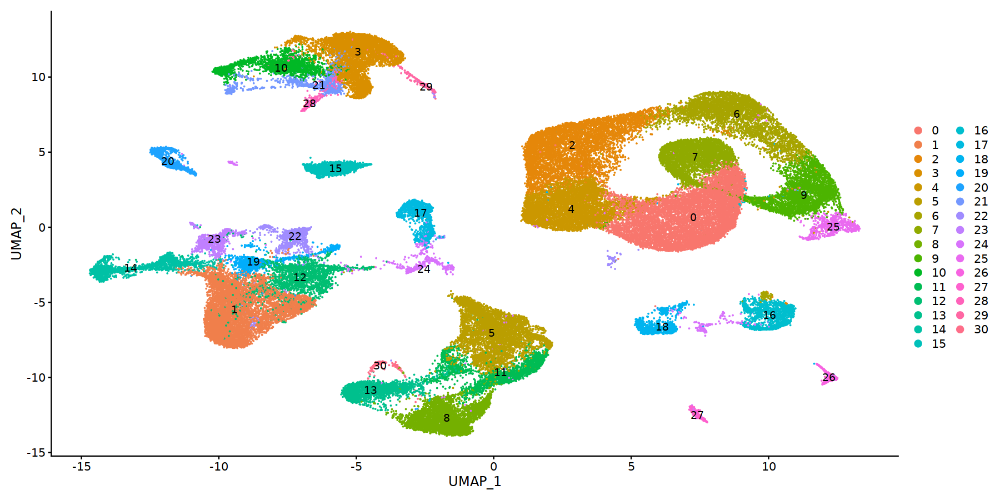

In [212]:
seur <- NormalizeData(seur)
seur <- FindVariableFeatures(seur, selection.method = "vst",nfeatures = 3000)
seur <- ScaleData(seur, features = row.names(seur))
seur <- RunPCA(seur, npcs = 30,verbose = T)
seur <- RunUMAP(seur, reduction = "pca", dims = 1:30)
seur <- FindNeighbors(seur, reduction = "pca", dims = 1:30)
seur <- FindClusters(seur, resolution = 0.5)
DimPlot(seur, label = T)

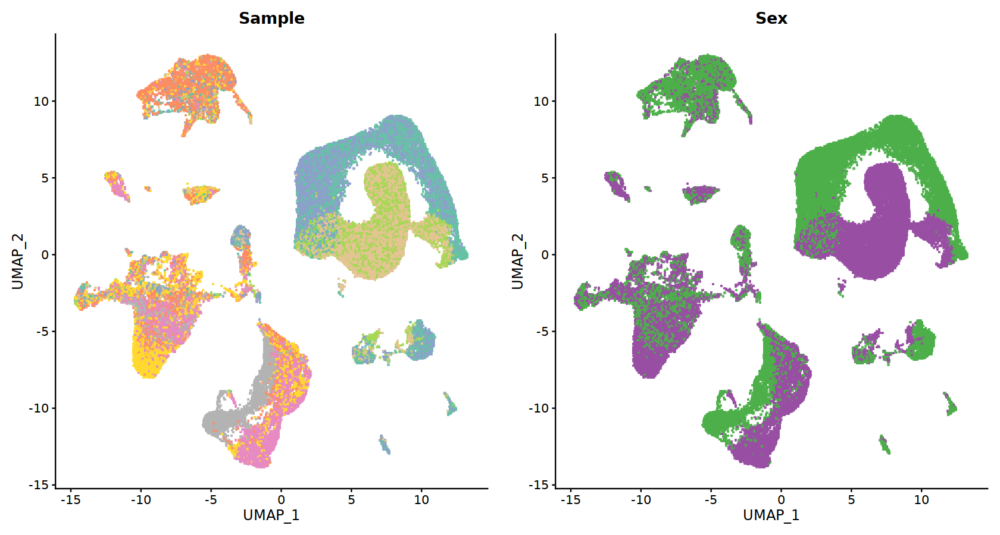

In [213]:
one = DimPlot(seur, group.by = "Sample", cols = brewer.pal(8, "Set2"),shuffle = T,raster = T) + NoLegend()
two = DimPlot(seur, group.by = "Sex",cols = c("#4daf4a","#984ea3"),shuffle = T,raster = T) + NoLegend()

options(repr.plot.width=14, repr.plot.height=7.5)
ggarrange(one, two, nrow = 1)

ggsave("Manuscript_Figures/FullObject_Sample_Sex.pdf", width = 14, height = 7.5)

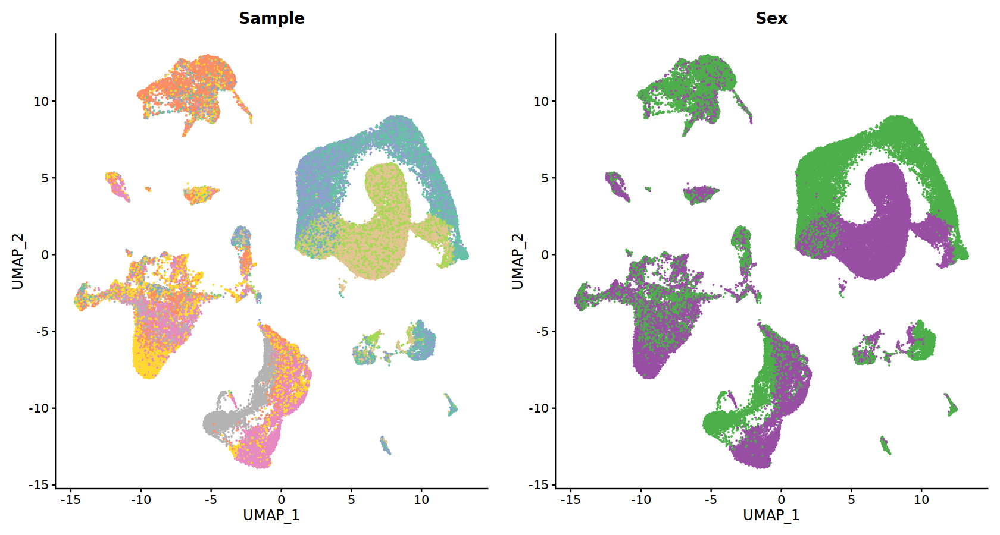

In [214]:
one = DimPlot(seur, group.by = "Sample", cols = brewer.pal(8, "Set2"),shuffle = T,raster = F) + NoLegend()
two = DimPlot(seur, group.by = "Sex",cols = c("#4daf4a","#984ea3"),shuffle = T,raster = F) + NoLegend()

options(repr.plot.width=14, repr.plot.height=7.5)
ggarrange(one, two, nrow = 1)

ggsave("Manuscript_Figures/FullObject_Sample_Sex_RasterF.pdf", width = 14, height = 7.5)

In [215]:
saveRDS(seur, file = "Manuscript_Objects/NormalKidney_CrelessTumor_SeuratObject.RDS")

### 3. Identify immune clusters with Ptprc expression

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



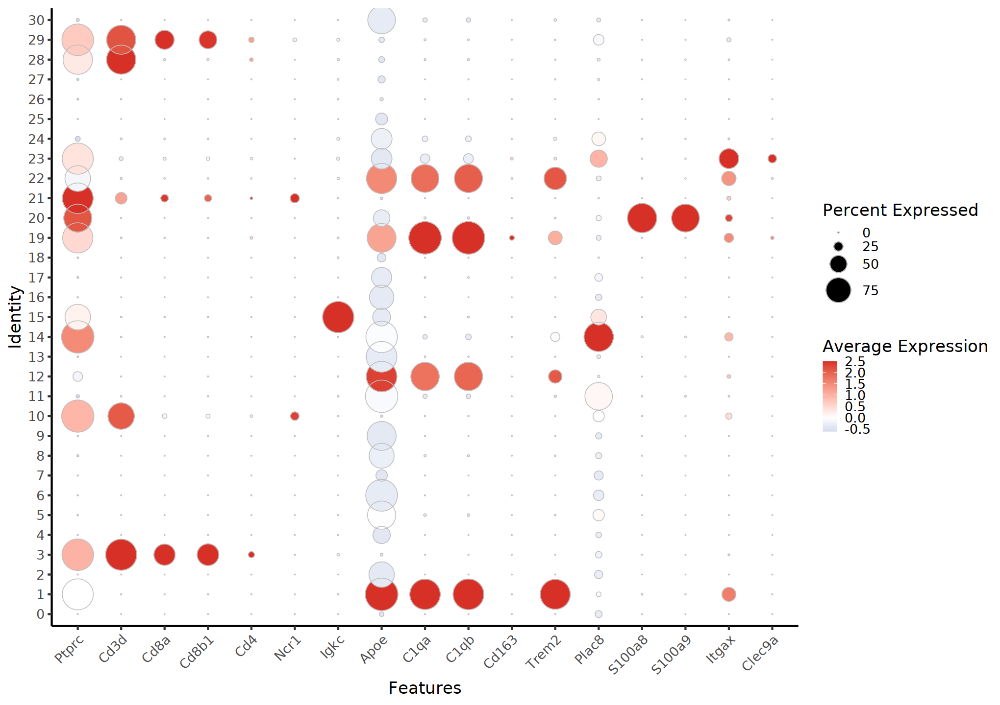

In [22]:
options(repr.plot.width=17, repr.plot.height=12)

DotPlot(seur, features = c("Ptprc","Cd3d","Cd8a","Cd8b1","Cd4","Ncr1","Igkc","Apoe","C1qa","C1qb","Cd163","Trem2","Plac8","S100a8","S100a9","Itgax","Clec9a"),assay = "RNA",dot.scale = 18, cols = c("white","red")) + theme_classic(base_size = 20) +
geom_point(aes(size = pct.exp),shape = 21, color = "grey",stroke = 0.5) + 
scale_colour_gradient2(low = "#4575b4", mid = "white", high = "#d73027") +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))

In [11]:
immune = c(1, 3, 10, 12, 14, 15,19,20,21,22,23,28,29)

### 3. Subset, reproject, and recuster non-immune cells from normal kidney samples

In [12]:
seur = readRDS(file = "Manuscript_Objects/NormalKidney_CrelessTumor_SeuratObject.RDS")

Centering and scaling data matrix

PC_ 1 
Positive:  Gpx3, Spink1, Ttc36, Chpt1, Akr1c21, Pck1, Cyb5a, Cltrn, Pecr, Slc34a1 
	   Acadm, Acaa1b, Nat8f1, Hao2, Slc27a2, Lap3, Acy3, Acsm2, Gclm, Maf 
	   Msrb1, Odc1, Slc22a12, Slc22a8, Cyp2j5, Oxct1, Nudt19, Lrp2, Guca2b, Folr1 
Negative:  Tmsb4x, Ehd4, Ifitm3, Hspb1, Plpp1, S100a6, H2-K1, Anxa2, Emcn, Flt1 
	   Plvap, Ly6c1, H2-D1, Marcks, Kdr, Adgrl4, Ptprb, Eng, Crip2, Ly6e 
	   Tnfaip2, Cd9, Srgn, Pecam1, Rsad2, Tm4sf1, Slfn5, Adgrf5, Podxl, Plpp3 
PC_ 2 
Positive:  Krt18, Krt19, Sprr1a, Upk3a, Plet1, Upk1a, Psca, Krt7, Upk2, Fxyd3 
	   Clu, Upk1b, Rab27b, Gata3, Ctse, Snx31, Lgals3, Tspan8, Tmem45b, Nupr1 
	   Hopx, Sfn, Tacstd2, Cldn7, Foxq1, Basp1, Upk3b, Bmp3, Klf5, Kcnk2 
Negative:  Plvap, Flt1, Emcn, Kdr, Adgrl4, Ptprb, Eng, Pecam1, Rsad2, Plpp1 
	   Meis2, Ly6c1, Egfl7, Tek, Podxl, Cd300lg, Cyyr1, Srgn, Rgcc, Fabp4 
	   Cd93, Cdh5, Tm4sf1, Tie1, Cd200, Plpp3, Ptpru, Klf2, Heg1, Mmrn2 
PC_ 3 
Positive:  Malat1, Neat1, Timp3, Kcn

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 35696
Number of edges: 1266278

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9236
Number of communities: 14
Elapsed time: 12 seconds


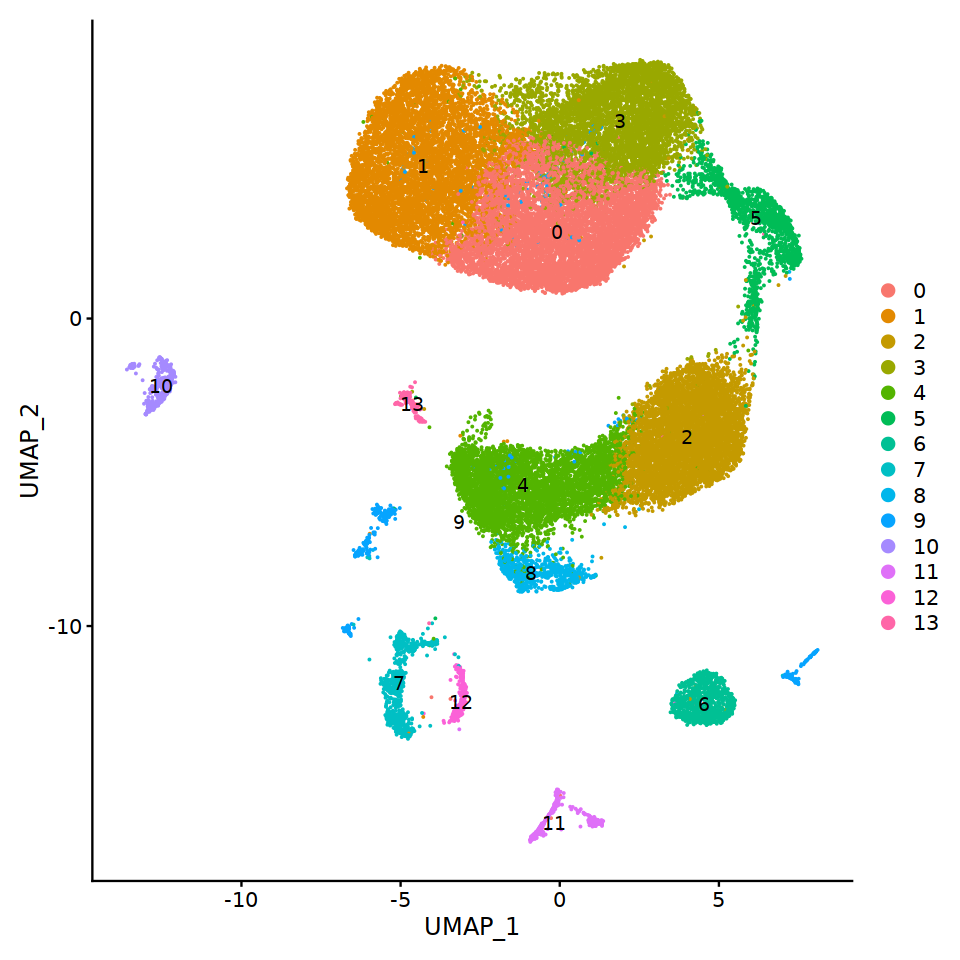

In [13]:
options(repr.plot.width=8, repr.plot.height=8)
seur$Annot1 = Idents(seur)
seur_ni_n = subset(seur, idents = immune, invert = T)
seur_ni_n = subset(seur_ni_n, subset = TumorNormal == "Normal")
seur_ni_n <- NormalizeData(seur_ni_n)
seur_ni_n <- FindVariableFeatures(seur_ni_n, selection.method = "vst",nfeatures = 3000)
seur_ni_n <- ScaleData(seur_ni_n, features = row.names(seur_ni_n))
seur_ni_n <- RunPCA(seur_ni_n, npcs = 30,verbose = T)
seur_ni_n <- RunHarmony(seur_ni_n, group.by.vars = "Sex")
seur_ni_n <- RunUMAP(seur_ni_n, reduction = "harmony", dims = 1:30)
seur_ni_n <- FindNeighbors(seur_ni_n, reduction = "harmony", dims = 1:30)
seur_ni_n <- FindClusters(seur_ni_n, resolution = 0.3)
DimPlot(seur_ni_n, label = T)

In [ ]:
saveRDS(seur_ni_n, file = "Manuscript_Objects/NonImmune_NormalKidney_SeuratObject.RDS")

In [8]:
seur_ni_n.downsample <- subset(seur_ni_n, downsample = 1000)

markers <- FindAllMarkers(seur_ni_n.downsample, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numer

In [9]:
saveRDS(markers, file = "Manuscript_Objects/NonImmune_NormalKidney_FindAllMarkers_LR_Sex.RDS")

In [6]:
markers = readRDS("Manuscript_Objects/NonImmune_NormalKidney_FindAllMarkers_LR_Sex.RDS")

In [7]:
markers %>%
    group_by(cluster) %>%
    top_n(n = 5, wt = avg_log2FC) -> top5

top5

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
2.581061e-308,1.834296,0.992,0.774,6.161252e-304,0,Cyb5a
8.039055e-302,1.762266,1.000,0.742,1.919003e-297,0,Gpx1
3.672531e-283,1.866884,0.996,0.554,8.766698e-279,0,Ttc36
2.135012e-212,1.806249,0.952,0.492,5.096487e-208,0,Acaa1b
4.797495e-208,1.827905,0.978,0.504,1.145210e-203,0,Akr1c21
2.587916e-320,2.436578,0.982,0.458,6.177614e-316,1,Gatm
1.928776e-276,1.895281,0.988,0.577,4.604180e-272,1,Ass1
4.560182e-252,1.658849,1.000,0.885,1.088561e-247,1,Ftl1
3.590530e-173,1.585592,0.888,0.532,8.570954e-169,1,Idh1


In [2]:
seur_ni_n = readRDS("Manuscript_Objects/NonImmune_NormalKidney_SeuratObject.RDS")

In [3]:
table(seur_ni_n$Sample)


  10_VX516_N  12_VX5256_N 5_BB452_KR_N    8_BB455_N 
        8052         9100         7359        11185 

In [4]:
DefaultAssay(seur_ni_n) = "RNA"
cluster.averages <- AverageExpression(seur_ni_n, return.seurat = TRUE, group.by = "seurat_clusters",add.ident = "Sample")
cluster_sample = strsplit(row.names(cluster.averages@meta.data),"_")
sample = lapply(cluster_sample, function(x) x[-1])
cluster.averages$Sample = unlist(lapply(sample, paste,collapse = "_"))
cluster.averages$orig.ident = factor(cluster.averages$orig.ident, levels = c(0:13))

Warning message:
"'add.ident' is a deprecated argument, please use the 'group.by' argument instead"
Centering and scaling data matrix



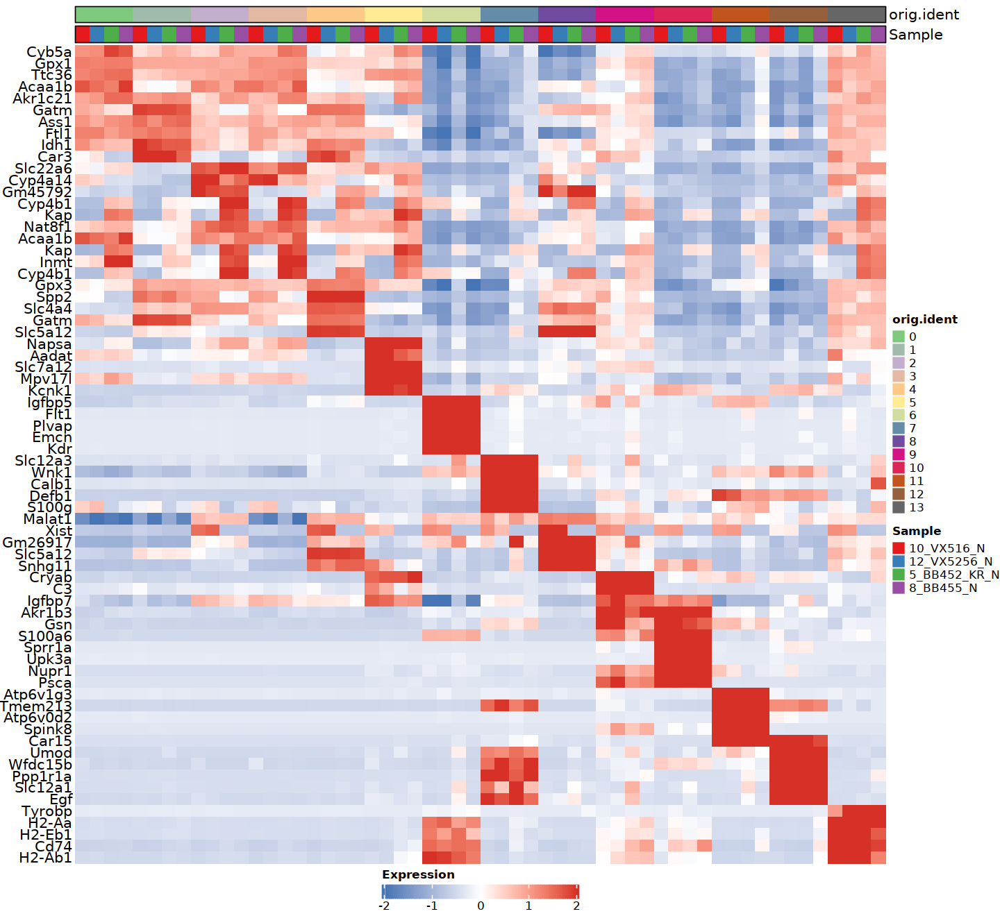

In [8]:
options(repr.plot.width=12, repr.plot.height=11)

colors <- list(colorRampPalette(brewer.pal(8, "Accent"))(14),brewer.pal(4,"Set1"))

DefaultAssay(cluster.averages) = "RNA"
plot_heatmap(dataset = cluster.averages, 
              markers = top5$gene,
              sort_var = c("orig.ident","Sample"),
              anno_var = c("orig.ident","Sample"),
              anno_colors = colors)


In [11]:
#0 PT_Akr1c21
#1 PT_Gatm
#2 PT_Cyp4a14
#3 PT_Kap
#4 PT_Slc5a12
#5 PT_Slc7a12
#6 Endothelial_Norm_Igfbp5
#7 DCT_Slc12a3
#8 PT_Slc34a1
#9 Mix (subset)
#10 Uroepithelium_Upk3a
#11 IC_Atp6v1g3 
#12 LOH_Slc12a1
#13 Immune_Contaminant

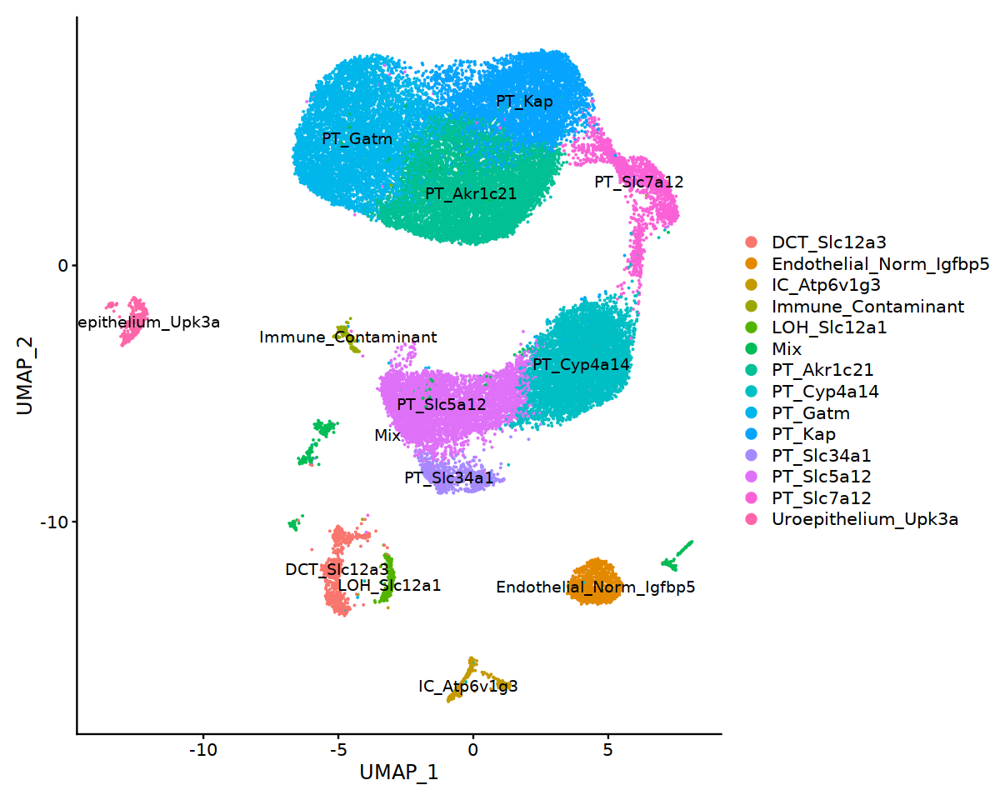

In [13]:
Idents(seur_ni_n) = "seurat_clusters"

new.cluster.ids = c("PT_Akr1c21","PT_Gatm","PT_Cyp4a14","PT_Kap","PT_Slc5a12","PT_Slc7a12","Endothelial_Norm_Igfbp5","DCT_Slc12a3","PT_Slc34a1","Mix","Uroepithelium_Upk3a","IC_Atp6v1g3","LOH_Slc12a1","Immune_Contaminant")
names(new.cluster.ids) = levels(seur_ni_n)
seur_ni_n = RenameIdents(seur_ni_n, new.cluster.ids)

Idents(seur_ni_n) = factor(Idents(seur_ni_n), levels = sort(unique(as.character(Idents(seur_ni_n)))) )

options(repr.plot.width=10, repr.plot.height=8)
DimPlot(seur_ni_n, label = T)

### 4. Subset, reproject, and recluster mixed cluster, then map true identities back to complete object

Centering and scaling data matrix

PC_ 1 
Positive:  Timp2, Gsn, Tmsb4x, Col1a2, Ahnak, Sparc, Anxa2, Aebp1, Ogn, Serping1 
	   S100a6, Pcolce, Plpp3, Dcn, Nbl1, Anxa1, Vim, Col3a1, Col1a1, Efemp1 
	   Itm2b, Emp3, Fstl1, Lrp1, Txnip, Cst3, Clec3b, Igfbp6, Serpinh1, Col6a1 
Negative:  Aldob, Rida, Gpx1, Spink1, Dbi, Sord, Ass1, Fbp1, Akr1a1, Akr1c21 
	   Gsta2, Miox, Scp2, Sult1d1, Glyat, Ttc36, Ldhb, Keg1, Khk, Ftl1 
	   Ndrg1, Gpx3, Cda, Pdzk1, AI314278, Pah, Cltrn, Cat, 4931406C07Rik, Pck1 
PC_ 2 
Positive:  Epcam, Mal, Cdh16, Plet1, Tacstd2, Cd24a, Muc1, Mal2, Spint2, Krt18 
	   Adgrg1, Ehf, Cldn7, Bcam, Cdh1, Tmem30b, Atp1b1, Lcn2, Apela, Hacd4 
	   Akr1b3, Aqp2, Cd82, L1cam, Dsp, Fxyd4, Muc20, Cldn8, Krt7, Aqp4 
Negative:  Dcn, Serping1, Col3a1, Clec3b, Col1a1, Mfap5, Ogn, Igfbp6, Lum, Serpinf1 
	   C1s1, Col6a1, Pcolce2, Col1a2, Prrx1, Rnase4, Col14a1, Scara5, Tnxb, Rarres2 
	   Cd34, Col6a2, Adamts2, Dpep1, Dpt, Igfbp4, Ebf1, Fbn1, Pdgfra, Pi16 
PC_ 3 
Positive:  Cd9, Ly6e, Atp

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 621
Number of edges: 16500

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8982
Number of communities: 7
Elapsed time: 0 seconds


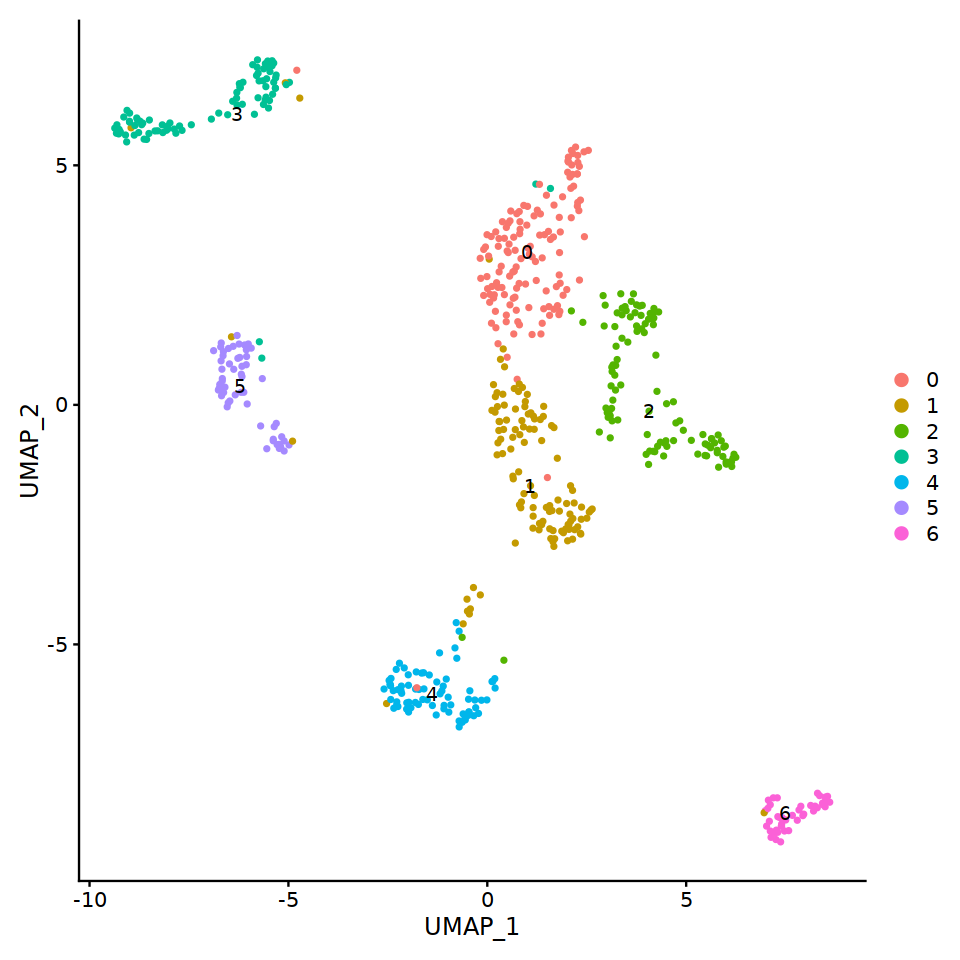

In [14]:
options(repr.plot.width=8, repr.plot.height=8)
seur_mix = subset(seur_ni_n, idents = "Mix")
seur_mix <- NormalizeData(seur_mix)
seur_mix <- FindVariableFeatures(seur_mix, selection.method = "vst",nfeatures = 3000)
seur_mix <- ScaleData(seur_mix, features = row.names(seur_mix))
seur_mix <- RunPCA(seur_mix, npcs = 20,verbose = T)
seur_mix <- RunHarmony(seur_mix, group.by.vars = "Sex")
seur_mix <- RunUMAP(seur_mix, reduction = "harmony", dims = 1:20)
seur_mix <- FindNeighbors(seur_mix, reduction = "harmony", dims = 1:20)
seur_mix <- FindClusters(seur_mix, resolution = 0.3)
DimPlot(seur_mix, label = T)

In [15]:
markers_mix <- FindAllMarkers(seur_mix, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")
markers_mix %>% group_by(cluster) %>% top_n(n = 10, wt = avg_log2FC)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Calculating cluster 5

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Calculating cluster 6

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"


p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
1.860690e-79,2.218455,1.000,0.813,4.441653e-75,0,Ftl1
6.118507e-76,2.583844,1.000,0.448,1.460549e-71,0,Miox
1.084160e-71,2.222191,0.993,0.715,2.587997e-67,0,Cyb5a
1.130418e-70,2.167576,0.993,0.634,2.698420e-66,0,Akr1a1
2.702092e-68,2.104213,0.993,0.571,6.450164e-64,0,Rida
3.826169e-67,2.257680,1.000,0.439,9.133447e-63,0,Ass1
1.615178e-66,2.508645,0.955,0.462,3.855591e-62,0,Ttc36
3.304691e-61,2.485985,0.940,0.431,7.888628e-57,0,Akr1c21
1.533623e-54,2.120455,0.881,0.378,3.660911e-50,0,Cda


Warning message:
"'add.ident' is a deprecated argument, please use the 'group.by' argument instead"
Centering and scaling data matrix



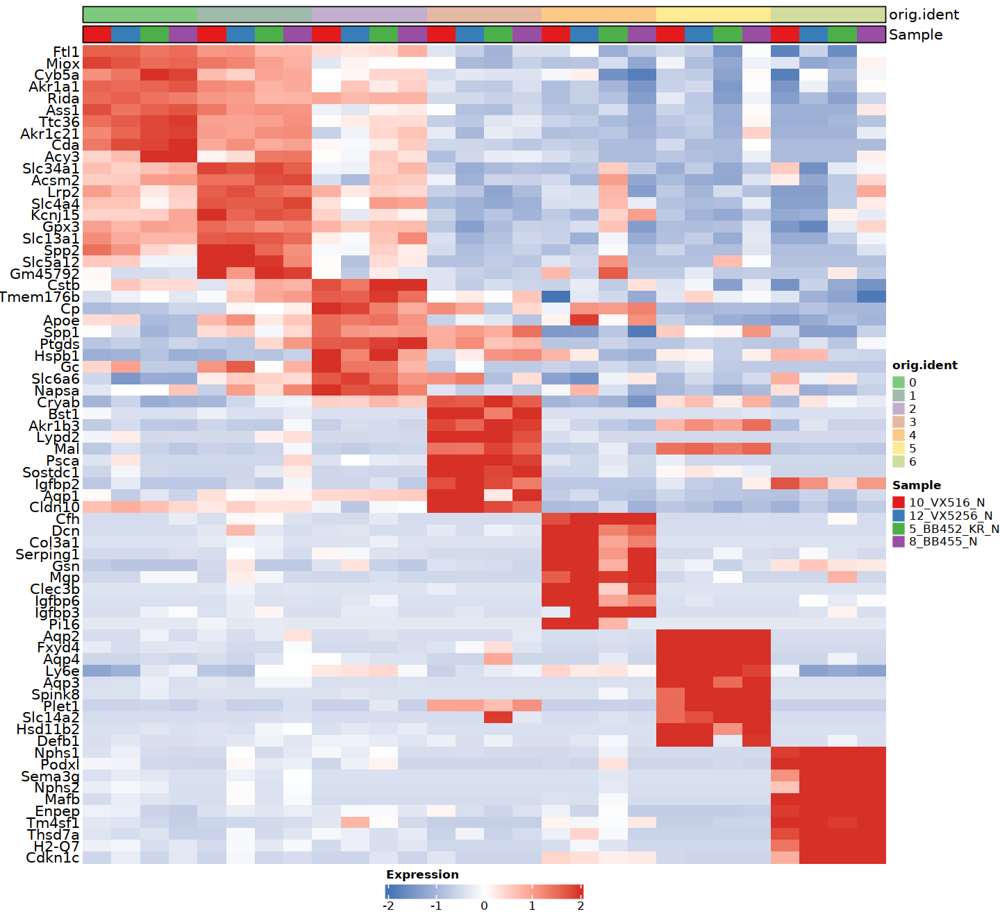

In [19]:
markers_mix %>%
    group_by(cluster) %>%
    top_n(n = 10, wt = avg_log2FC) -> top10

DefaultAssay(seur_mix) = "RNA"
cluster.averages <- AverageExpression(seur_mix, return.seurat = TRUE, group.by = "seurat_clusters",add.ident = "Sample")
cluster_sample = strsplit(row.names(cluster.averages@meta.data),"_")
sample = lapply(cluster_sample, function(x) x[-1])
cluster.averages$Sample = unlist(lapply(sample, paste,collapse = "_"))
cluster.averages$orig.ident = factor(cluster.averages$orig.ident, levels = c(0:length(unique(cluster.averages$orig.ident))))
                
options(repr.plot.width=12, repr.plot.height=11)

colors <- list(colorRampPalette(brewer.pal(8, "Accent"))(14),brewer.pal(4,"Set1"))

DefaultAssay(cluster.averages) = "RNA"
plot_heatmap(dataset = cluster.averages, 
              markers = top10$gene,
              sort_var = c("orig.ident","Sample"),
              anno_var = c("orig.ident","Sample"),
              anno_colors = colors)


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



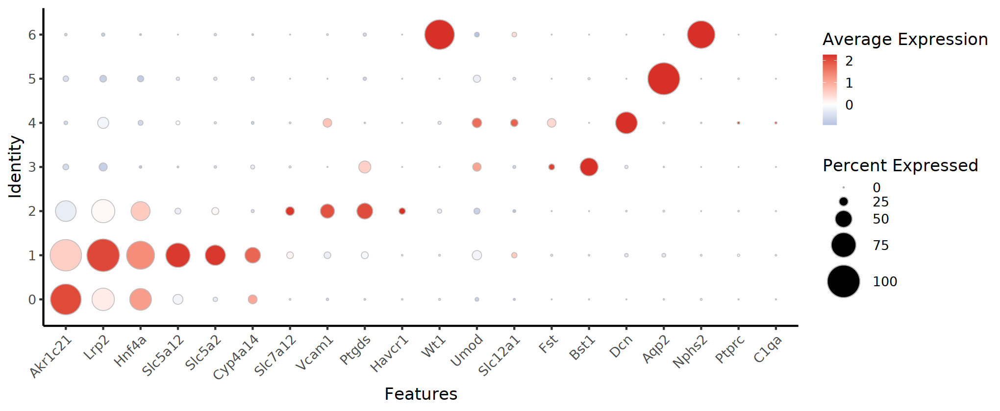

In [36]:
options(repr.plot.width=17, repr.plot.height=7)

DotPlot(seur_mix, features = c("Akr1c21","Lrp2","Hnf4a","Slc5a12","Slc5a2","Cyp4a14","Slc7a12","Vcam1","Ptgds","Havcr1","Wt1","Umod","Slc12a1","Fst","Bst1","Dcn","Aqp2","Nphs2","Ptprc","C1qa"),assay = "RNA",dot.scale = 18, cols = c("white","red")) + theme_classic(base_size = 20) +
geom_point(aes(size = pct.exp),shape = 21, color = "grey",stroke = 0.5) + 
scale_colour_gradient2(low = "#4575b4", mid = "white", high = "#d73027") +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))

In [44]:
#0 PT_Unidentified
#1 PT_Unidentified
#2 PT_Unidentified
#3 LOH_Bst1
#4 Fibroblast_Dcn
#4 PC_Aqp2
#5 Podocyte_Nphs2

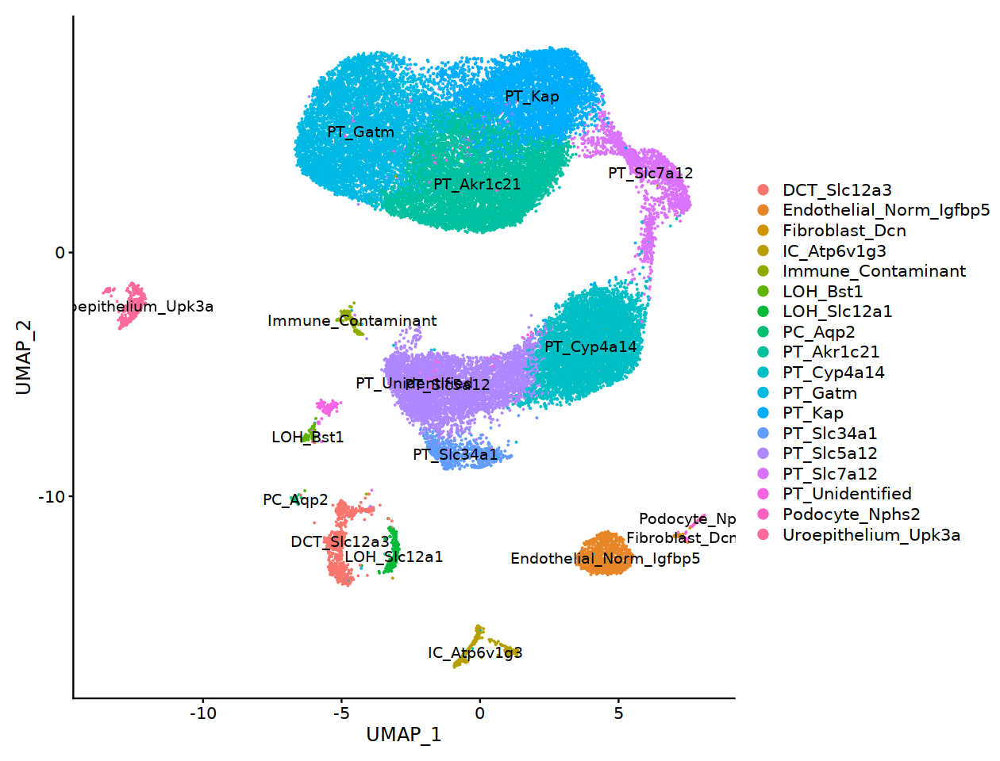

In [207]:
seur_ni_n = SetIdent(seur_ni_n, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 0)),value = "PT_Unidentified")
seur_ni_n = SetIdent(seur_ni_n, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 1)),value = "PT_Unidentified")
seur_ni_n = SetIdent(seur_ni_n, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 2)),value = "PT_Unidentified")
seur_ni_n = SetIdent(seur_ni_n, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 3)),value = "LOH_Bst1")
seur_ni_n = SetIdent(seur_ni_n, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 4)),value = "Fibroblast_Dcn")
seur_ni_n = SetIdent(seur_ni_n, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 5)),value = "PC_Aqp2")
seur_ni_n = SetIdent(seur_ni_n, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 6)),value = "Podocyte_Nphs2")

Idents(seur_ni_n) = factor(Idents(seur_ni_n), levels = sort(unique(as.character(Idents(seur_ni_n)))) )

options(repr.plot.width=10.5, repr.plot.height=8)
DimPlot(seur_ni_n, label = T)

Podocyte_Nphs2              PT_Slc34a1              PT_Slc5a12 
              "#666666"               "#8A6145"               "#AF5C24" 
             PT_Cyp4a14              PT_Slc7a12              PT_Akr1c21 
              "#CA462F"               "#DE215A"               "#E50881" 
                 PT_Kap                 PT_Gatm         PT_Unidentified 
              "#993396"               "#4D5FAA"               "#7297A9" 
            LOH_Slc12a1                LOH_Bst1             DCT_Slc12a3 
              "#C4D39F"               "#FEF796"               "#FDDD8E" 
            IC_Atp6v1g3                 PC_Aqp2 Endothelial_Norm_Igfbp5 
              "#FDC387"               "#E6B9A1"               "#CCB2C1" 
         Fibroblast_Dcn     Uroepithelium_Upk3a      Immune_Contaminant 
              "#B2B2C5"               "#98BDA2"               "#7FC97F"

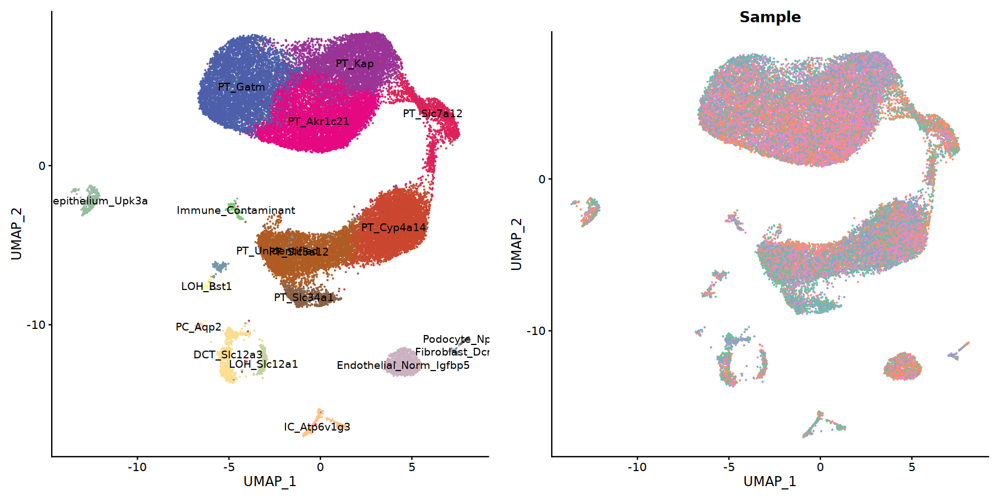

In [208]:
ordered = c("Podocyte_Nphs2","PT_Slc34a1","PT_Slc5a12","PT_Cyp4a14","PT_Slc7a12","PT_Akr1c21","PT_Kap","PT_Gatm","PT_Unidentified","LOH_Slc12a1","LOH_Bst1","DCT_Slc12a3","IC_Atp6v1g3","PC_Aqp2","Endothelial_Norm_Igfbp5","Fibroblast_Dcn","Uroepithelium_Upk3a","Immune_Contaminant")
Idents(seur_ni_n) = factor(Idents(seur_ni_n), levels = ordered)

mycols = rev(colorRampPalette(brewer.pal(8, "Accent"))(18))
names(mycols) = as.character(levels(Idents(seur_ni_n)))
mycols

one = DimPlot(seur_ni_n, label = T, cols = mycols[as.character(levels(Idents(seur_ni_n)))]) + NoLegend()
two = DimPlot(seur_ni_n, group.by = "Sample", cols = brewer.pal(4, "Set2"),shuffle = T) + NoLegend()


library(ggpubr)
options(repr.plot.width=15, repr.plot.height=7.5)
ggarrange(one, two, nrow = 1)

ggsave("Manuscript_Figures//Normal_UMAPs_Combined_CellType_Sample.pdf", width = 15, height = 7.5)

,Var1,Var2,Freq
,<fct>,<fct>,<dbl>
1,10_VX516_N,Podocyte_Nphs2,0.04545455
2,12_VX5256_N,Podocyte_Nphs2,0.56818182
3,5_BB452_KR_N,Podocyte_Nphs2,0.31818182
4,8_BB455_N,Podocyte_Nphs2,0.06818182
5,10_VX516_N,PT_Slc34a1,0.48194444


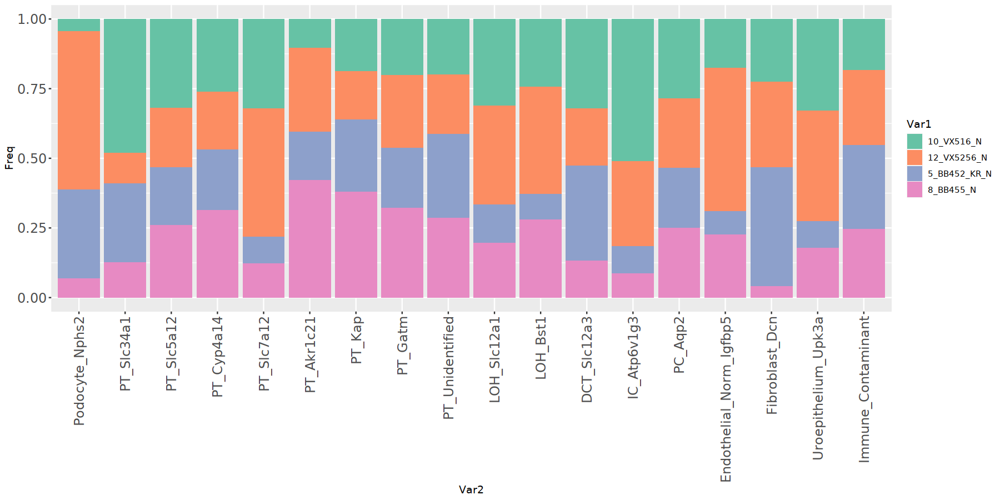

In [210]:
options(repr.plot.width=15, repr.plot.height=7.5)
props <- prop.table(table(seur_ni_n$Sample,Idents(seur_ni_n)), margin = 2)
props <- data.frame(props)
corner(props)
ggplot() + geom_bar(aes(y = Freq, x = Var2, fill = Var1), data = props, stat="identity") +theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1,size=14),
          axis.text.y = element_text(size=14)) + scale_fill_manual(values = brewer.pal(4, "Set2")) 


In [211]:
saveRDS(seur_ni_n, file = "Manuscript_Objects/NonImmune_NormalKidney_SeuratObject.RDS")

In [138]:
seur_ni_n = readRDS("Manuscript_Objects/NonImmune_NormalKidney_SeuratObject.RDS")

### 5. Characterize phenotypic/technical differences between two main groupings of PT cells 
#### PT_A: PT_Gatm, PT_Akr1c21, PT_Kap
#### PT_B: PT_Slc34a1, PT_Slc5a12, PT_Cyp4a14

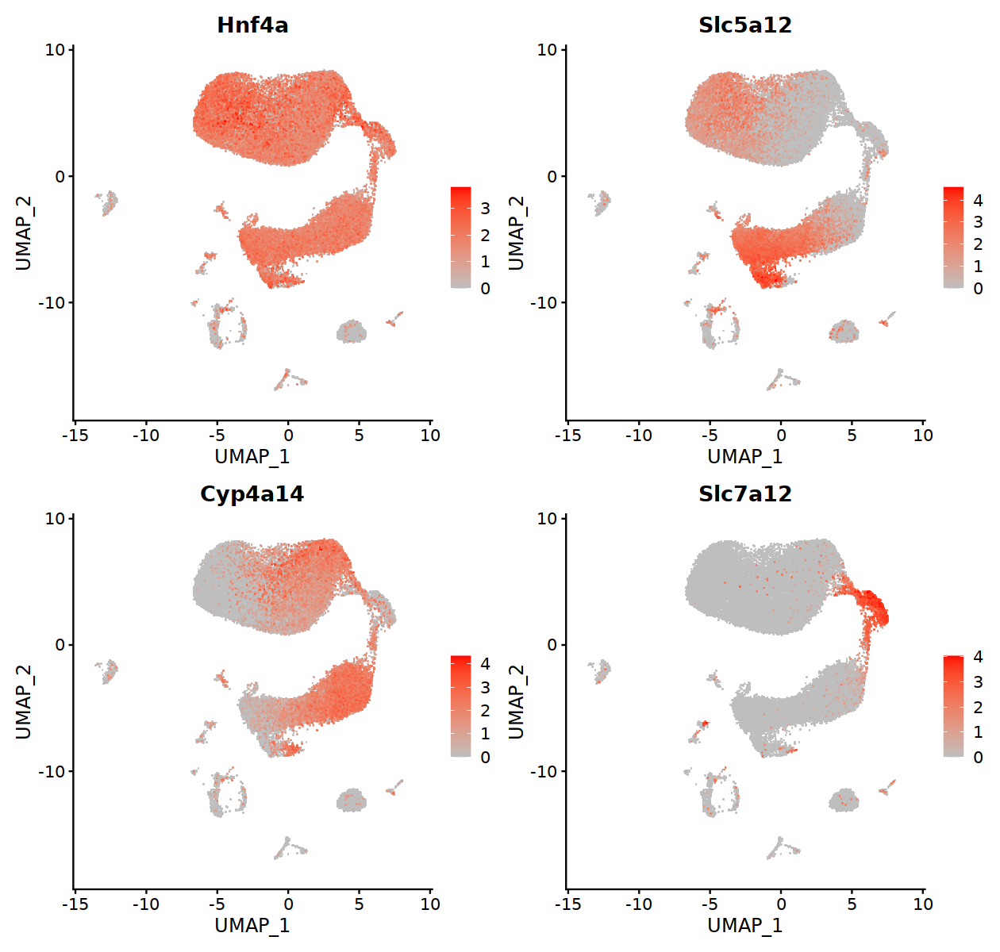

In [212]:
options(repr.plot.width=10.5, repr.plot.height=10)
FeaturePlot(seur_ni_n, c("Hnf4a","Slc5a12","Cyp4a14","Slc7a12"),order = T,ncol = 2,raster = T,cols = c("grey","red"))
ggsave("Manuscript_Figures/Normal_S1S2S3_FeaturePlots.pdf", width = 10.5, height = 10)

In [226]:
seur_ni_n_sub = subset(seur_ni_n, idents = c("PT_Gatm","PT_Akr1c21", "PT_Kap", "PT_Slc34a1", "PT_Slc5a12", "PT_Cyp4a14"))
Idents(seur_ni_n_sub) = factor(Idents(seur_ni_n_sub),levels = c("PT_Gatm","PT_Akr1c21", "PT_Kap", "PT_Slc34a1", "PT_Slc5a12", "PT_Cyp4a14"))

In [227]:
seur_ni_n_sub[["percent.rps"]] <- PercentageFeatureSet(seur_ni_n_sub, pattern = "^Rps")
seur_ni_n_sub[["percent.rpl"]] <- PercentageFeatureSet(seur_ni_n_sub, pattern = "^Rpl")

In [228]:
seur_ni_n_sub$pt = Idents(seur_ni_n_sub)
meta = seur_ni_n_sub@meta.data
meta = mutate(meta, Group = ifelse(pt %in% c("PT_Gatm","PT_Akr1c21", "PT_Kap"),"PT_A","PT_B"))
seur_ni_n_sub$Group = meta$Group
seur_ni_n_sub$Group = factor(seur_ni_n_sub$Group, levels = c("PT_A","PT_B"))

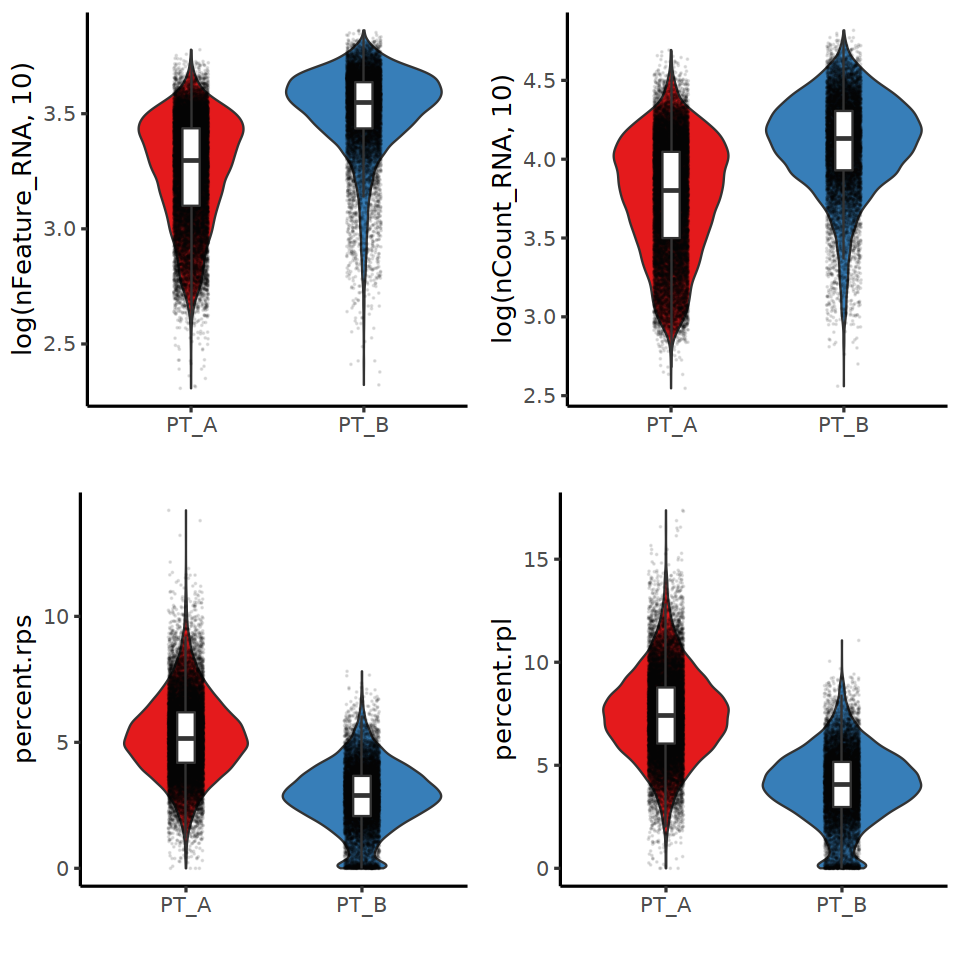

In [229]:
options(repr.plot.width=8, repr.plot.height=8)

plot_df = seur_ni_n_sub@meta.data

nfeat = ggplot(plot_df, aes(x=Group, y=log(nFeature_RNA,10), fill = Group)) + 
  geom_violin() + geom_jitter(color = "black",alpha = 0.1,width = 0.1,size = 0.01) + 
geom_boxplot(width = 0.1,fill = "white",outlier.shape = NA) + theme_classic(base_size = 15) + 
scale_fill_manual(values = c("#e41a1c","#377eb8")) + theme(legend.position = "none") + xlab(label = "")

ncount = ggplot(plot_df, aes(x=Group, y=log(nCount_RNA,10), fill = Group)) + 
  geom_violin() + geom_jitter(color = "black",alpha = 0.1,width = 0.1,size = 0.01) + 
geom_boxplot(width = 0.1,fill = "white",outlier.shape = NA) + theme_classic(base_size = 15) + 
scale_fill_manual(values = c("#e41a1c","#377eb8")) + theme(legend.position = "none")+ xlab(label = "")

pct.rps = ggplot(plot_df, aes(x=Group, y=percent.rps, fill = Group)) + 
  geom_violin() + geom_jitter(color = "black",alpha = 0.1,width = 0.1,size = 0.01) + 
geom_boxplot(width = 0.1,fill = "white",outlier.shape = NA) + theme_classic(base_size = 15) + 
scale_fill_manual(values = c("#e41a1c","#377eb8")) + theme(legend.position = "none") + xlab(label = "")

pct.rpl = ggplot(plot_df, aes(x=Group, y=percent.rpl, fill = Group)) + 
  geom_violin() + geom_jitter(color = "black",alpha = 0.1,width = 0.1,size = 0.01) + 
geom_boxplot(width = 0.1,fill = "white",outlier.shape = NA) + theme_classic(base_size = 15) + 
scale_fill_manual(values = c("#e41a1c","#377eb8")) + theme(legend.position = "none") + xlab(label = "")

ggarrange(nfeat, ncount, pct.rps, pct.rpl, nrow = 2,ncol = 2)

### PT_A cells have lower nFeature and nCount per cell, and a higher proportion of counts from Rps and Rpl genes.

### DE between upper and lower S1 clusters (Slc5a12-high) shows differential expression of genes associated with ambient RNA contamination

In [230]:
Idents(seur_ni_n_sub) = "Group"

pt_de = FindMarkers(seur_ni_n_sub, `ident.1` = "PT_A",`ident.2` = "PT_B",test.use = "LR",latent.vars = "Sex",min.diff.pct = 0, min.pct = 0,logfc.threshold = 0)


Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

In [231]:
saveRDS(pt_de, file = "Manuscript_Objects/PT_A_vs_B_DE_LR_Sex.RDS")

In [232]:
pt_a_up = pt_de %>% 
subset(avg_log2FC > 0.75 & p_val_adj < 0.001) %>%
arrange(desc(avg_log2FC))

In [233]:
pt_b_up = pt_de %>% 
subset(avg_log2FC < -0.75 & p_val_adj < 0.001) %>%
arrange(avg_log2FC)

`use_raster` is automatically set to TRUE for a matrix with more than
2000 columns You can control `use_raster` argument by explicitly
setting TRUE/FALSE to it.

Set `ht_opt$message = FALSE` to turn off this message.

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



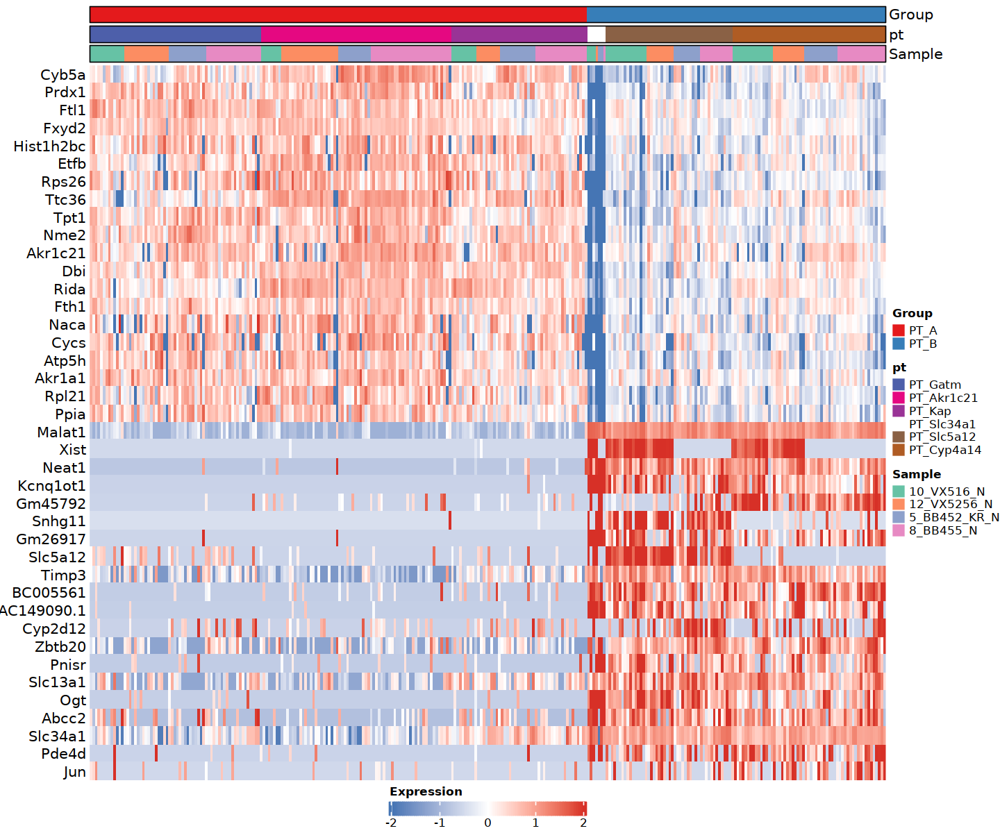

In [234]:
options(repr.plot.width=12, repr.plot.height=10)

colors <- list(c("#e41a1c","#377eb8"),mycols[c("PT_Gatm","PT_Akr1c21", "PT_Kap", "PT_Mix_1","PT_Slc34a1", "PT_Slc5a12", "PT_Cyp4a14", "PT_Mix_2")],brewer.pal(4, "Set2"))

plot_heatmap(dataset = seur_ni_n_sub, 
              markers = c(row.names(pt_a_up)[1:20],row.names(pt_b_up)[1:20]),
              sort_var = c("Group","pt","Sample"),
              anno_var = c("Group","pt","Sample"),
              anno_colors = colors)

### Enrichment of Ftl1, Fth1, Rps, and Rpl genes in PT_A suggests unresolved ambient contaminant 

### 6. Use low RNA content droplets from each normal kidney sample to identify genes dominating ambient RNA profile

In [235]:
samples = c("10_VX516_N","12_VX5256_N","5_BB452_KR_N","8_BB455_N")

In [236]:
ambient_genes = list()

for (i in 1:length(samples)){
    raw = Read10X_h5(paste("Raw_BC_Matrix//",samples[i],"_raw_feature_bc_matrix.h5",sep = ""))
    raw_colsums = colSums(raw)
                     
empties = names(which(raw_colsums > 50 & raw_colsums < 200))
empties_matrix = raw[,empties]
empties_rowsums = rowSums(empties_matrix)
empties_rowsums = empties_rowsums[order(empties_rowsums, decreasing = T)]
empties_rowsums = data.frame(empties_rowsums)
empties_rowsums$gene = row.names(empties_rowsums) 
                     
ambient_genes[[i]] = empties_rowsums[1:200,]$gene
}

names(ambient_genes) = samples

In [237]:
str(ambient_genes)

List of 4
 $ 10_VX516_N  : chr [1:200] "Gm42418" "mt-Co3" "mt-Atp6" "Malat1" ...
 $ 12_VX5256_N : chr [1:200] "Gm42418" "mt-Co3" "mt-Atp6" "mt-Co2" ...
 $ 5_BB452_KR_N: chr [1:200] "Gm42418" "mt-Co3" "Kap" "mt-Atp6" ...
 $ 8_BB455_N   : chr [1:200] "Gm42418" "Kap" "mt-Co3" "mt-Atp6" ...


In [238]:
int_ambient = Reduce(intersect, list(ambient_genes[[1]],ambient_genes[[2]],ambient_genes[[3]],ambient_genes[[4]]))
length(int_ambient)
int_ambient

[1] 175

[1] "Gm42418"  "mt-Co3"   "mt-Atp6"  "Malat1"   "mt-Co2"   "mt-Co1"  
  [7] "mt-Cytb"  "Gpx3"     "mt-Nd2"   "Fth1"     "mt-Nd4"   "Ftl1"    
 [13] "mt-Nd1"   "Fxyd2"    "AY036118" "mt-Nd3"   "Tpt1"     "Aldob"   
 [19] "Dbi"      "Rps29"    "Cox4i1"   "Spink1"   "Gpx1"     "Rida"    
 [25] "Miox"     "Cox6c"    "Eef1a1"   "Rpl41"    "Lrp2"     "Cox7c"   
 [31] "Rplp1"    "Spp1"     "Chchd2"   "Rpl23"    "Rpl37a"   "Fau"     
 [37] "Rps24"    "Cox8a"    "Slc34a1"  "Ndufa4"   "Rps8"     "Rpl13"   
 [43] "Prdx5"    "Rpl38"    "Rpl35a"   "Hspa8"    "Rps21"    "Atp5e"   
 [49] "Rpl28"    "Rpl37"    "Rps28"    "Chchd10"  "Rpl32"    "Rps27a"  
 [55] "Rpl26"    "Ass1"     "Rpl27a"   "Rps12"    "Atp5l"    "Ppia"    
 [61] "Rps20"    "Rpl6"     "Rpl19"    "Rps10"    "Atp5b"    "Rps23"   
 [67] "Rpl39"    "Cox7b"    "Atp1a1"   "Rps19"    "Nme2"     "Rps3a1"  
 [73] "Gsta2"    "Cox7a2"   "Akr1a1"   "Rps14"    "Cox6b1"   "Cltrn"   
 [79] "Prdx1"    "Rps27"    "Atp1b1"   "Rpl11"    "Rps16"    "mt-Nd5"  
 [85] "Rplp0"    "Atp5h"    "Rpl30"    "Gatm"     "Rpl21"    "Pck1"    
 [91] "Rpl34"    "Rpl36"    "Rpl24"    "Atp5g1"   "Rps2"     "Hsp90ab1"
 [97] "Rpsa"     "Slc27a2"  "Uqcr11"   "Ndrg1"    "Ldhb"     "Rpl18a"  
[103] "Gpx4"     "Uqcr10"   "Itm2b"    "Rps15a"   "Uqcrh"    "Rps18"   
[109] "Cd63"     "Rps13"    "Cox5b"    "Lars2"    "Uqcrb"    "Rplp2"   
[115] "Atp5md"   "Atpif1"   "Atp5j"    "Rps4x"    "Ubb"      "Rps11"   
[121] "Rpl17"    "Rps9"     "Rps26"    "Scp2"     "Atp5j2"   "Rps7"    
[127] "Mdh1"     "Chpt1"    "Atp5a1"   "Slc25a3"  "Rpl9"     "Rpl8"    
[133] "Uqcrq"    "Cox5a"    "Rpl13a"   "Gapdh"    "Slc25a5"  "Akr1c21" 
[139] "Rps25"    "Cyb5a"    "Atp5k"    "Etfb"     "Hint1"    "Rpl27"   
[145] "Ndufa13"  "Ttc36"    "Mpc2"     "Rpl15"    "Rpl7"     "Rps17"   
[151] "Rpl14"    "Rps5"     "Atp5o"    "Mif"      "Eif1"     "Rps15"   
[157] "Ndufb9"   "Rpl10"    "Serf2"    "Rps3"     "Atp5mpl"  "Atp5f1"  
[163] "Rpl5"     "Atp5d"    "Fbp1"     "Ndufa2"   "Myl6"     "Ndufa6"  
[169] "Rpl22"    "Rpl12"    "Atp5c1"   "Hspe1"    "Mpc1"     "Ndufb4"  
[175] "Txn1"

In [239]:
union_ambient = unique(unlist(ambient_genes))
length(union_ambient)
union_ambient

[1] 227

[1] "Gm42418"   "mt-Co3"    "mt-Atp6"   "Malat1"    "mt-Co2"    "mt-Co1"   
  [7] "mt-Cytb"   "Gpx3"      "mt-Nd2"    "Fth1"      "mt-Nd4"    "Ftl1"     
 [13] "mt-Nd1"    "Fxyd2"     "AY036118"  "mt-Nd3"    "Tpt1"      "Aldob"    
 [19] "Dbi"       "Rps29"     "Cox4i1"    "Spink1"    "Gpx1"      "Rida"     
 [25] "Miox"      "Cox6c"     "Eef1a1"    "Rpl41"     "Lrp2"      "Cox7c"    
 [31] "Rplp1"     "Spp1"      "Chchd2"    "Rpl23"     "Rpl37a"    "Fau"      
 [37] "Rps24"     "Cox8a"     "Slc34a1"   "Ndufa4"    "Rps8"      "Rpl13"    
 [43] "Prdx5"     "Rpl38"     "Tmsb4x"    "Rpl35a"    "Hspa8"     "Rps21"    
 [49] "Atp5e"     "Rpl28"     "Rpl37"     "Rps28"     "Chchd10"   "Rpl32"    
 [55] "Rps27a"    "Rpl26"     "Ass1"      "Rpl27a"    "Rps12"     "Atp5l"    
 [61] "Ppia"      "Rps20"     "Rpl6"      "Rpl19"     "Rps10"     "Atp5b"    
 [67] "Rps23"     "Klk1"      "Rpl39"     "Cox7b"     "Atp1a1"    "Rps19"    
 [73] "Nme2"      "Rps3a1"    "Gsta2"     "Cox7a2"    "Akr1a1"    "Rps14"    
 [79] "Cox6b1"    "Cltrn"     "Prdx1"     "Rps27"     "Atp1b1"    "Rpl11"    
 [85] "Rps16"     "mt-Nd5"    "Rplp0"     "Atp5h"     "Rpl30"     "Gatm"     
 [91] "Rpl21"     "Pck1"      "Napsa"     "Rpl34"     "Rpl36"     "Rpl24"    
 [97] "Atp5g1"    "Rps2"      "Hsp90ab1"  "Rpsa"      "Slc27a2"   "Uqcr11"   
[103] "Ndrg1"     "Ldhb"      "Rpl18a"    "Gpx4"      "Uqcr10"    "Itm2b"    
[109] "Rps15a"    "Actb"      "Uqcrh"     "Rps18"     "Cd63"      "Rps13"    
[115] "Cox5b"     "Lars2"     "Uqcrb"     "Rplp2"     "Atp5md"    "Atpif1"   
[121] "Atp5j"     "Rps4x"     "Ubb"       "Rps11"     "Rpl17"     "Rps9"     
[127] "Rps26"     "Scp2"      "Atp5j2"    "Rps7"      "Mdh1"      "Chpt1"    
[133] "Atp5a1"    "Igfbp7"    "Slc25a3"   "Rpl9"      "Rpl8"      "Uqcrq"    
[139] "Cox5a"     "Rpl13a"    "Gapdh"     "Slc25a5"   "Akr1c21"   "Rps25"    
[145] "Umod"      "Cyb5a"     "Atp5k"     "Etfb"      "Hint1"     "Rpl27"    
[151] "Cox6a1"    "Ndufa13"   "Ttc36"     "Mpc2"      "Rpl15"     "Apoe"     
[157] "Rpl7"      "Rps17"     "Rpl14"     "S100g"     "Rps5"      "Timp3"    
[163] "Atp5o"     "Hbb-bs"    "Mif"       "Eif1"      "Rps15"     "Ndufb9"   
[169] "Rpl18"     "Rpl10"     "Serf2"     "Rps3"      "Atp5g3"    "Atp5mpl"  
[175] "mt-Nd4l"   "Atp5f1"    "Rpl5"      "Atp5d"     "Ndufc1"    "Fbp1"     
[181] "Ndufa2"    "Myl6"      "Ndufa6"    "Tmbim6"    "Apob"      "Rpl22"    
[187] "Slc4a4"    "Rpl10a"    "Rpl23a"    "Rpl12"     "Atp5c1"    "Rpl3"     
[193] "Slc13a1"   "Esd"       "Cyba"      "Hspe1"     "Mpc1"      "Ndufb4"   
[199] "Txn1"      "Rpl7a"     "Park7"     "Naca"      "Hist1h2bc" "Ubc"      
[205] "Sult1d1"   "Keg1"      "Cisd1"     "Hao2"      "Rack1"     "Sord"     
[211] "Ndufab1"   "Kap"       "Hba-a1"    "Hba-a2"    "Cyp4b1"    "Hbb-bt"   
[217] "Ybx1"      "Acsm2"     "AI314278"  "mt-Nd6"    "Ndufb8"    "Rpl36al"  
[223] "Selenop"   "Igkc"      "Nat8f1"    "Ggt1"      "Khk"

In [240]:
ambient_genes$int_ambient = int_ambient
ambient_genes$union_ambient = union_ambient

str(ambient_genes)

List of 6
 $ 10_VX516_N   : chr [1:200] "Gm42418" "mt-Co3" "mt-Atp6" "Malat1" ...
 $ 12_VX5256_N  : chr [1:200] "Gm42418" "mt-Co3" "mt-Atp6" "mt-Co2" ...
 $ 5_BB452_KR_N : chr [1:200] "Gm42418" "mt-Co3" "Kap" "mt-Atp6" ...
 $ 8_BB455_N    : chr [1:200] "Gm42418" "Kap" "mt-Co3" "mt-Atp6" ...
 $ int_ambient  : chr [1:175] "Gm42418" "mt-Co3" "mt-Atp6" "Malat1" ...
 $ union_ambient: chr [1:227] "Gm42418" "mt-Co3" "mt-Atp6" "Malat1" ...


`use_raster` is automatically set to TRUE for a matrix with more than
2000 columns You can control `use_raster` argument by explicitly
setting TRUE/FALSE to it.

Set `ht_opt$message = FALSE` to turn off this message.

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



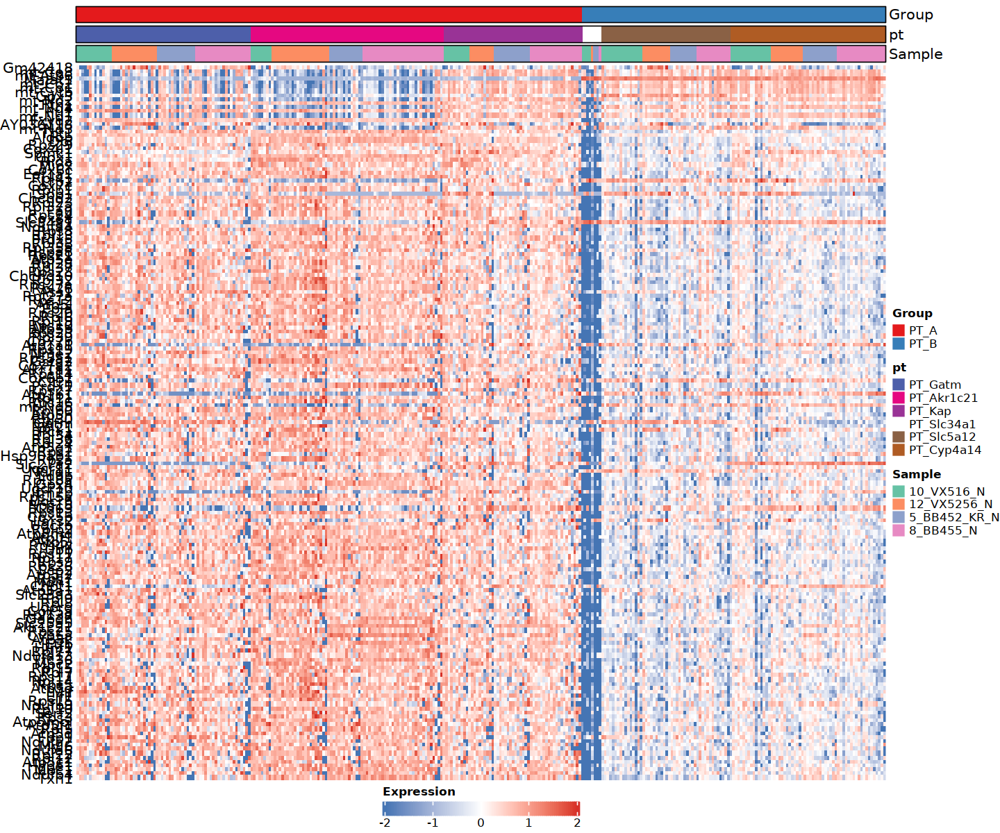

In [241]:
options(repr.plot.width=12, repr.plot.height=10)

colors <- list(c("#e41a1c","#377eb8"),mycols[c("PT_Gatm","PT_Akr1c21", "PT_Kap", "PT_Mix_1","PT_Slc34a1", "PT_Slc5a12", "PT_Cyp4a14", "PT_Mix_2")],brewer.pal(4, "Set2"))

plot_heatmap(dataset = seur_ni_n_sub, 
              markers = int_ambient,
              sort_var = c("Group","pt","Sample"),
              anno_var = c("Group","pt","Sample"),
              anno_colors = colors)

In [242]:
library(fgsea)

pt_de_rnk = pt_de$avg_log2FC
names(pt_de_rnk) <- row.names(pt_de)
corner(pt_de_rnk)

fgseaRes <- fgsea(ambient_genes, pt_de_rnk, minSize=0, maxSize= 300, nperm=1000)
fgseaRes

Rb1cc1 4732440D04Rik         Cspp1         Ncoa2         Tram1 
   -0.7064510    -0.6494665    -1.0756547    -0.2863275    -0.3067863

Warning message in fgsea(ambient_genes, pt_de_rnk, minSize = 0, maxSize = 300, nperm = 1000):
"You are trying to run fgseaSimple. It is recommended to use fgseaMultilevel. To run fgseaMultilevel, you need to remove the nperm argument in the fgsea function call."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (0.5% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."


pathway,pval,padj,ES,NES,nMoreExtreme,size,leadingEdge
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>
10_VX516_N,0.003496503,0.003571429,0.7621880,1.994080,0,200,"Cyb5a , Prdx1 , Ftl1 , Fxyd2 , Etfb , Rps26 , Ttc36 , Tpt1 , Nme2 , Akr1c21 , Dbi , Rida , Fth1 , Atp5h , Akr1a1 , Rpl21 , Ppia , Atp5e , Mif , Gsta2 , Mpc1 , Rps4x , Rpl41 , Rps3a1 , Chchd2 , Esd , Rpl3 , Txn1 , Prdx5 , Rpl32 , Atp5mpl , Rps2 , Atp5j , Rps27a , Fau , Atp5d , Rpl6 , Scp2 , Rpl26 , Rpl34 , Rps24 , Ubb , Atp5o , Gapdh , Rps8 , Rps12 , Rpl13 , Rps9 , Rps7 , Rps11 , Rpl10 , Rpl27 , Rplp0 , Gpx1 , Rpl22 , Rpsa , Rpl23 , Rpl15 , Rpl19 , Myl6 , Uqcrb , Rpl11 , Hspe1 , Rps13 , Rpl10a , Rpl7 , Rpl18a , Ldhb , Eif1 , Rpl28 , Rpl35a , Rpl9 , Rps10 , Rpl24 , Ndufa6 , Atp5l , Rpl30 , Rps15a , Chchd10 , Rps23 , Rps5 , Atp5c1 , Rps20 , Rpl27a , Ndufc1 , Rpl17 , Rpl8 , Rpl14 , Rps14 , Slc25a5 , Gpx4 , Uqcrh , Rps18 , Atp5md , Rplp1 , Atp5f1 , Ndufa4 , Serf2 , Rpl5 , Rpl12 , Rpl37 , Cox5a , Hint1 , Aldob , Atp5g1 , Rps16 , Ndufa2 , Mdh1 , Rpl7a , Rps25 , Uqcr10 , Rps19 , Uqcrq , Rpl39 , Rpl13a , Rpl36 , Atpif1 , Rpl38 , Atp5k , Mpc2 , Rpl18 , Cox7b , AY036118, Eef1a1 , Rps29 , Ndufb4 , Rpl37a , Rplp2 , Atp5j2 , Rps17 , Rps27 , Rps3 , Miox , Cox5b , Fbp1 , Ndufa13 , Rps15 , Ass1 , Rps21 , Cox6b1 , Cox6c , Actb , Cox7a2 , Slc25a3 , Rps28 , Cox8a , Atp5b , Rpl23a , Cox4i1 , Atp5a1 , Atp5g3 , Uqcr11 , Cox7c"
12_VX5256_N,0.003496503,0.003571429,0.8065224,2.110070,0,200,"Cyb5a , Prdx1 , Ftl1 , Fxyd2 , Hist1h2bc, Etfb , Rps26 , Ttc36 , Tpt1 , Nme2 , Akr1c21 , Dbi , Rida , Fth1 , Naca , Atp5h , Akr1a1 , Rpl21 , Ppia , Atp5e , Mif , Gsta2 , Mpc1 , Rps4x , Rpl41 , Rps3a1 , Chchd2 , Esd , Rpl3 , Txn1 , Prdx5 , Rpl32 , Atp5mpl , Park7 , Rps2 , Atp5j , Rps27a , Fau , Atp5d , Rpl6 , Scp2 , Rpl26 , Rpl34 , Rps24 , Ubb , Atp5o , Gapdh , Rps8 , Rps12 , Rpl13 , Rps9 , Rps7 , Rps11 , Rpl10 , Rpl27 , Rplp0 , Gpx1 , Rpl22 , Rpsa , Rpl23 , Rpl15 , Rpl19 , Myl6 , Uqcrb , Rpl11 , Hspe1 , Rps13 , Rpl10a , Rpl7 , Rpl18a , Ldhb , Eif1 , Rpl28 , Rpl35a , Rpl9 , Rps10 , Rpl24 , Ndufa6 , Atp5l , Rpl30 , Rps15a , Chchd10 , Ndufab1 , Rps23 , Rps5 , Atp5c1 , Rps20 , Rpl27a , Cisd1 , Ndufc1 , Rpl17 , Rpl8 , Rpl14 , Rps14 , Slc25a5 , Gpx4 , Uqcrh , Rps18 , Atp5md , Rplp1 , Atp5f1 , Ndufa4 , Serf2 , Rpl5 , Rpl12 , Rpl37 , Cox5a , Hint1 , Aldob , Atp5g1 , Rps16 , Ndufa2 , Mdh1 , Rps25 , Uqcr10 , Rps19 , Uqcrq , Rpl39 , Rpl13a , Rpl36 , Atpif1 , Rpl38 , Atp5k , Mpc2 , Rpl18 , Cox7b , Rack1 , AY036118 , Eef1a1 , Rps29 , Ndufb4 , Rpl37a , Rplp2 , Atp5j2 , Rps17 , Rps27 , Rps3 , Miox , Cox5b , Fbp1 , Ndufa13 , Rps15 , Ass1 , Rps21 , Cox6b1 , Cox6c , Actb , Cox7a2 , Slc25a3 , Rps28 , Cox8a , Atp5b , Sord , Cox4i1 , Atp5a1 , Atp5g3 , Sult1d1 , Hao2 , Ubc , Uqcr11 , Cox7c , Hspa8 , S100g , Ndufb9 , Gm42418 , Keg1 , Hsp90ab1"
5_BB452_KR_N,0.003496503,0.003571429,0.7834309,2.049657,0,200,"Cyb5a , Prdx1 , Ftl1 , Fxyd2 , Hist1h2bc, Etfb , Rps26 , Ttc36 , Tpt1 , Nme2 , Akr1c21 , Dbi , Rida , Fth1 , Atp5h , Akr1a1 , Rpl21 , Ppia , Atp5e , Mif , Gsta2 , Mpc1 , Rps4x , Rpl41 , Rps3a1 , Chchd2 , Esd , Txn1 , Prdx5 , Rpl32 , Atp5mpl , Park7 , Rps2 , Atp5j , Rps27a , Fau , Atp5d , Rpl6 , Scp2 , Rpl26 , Rpl34 , Rps24 , Ubb , Atp5o , Gapdh , Rps8 , Rps12 , Rpl13 , Rps9 , Ybx1 , Rps7 , Rps11 , Rpl10 , Rpl27 , Rplp0 , Gpx1 , Rpl22 , Rpsa , Rpl23 , Rpl15 , Rpl19 , Myl6 , Uqcrb , Rpl11 , Hspe1 , Rps13 , Rpl7 , Rpl18a , Ldhb , Eif1 , Rpl28 , Rpl35a , Rpl9 , Rps10 , Rpl36al , Rpl24 , Ndufa6 , Atp5l , Rpl30 , Rps15a , Chchd10 , Rps23 , Rps5 , Atp5c1 , Rps20 , Rpl27a , Cisd1 , Ndufc1 , Rpl17 , Rpl8 , Rpl14 , Rps14 , Slc25a5 , Gpx4 , Uqcrh , Rps18 , Atp5md , Rplp1 , Atp5f1 , Ndufa4 , Serf2 , Rpl5 , Rpl12 , Rpl37 , Cox5a , Hint1 , Aldob , Atp5g1 , Rps16 , Ndufa2 , Mdh1 , Rps25 , Uqcr10 , Rps19 , Uqcrq , Rpl39 , Rpl13a , Rpl36 , Atpif1 , Rpl38 , Atp5k , Mpc2 , Cox7b , AY036118 , Eef1a1 , Rps29 , Ndufb4 , Rpl37a , Rplp2 , AI314278 , Atp5j2 , Rps17 , Rps27 , Rps3 , Miox , Cox5b , Fbp1 , Ndufa13 , Rps15 , Ass1 , Rps21 , Cox6b1 , Cox6c

### Signatures of ambient RNA contamination are enriched in PT_A cells. These cells should be removed prior to the cell of origin analysis.

### 7. Reproject and recluster non-immune cells from normal kidney samples after excluding ambient-high PT clusters.

In [14]:
seur_ni_n = readRDS("Manuscript_Objects/NonImmune_NormalKidney_SeuratObject.RDS")
seur_ni_n$original_anno = Idents(seur_ni_n)

Centering and scaling data matrix

PC_ 1 
Positive:  Tmsb4x, H2-K1, S100a6, Ehd4, Hspb1, Ly6e, H2-D1, Ifitm3, Cd9, Anxa2 
	   Crip2, Marcks, Plpp1, Ahnak, Tnfaip2, Ly6c1, Flt1, Emcn, Plvap, Anxa3 
	   Kdr, Adgrl4, Eng, Ptprb, Ccnd2, Mal, Slfn5, Srgn, Acer2, Pecam1 
Negative:  Chpt1, Spink1, Rida, Slc27a2, Gpx1, Ass1, Dbi, Khk, Ttc36, Miox 
	   Pck1, AI314278, Cda, Nat8f1, Pecr, Glyat, Gsta2, Akr1c21, Ugt3a2, Ggt1 
	   Acaa1b, Cyb5a, Acadm, Acsm2, Maf, Hao2, Slc17a3, Dhrs4, Slc22a6, Rdh16f2 
PC_ 2 
Positive:  Flt1, Plvap, Emcn, Kdr, Ptprb, Adgrl4, Meis2, Eng, Pecam1, Rsad2 
	   Plpp1, Ly6c1, Egfl7, Plpp3, Tek, Podxl, Cyyr1, Cd300lg, Srgn, Cd93 
	   Sparc, Fabp4, Rgcc, Cdh5, Nrp1, Tm4sf1, Igfbp5, Tie1, Cd200, Heg1 
Negative:  Krt18, Sprr1a, Upk3a, Krt19, Upk1a, Upk2, Upk1b, Psca, Fxyd3, Snx31 
	   Ctse, Plet1, Rab27b, Krt7, Hopx, Basp1, Sfn, Clu, Lgals3, Bmp3 
	   Krt8, 9530014B07Rik, Gata3, Tmem45b, Tspan8, Upk3b, Foxq1, Kcnk2, Nupr1, Capn13 
PC_ 3 
Positive:  Tmem213, Acss1, Fabp3, Cdk

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 16665
Number of edges: 567821

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9279
Number of communities: 17
Elapsed time: 3 seconds


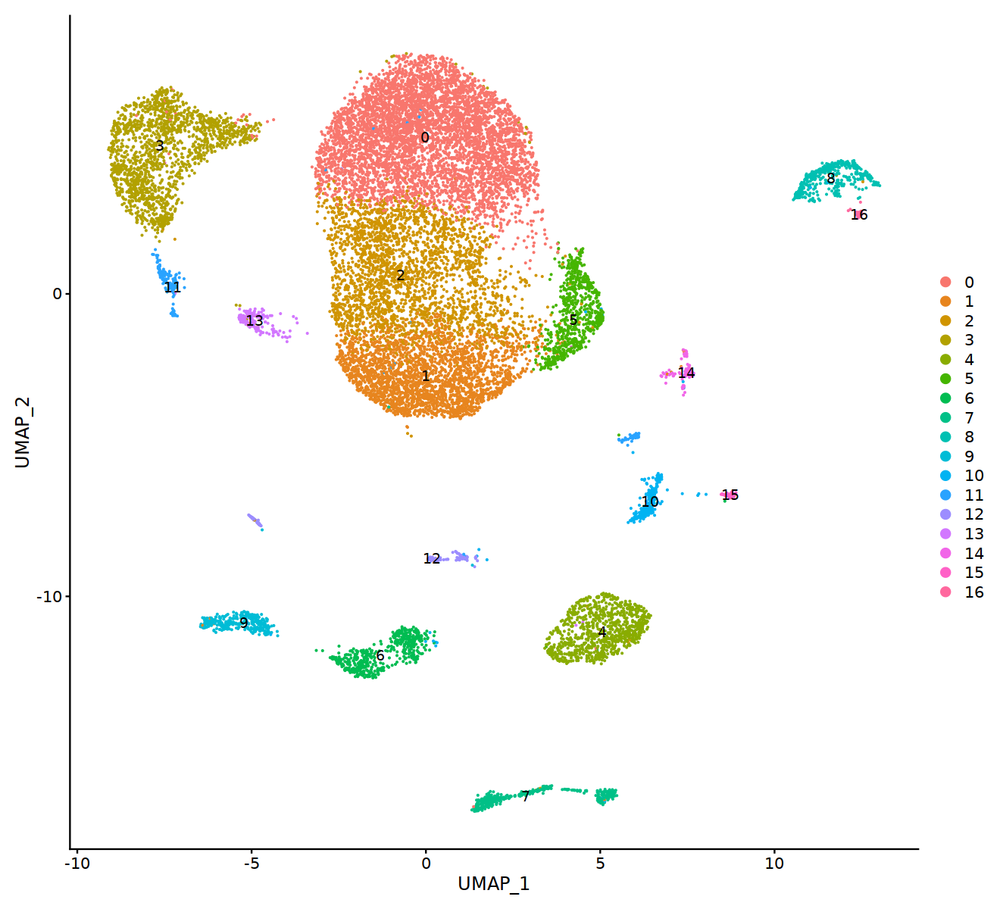

In [15]:
options(repr.plot.width=11, repr.plot.height=10)

seur_ni_n_ambfilt = subset(seur_ni_n, idents = c("PT_Gatm", "PT_Akr1c21", "PT_Kap"), invert = T)
seur_ni_n_ambfilt <- NormalizeData(seur_ni_n_ambfilt)
seur_ni_n_ambfilt <- FindVariableFeatures(seur_ni_n_ambfilt, selection.method = "vst",nfeatures = 3000)
seur_ni_n_ambfilt <- ScaleData(seur_ni_n_ambfilt, features = row.names(seur_ni_n_ambfilt))
seur_ni_n_ambfilt <- RunPCA(seur_ni_n_ambfilt, npcs = 30,verbose = T)
seur_ni_n_ambfilt <- RunHarmony(seur_ni_n_ambfilt, group.by.vars = "Sex")
seur_ni_n_ambfilt <- RunUMAP(seur_ni_n_ambfilt, reduction = "harmony", dims = 1:30)
seur_ni_n_ambfilt <- FindNeighbors(seur_ni_n_ambfilt, reduction = "harmony", dims = 1:30)
seur_ni_n_ambfilt <- FindClusters(seur_ni_n_ambfilt, resolution = 0.3)
DimPlot(seur_ni_n_ambfilt, label = T)

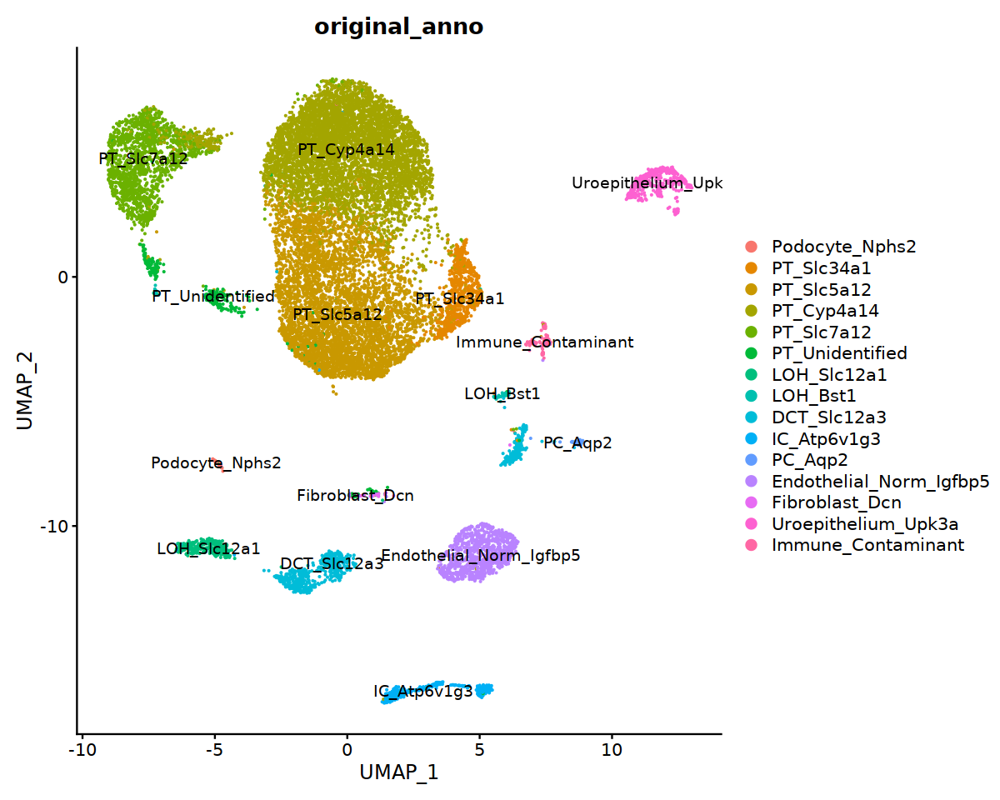

In [16]:
options(repr.plot.width=10, repr.plot.height=8)

DimPlot(seur_ni_n_ambfilt, label = T, group.by = "original_anno")

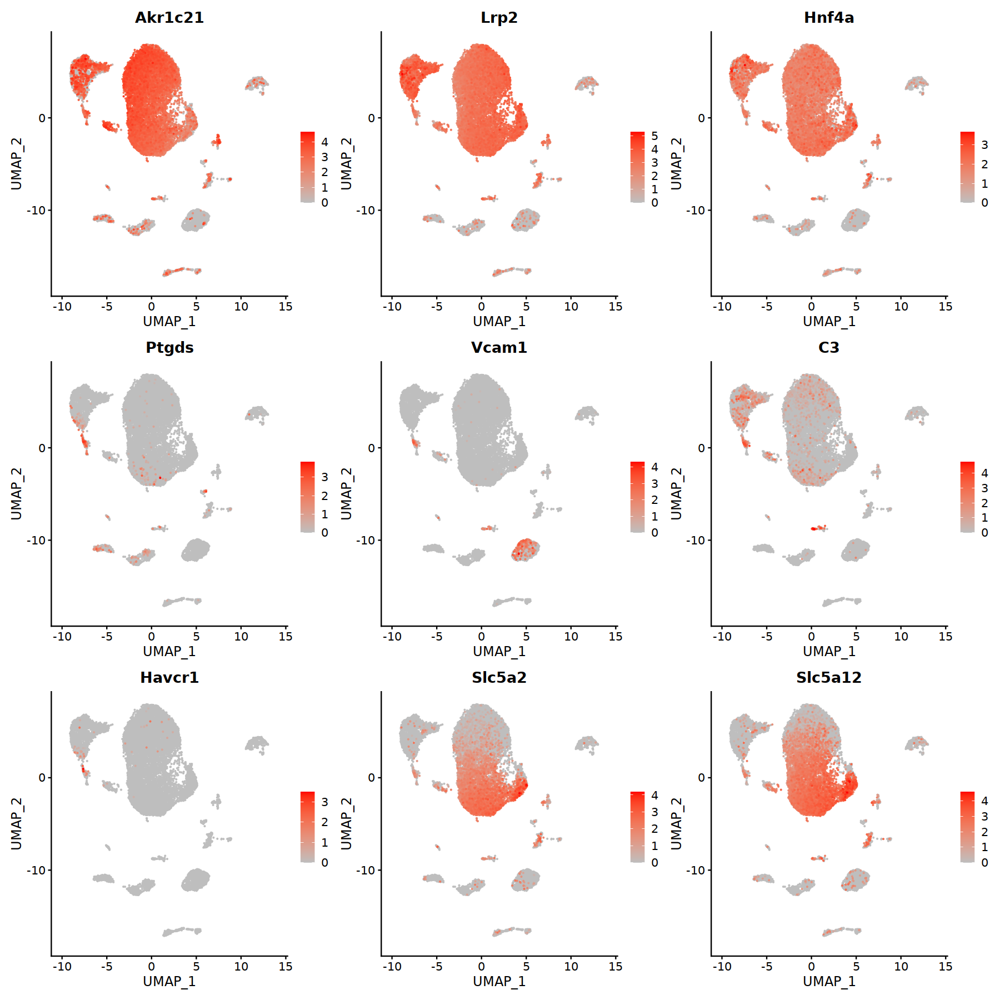

In [17]:
options(repr.plot.width=15, repr.plot.height=15)
FeaturePlot(seur_ni_n_ambfilt, c("Akr1c21","Lrp2","Hnf4a","Ptgds","Vcam1","C3","Havcr1","Slc5a2","Slc5a12"),order = T,cols = c("grey","red"))


In [18]:
saveRDS(seur_ni_n_ambfilt, file = "Manuscript_Objects/NonImmune_NormalKidney_AmbFilt_SeuratObject_Final.RDS")

In [19]:
seur_ni_n_ambfilt = readRDS("Manuscript_Objects/NonImmune_NormalKidney_AmbFilt_SeuratObject_Final.RDS")
Idents(seur_ni_n_ambfilt) = "seurat_clusters"

In [20]:
seur_ni_n_ambfilt.downsample <- subset(seur_ni_n_ambfilt, downsample = 1000)

markers.ambfilt <- FindAllMarkers(seur_ni_n_ambfilt.downsample, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Calculating cluster 16



In [21]:
saveRDS(markers.ambfilt, file = "Manuscript_Objects/NonImmune_NormalKidney_AmbFilt_Final_FindAllMarkers_LR_Sex.RDS")

In [22]:
markers.ambfilt = readRDS("Manuscript_Objects/NonImmune_NormalKidney_AmbFilt_Final_FindAllMarkers_LR_Sex.RDS")

Warning message:
"'add.ident' is a deprecated argument, please use the 'group.by' argument instead"
Centering and scaling data matrix



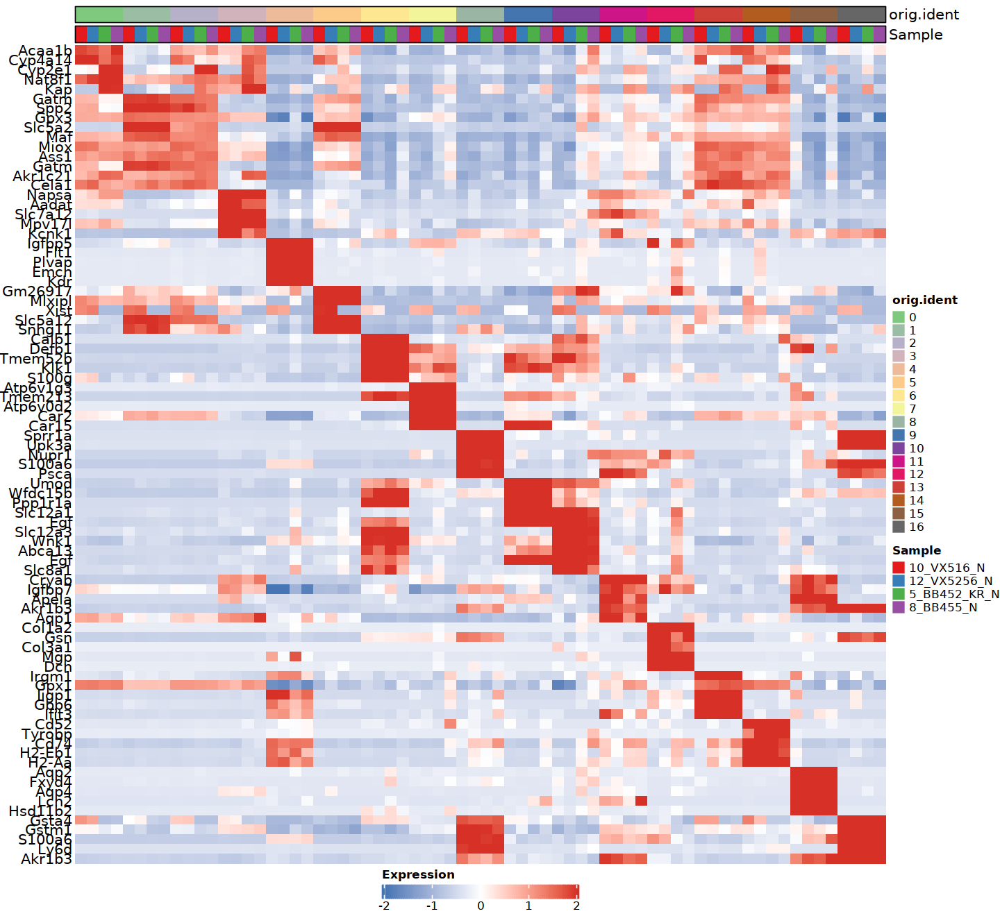

In [23]:
markers.ambfilt %>%
    group_by(cluster) %>%
    top_n(n = 5, wt = avg_log2FC) -> top5

DefaultAssay(seur_ni_n_ambfilt) = "RNA"
cluster.averages <- AverageExpression(seur_ni_n_ambfilt, return.seurat = TRUE, group.by = "seurat_clusters",add.ident = "Sample")
cluster_sample = strsplit(row.names(cluster.averages@meta.data),"_")
sample = lapply(cluster_sample, function(x) x[-1])
cluster.averages$Sample = unlist(lapply(sample, paste,collapse = "_"))
cluster.averages$orig.ident = factor(cluster.averages$orig.ident, levels = c(0:length(unique(cluster.averages$orig.ident))))
                
options(repr.plot.width=12, repr.plot.height=11)

colors <- list(colorRampPalette(brewer.pal(8, "Accent"))(length(unique(cluster.averages$orig.ident))),brewer.pal(4,"Set1"))

DefaultAssay(cluster.averages) = "RNA"
plot_heatmap(dataset = cluster.averages, 
              markers = top5$gene,
              sort_var = c("orig.ident","Sample"),
              anno_var = c("orig.ident","Sample"),
              anno_colors = colors)


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



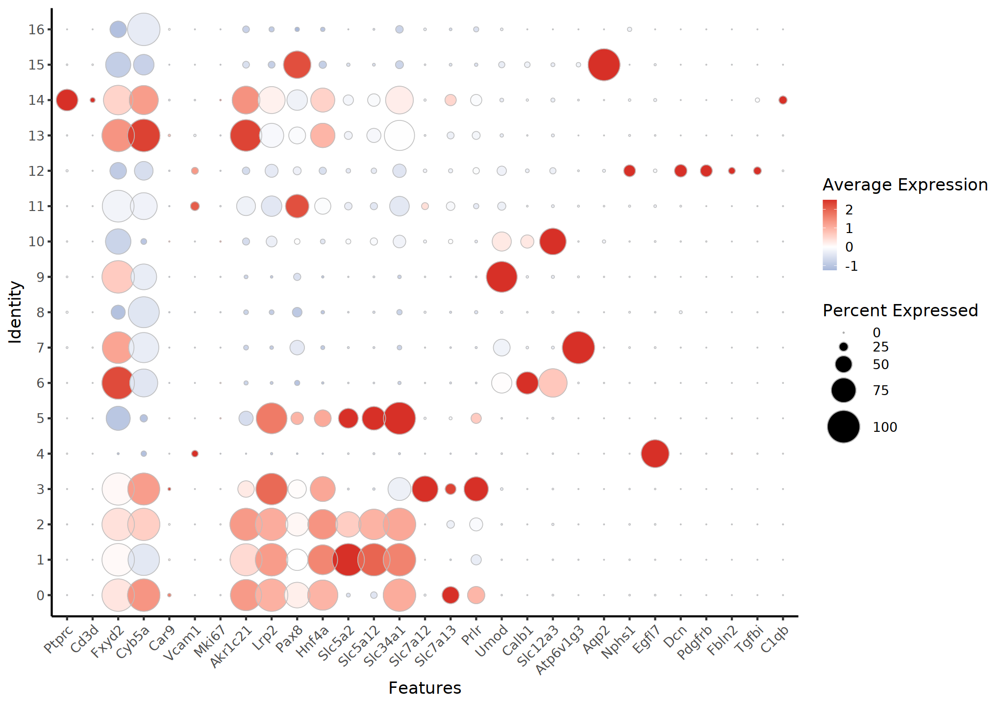

In [24]:
options(repr.plot.width=17, repr.plot.height=12)

DotPlot(seur_ni_n_ambfilt, features = c("Ptprc","Cd3d","Fxyd2","Cyb5a","Car9","Vcam1","Mki67","Akr1c21","Lrp2","Pax8","Hnf4a","Slc5a2","Slc5a12","Slc34a1","Slc7a12","Slc7a13","Prlr","Umod","Calb1","Slc12a3","Atp6v1g3","Aqp2","Nphs1","Egfl7","Dcn","Pdgfrb","Fbln2","Tgfbi","C1qb"),assay = "RNA",dot.scale = 18, cols = c("white","red")) + theme_classic(base_size = 20) +
geom_point(aes(size = pct.exp),shape = 21, color = "grey",stroke = 0.5) + 
scale_colour_gradient2(low = "#4575b4", mid = "white", high = "#d73027") +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))

In [25]:
#0 PT_S2_Cyp4a14
#1 PT_S1_Slc5a2
#2 PT_S1S2_Miox
#3 PT_S3_Slc7a12
#4 Endothelial_Norm_Igfbp5
#5 PT_S1_Slc34a1
#6 DCT_Calb1
#7 IC_Atp6v1g3
#8 Uroepithelium_Upk3a
#9 LOH_Slc12a1
#10 DCT_Slc12a3 
#11 PT_STC_Ptgds (subset)
#12 Fibroblast_Dcn (subset)
#13 PT_ISG_High_Ifit3
#14 Immune_Contaminant
#15 PC_Aqp2
#16 Uroepithelium_Krt19

In [26]:
subset(markers.ambfilt, cluster == 0 & p_val_adj < 0.001) %>% arrange(desc(avg_log2FC))

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Kap,1.381467e-200,2.527426,0.522,0.319,3.297700e-196,0,Kap
Acaa1b,0.000000e+00,1.848824,0.996,0.455,0.000000e+00,0,Acaa1b
Cyp4a14,0.000000e+00,1.816545,0.937,0.208,0.000000e+00,0,Cyp4a14
Cyp2e1,0.000000e+00,1.747507,0.685,0.160,0.000000e+00,0,Cyp2e1
Nat8f1,0.000000e+00,1.726401,0.996,0.480,0.000000e+00,0,Nat8f1
Slc22a6,0.000000e+00,1.717937,0.991,0.326,0.000000e+00,0,Slc22a6
Cyp4b1,5.157392e-237,1.699833,0.876,0.409,1.231121e-232,0,Cyp4b1
Slc7a13,2.630009e-192,1.594575,0.487,0.109,6.278094e-188,0,Slc7a13
Gpx1,0.000000e+00,1.550836,1.000,0.703,0.000000e+00,0,Gpx1


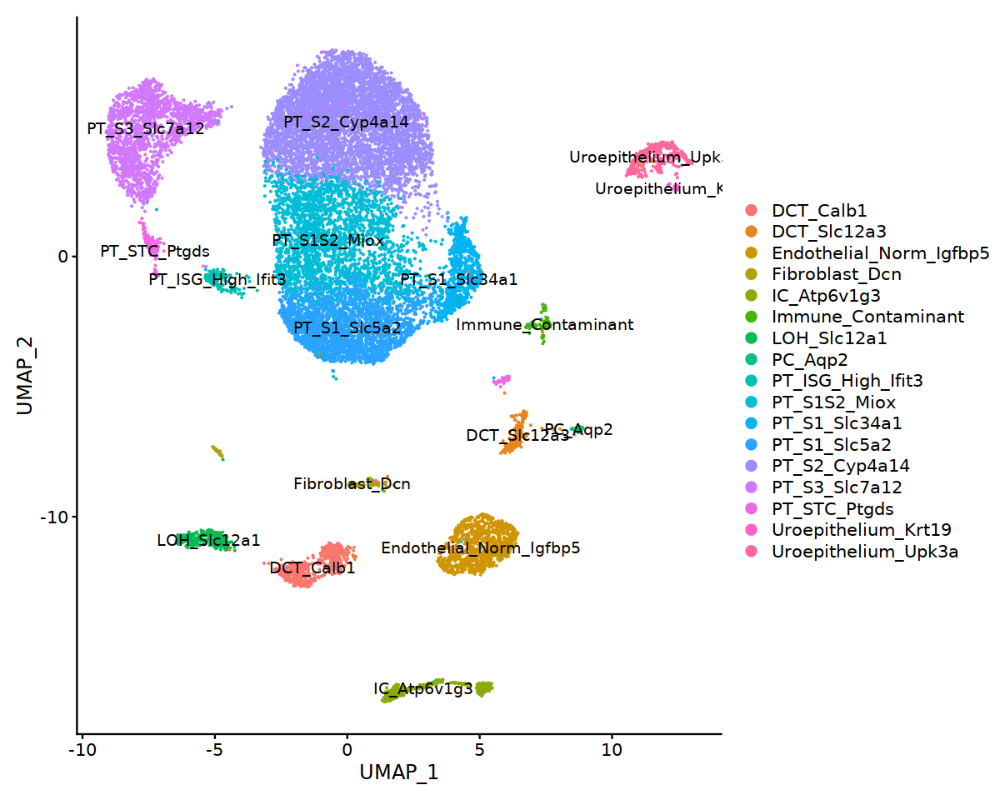

In [27]:
#0 PT_S2_Cyp4a14
#1 PT_S1_Slc5a2
#2 PT_S1S2_Miox
#3 PT_S3_Slc7a12
#4 Endothelial_Norm_Igfbp5
#5 PT_S1_Slc34a1
#6 DCT_Calb1
#7 IC_Atp6v1g3
#8 Uroepithelium_Upk3a
#9 LOH_Slc12a1
#10 DCT_Slc12a3
#11 PT_STC_Ptgds (subset)
#12 Fibroblast_Dcn (subset)
#13 PT_ISG_High_Ifit3
#14 Immune_Contaminant
#15 PC_Aqp2
#16 Uroepithelium_Krt19

Idents(seur_ni_n_ambfilt) = "seurat_clusters"

new.cluster.ids = c("PT_S2_Cyp4a14","PT_S1_Slc5a2","PT_S1S2_Miox","PT_S3_Slc7a12","Endothelial_Norm_Igfbp5","PT_S1_Slc34a1","DCT_Calb1","IC_Atp6v1g3","Uroepithelium_Upk3a","LOH_Slc12a1","DCT_Slc12a3","PT_STC_Ptgds","Fibroblast_Dcn","PT_ISG_High_Ifit3","Immune_Contaminant","PC_Aqp2","Uroepithelium_Krt19")
names(new.cluster.ids) = levels(seur_ni_n_ambfilt)
seur_ni_n_ambfilt = RenameIdents(seur_ni_n_ambfilt, new.cluster.ids)

Idents(seur_ni_n_ambfilt) = factor(Idents(seur_ni_n_ambfilt), levels = sort(unique(as.character(Idents(seur_ni_n_ambfilt)))) )

options(repr.plot.width=10, repr.plot.height=8)
DimPlot(seur_ni_n_ambfilt, label = T)

### 8. Subset, reproject, and recluster clusters with additional spatial heterogeneity. Then map true identities back to complete object.

Centering and scaling data matrix

PC_ 1 
Positive:  Aldob, Spink1, Gpx3, Gpx1, Rida, Ndrg1, Dbi, Sult1d1, Slc4a4, Glyat 
	   Ftl1, Selenop, Cyp2j5, Lrp2, Pdzk1, Cltrn, Ttc36, Sord, Slc34a1, Slc27a2 
	   Cyba, Cat, Fmo1, Fbp1, Ass1, Gstm5, Akr1c21, Khk, Akr1a1, Pter 
Negative:  Mal, Epcam, Proser2, Cldn19, Tacstd2, Akr1b3, Thbs1, Plet1, Nfat5, S100a6 
	   Nupr1, Col4a3, Cd24a, Col4a5, Krt18, Dnm3, Upk3b, Spon1, Hacd4, Utrn 
	   Bcam, Tmem30b, Gls, Timp2, Krt7, Sptssb, Apela, Atp10b, Cgnl1, Cd59a 
PC_ 2 
Positive:  Miox, Gsta2, Gsta3, Nme2, Prdx5, Akr1a1, Cyb5a, Idh1, Ftl1, Akr1c21 
	   Gpx1, Car2, Ech1, Bex4, Fth1, Npl, Akr7a5, Ddt, Ldhb, Acaa2 
	   Ethe1, Gcdh, Fbp1, Smim22, Pah, Palld, Aldob, Gcat, Selenbp1, Dbi 
Negative:  Slc6a6, Gramd1b, Itga1, Npnt, Cp, Slc23a1, Sema5a, Klf4, Col4a1, Kcnk1 
	   Mettl7a2, Timp3, Slc7a12, Plau, Ppic, Aqp1, Itgav, Snhg11, Slc4a11, Kcnq1ot1 
	   Clec2d, Napsa, Fzd4, Ctsh, Serpina1f, Serpina10, Neat1, Arg2, Slc6a18, Cers6 
PC_ 3 
Positive:  Cldn10, Ne

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 229
Number of edges: 6563

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8333
Number of communities: 3
Elapsed time: 0 seconds


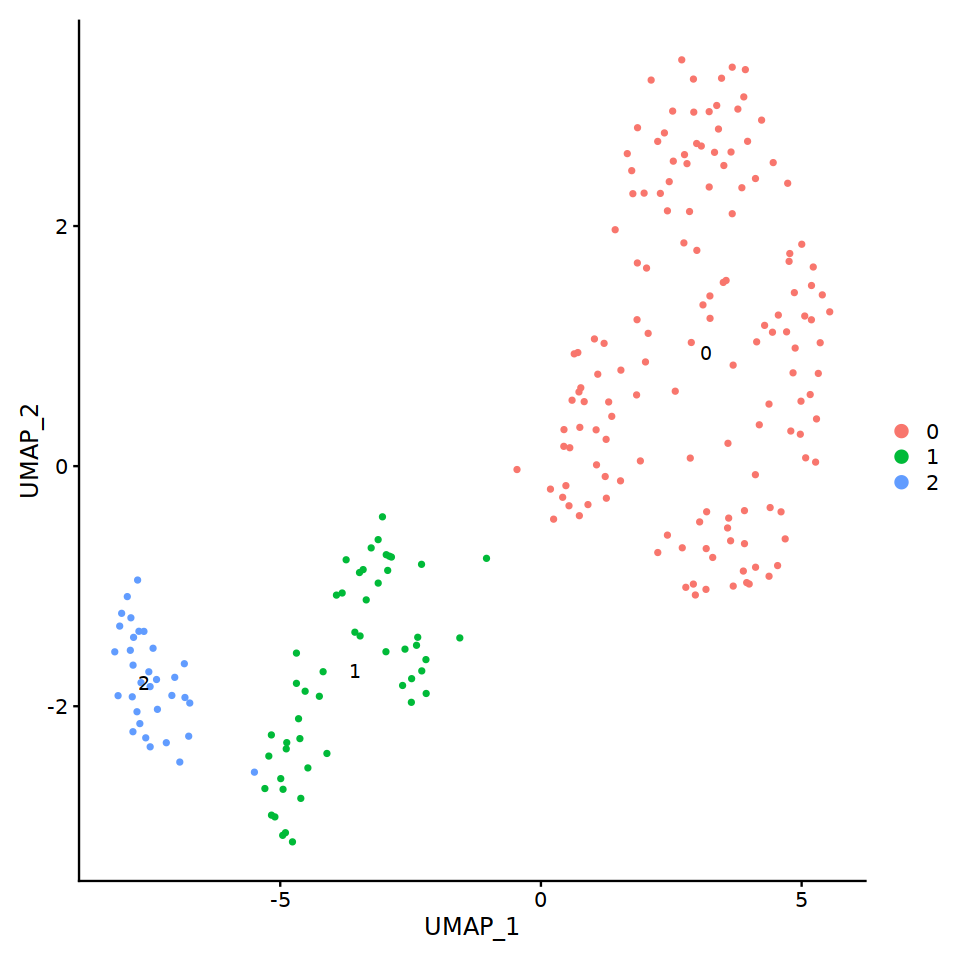

In [28]:
options(repr.plot.width=8, repr.plot.height=8)
seur_stc = subset(seur_ni_n_ambfilt, idents = "PT_STC_Ptgds")
seur_stc = NormalizeData(seur_stc)
seur_stc = FindVariableFeatures(seur_stc, selection.method = "vst",nfeatures = 3000)
seur_stc = ScaleData(seur_stc, features = row.names(seur_stc))
seur_stc = RunPCA(seur_stc, npcs = 20,verbose = T)
seur_stc = RunHarmony(seur_stc, group.by.vars = "Sex")
seur_stc = RunUMAP(seur_stc, reduction = "harmony", dims = 1:20)
seur_stc = FindNeighbors(seur_stc, reduction = "harmony", dims = 1:20)
seur_stc = FindClusters(seur_stc, resolution = 0.3)
DimPlot(seur_stc, label = T)

In [29]:
markers_stc <- FindAllMarkers(seur_stc, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")
markers_stc %>% group_by(cluster) %>% top_n(n = 10, wt = avg_log2FC)

Calculating cluster 0

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numer

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
1.765569e-44,3.723701,0.979,0.214,4.214590e-40,0,Spink1
3.530705e-44,2.997482,0.993,0.393,8.428146e-40,0,Rida
1.924835e-42,3.587049,0.986,0.238,4.594773e-38,0,Aldob
2.071588e-41,3.633325,1.000,0.488,4.945089e-37,0,Gpx3
3.092047e-40,3.052946,0.959,0.214,7.381026e-36,0,Ndrg1
1.031746e-39,2.852176,0.993,0.524,2.462881e-35,0,Dbi
3.845199e-39,3.403843,0.986,0.321,9.178874e-35,0,Gpx1
2.160148e-27,2.897850,0.676,0.000,5.156488e-23,0,C3
3.062413e-26,2.855293,0.828,0.143,7.310285e-22,0,Gsta2


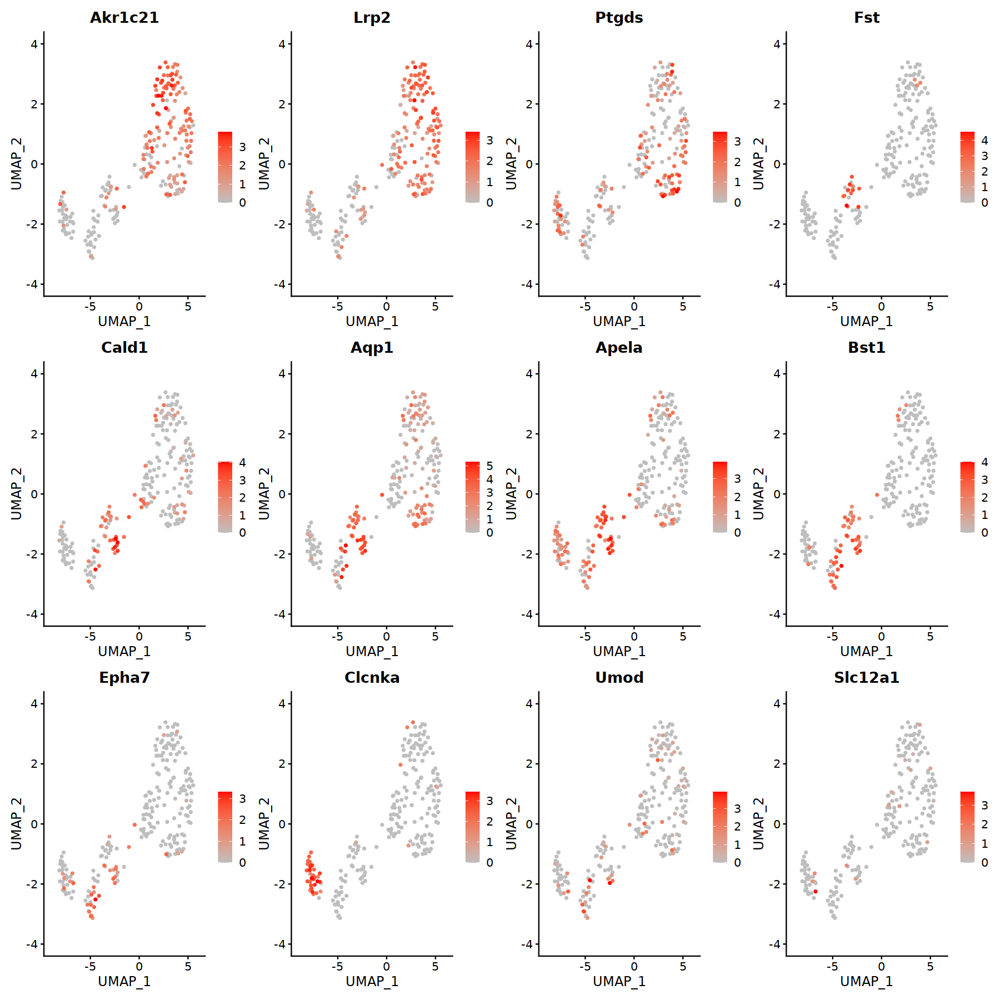

In [30]:
options(repr.plot.width=15, repr.plot.height=15)
FeaturePlot(seur_stc, c("Akr1c21","Lrp2","Ptgds","Fst","Cald1","Aqp1","Apela","Bst1","Epha7","Clcnka","Umod","Slc12a1"),order = T,cols = c("grey","red"))


In [31]:
#0 PT_STC_Ptgds
#1 LOH_Bst1
#2 LOH_Clcnka

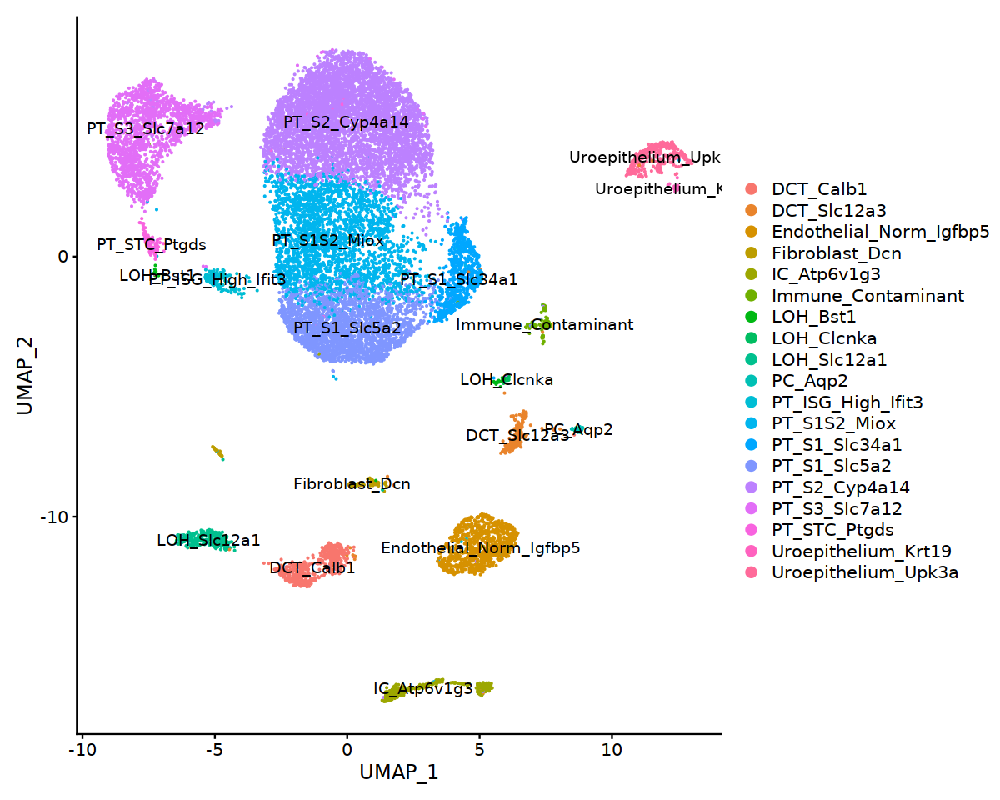

In [32]:
#0 PT_STC_Ptgds
#1 LOH_Bst1
#2 LOH_Clcnka

seur_ni_n_ambfilt = SetIdent(seur_ni_n_ambfilt, cells = row.names(subset(seur_stc@meta.data, seurat_clusters == 0)),value = "PT_STC_Ptgds")
seur_ni_n_ambfilt = SetIdent(seur_ni_n_ambfilt, cells = row.names(subset(seur_stc@meta.data, seurat_clusters == 1)),value = "LOH_Bst1")
seur_ni_n_ambfilt = SetIdent(seur_ni_n_ambfilt, cells = row.names(subset(seur_stc@meta.data, seurat_clusters == 2)),value = "LOH_Clcnka")

Idents(seur_ni_n_ambfilt) = factor(Idents(seur_ni_n_ambfilt), levels = sort(unique(as.character(Idents(seur_ni_n_ambfilt)))) )

options(repr.plot.width=10, repr.plot.height=8)
DimPlot(seur_ni_n_ambfilt, label = T)

Centering and scaling data matrix

PC_ 1 
Positive:  Sord, Slc27a2, Aldob, Miox, Fxyd2, Pecr, Ass1, Pdzk1, Keg1, Pck1 
	   Spink1, Slc22a12, Guca2b, Fbp1, Ttc36, Rida, 4931406C07Rik, Slc17a3, Stard10, Cda 
	   Lrp2, Acaa1b, Calml4, Glyat, Ehhadh, Nat8f1, Slc17a1, Fut9, Hgd, Akr1c21 
Negative:  Col1a2, Gsn, Igfbp6, Gpc3, Prrx1, Clec3b, Mfap5, Serpinh1, Pcolce, Col6a1 
	   Ogn, Dcn, Fndc1, Lrp1, S100a6, Col3a1, Fstl1, Serping1, Fbn1, Pcolce2 
	   Col1a1, Scara5, Col14a1, Pi16, Thbd, Antxr1, Lum, Nid1, Cd55, Htra3 
PC_ 2 
Positive:  Dcn, Col3a1, Col1a1, Serping1, Clec3b, Ogn, Marcks, C1s1, Mfap5, Pcolce2 
	   Col14a1, Prrx1, Lum, S100a6, Col6a1, Serpinf1, Ebf1, Igfbp6, Pdgfra, Ifitm3 
	   C3, Rnase4, Tnxb, Scara5, Lrp1, Ly6a, Cd34, Nid1, Xdh, Cd248 
Negative:  Podxl, Nphs1, Nphs2, Enpep, Cldn5, Sema3g, Wt1, Mafb, H2-Q7, Ptpro 
	   Cd59a, Clic5, Tmem150c, Clic3, Sdc4, Aplp1, Tm4sf1, Fgfbp1, Rab3b, Mgat5 
	   Npnt, Pak1, H2-Q6, Thsd7a, Rhpn1, Ripor1, Nebl, Npr3, Rasl11a, Cdkn1c 
PC_ 3 
Posi

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 163
Number of edges: 4218

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8000
Number of communities: 3
Elapsed time: 0 seconds


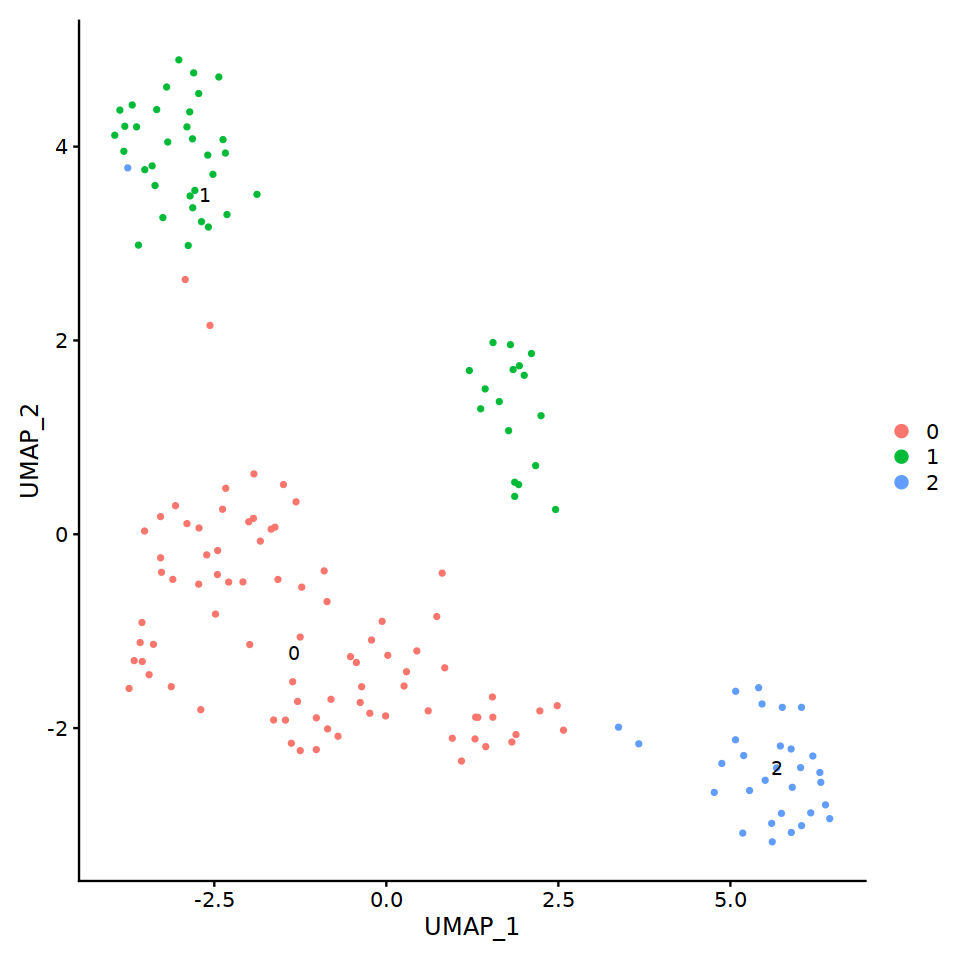

In [33]:
options(repr.plot.width=8, repr.plot.height=8)
seur_fib = subset(seur_ni_n_ambfilt, idents = "Fibroblast_Dcn")
seur_fib <- NormalizeData(seur_fib)
seur_fib <- FindVariableFeatures(seur_fib, selection.method = "vst",nfeatures = 3000)
seur_fib <- ScaleData(seur_fib, features = row.names(seur_fib))
seur_fib <- RunPCA(seur_fib, npcs = 20,verbose = T)
seur_fib <- RunHarmony(seur_fib, group.by.vars = "Sex")
seur_fib <- RunUMAP(seur_fib, reduction = "harmony", dims = 1:20)
seur_fib <- FindNeighbors(seur_fib, reduction = "harmony", dims = 1:20)
seur_fib <- FindClusters(seur_fib, resolution = 0.3)
DimPlot(seur_fib, label = T)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 163
Number of edges: 4218

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.5972
Number of communities: 5
Elapsed time: 0 seconds


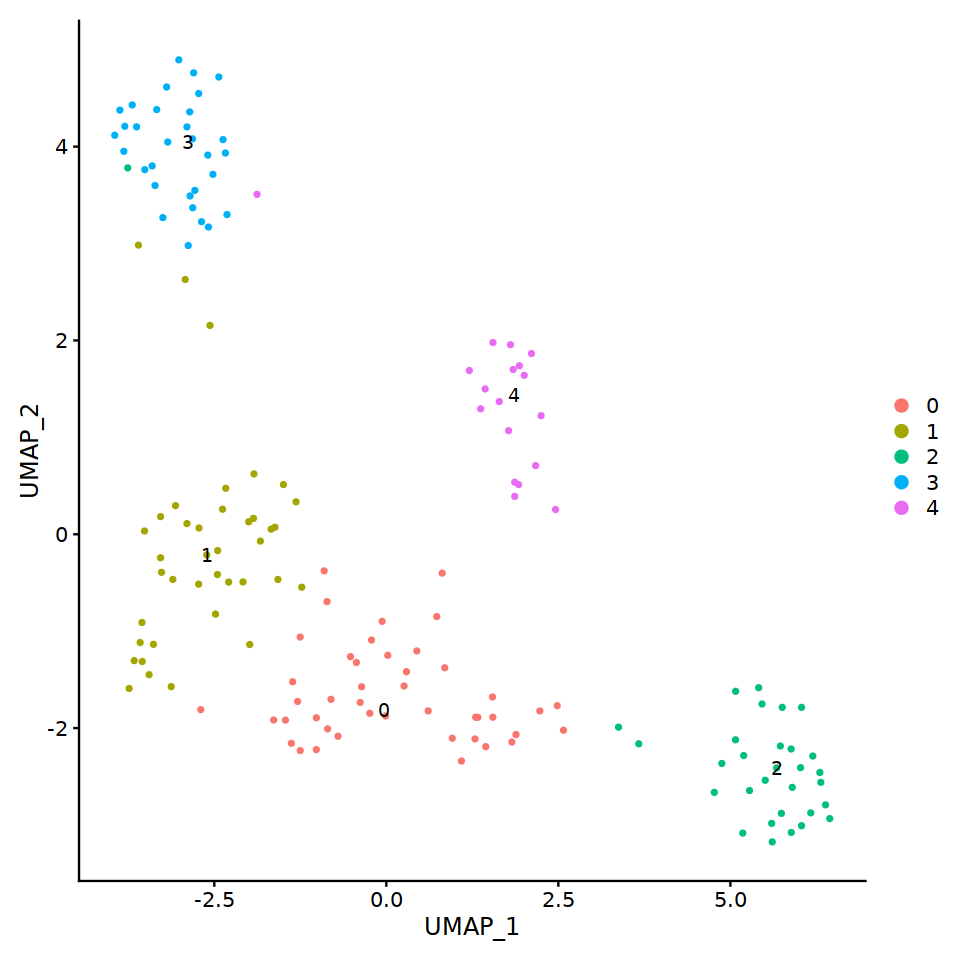

In [34]:
seur_fib <- FindClusters(seur_fib, resolution = 1)
DimPlot(seur_fib, label = T)

In [35]:
markers_fib <- FindAllMarkers(seur_fib, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")
markers_fib %>% group_by(cluster) %>% top_n(n = 10, wt = avg_log2FC)

Calculating cluster 0

Calculating cluster 1

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Calculating cluster 2

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Calculating cluster 3

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
8.197211e-06,2.080866,0.795,0.630,1.956756e-01,0,Kcnq1ot1
1.956499e-05,1.953130,0.818,0.630,4.670359e-01,0,Macf1
2.493251e-05,1.974203,0.341,0.034,5.951641e-01,0,Myo1b
8.658012e-05,1.871975,0.591,0.429,1.000000e+00,0,Nfat5
1.879723e-04,1.995002,0.614,0.546,1.000000e+00,0,Zeb2
3.243411e-04,1.820567,0.318,0.269,1.000000e+00,0,Mir100hg
4.374640e-04,2.062806,0.455,0.319,1.000000e+00,0,Raph1
1.064598e-03,2.020783,0.386,0.168,1.000000e+00,0,Pear1
4.249356e-03,1.756772,0.295,0.134,1.000000e+00,0,Adamts9


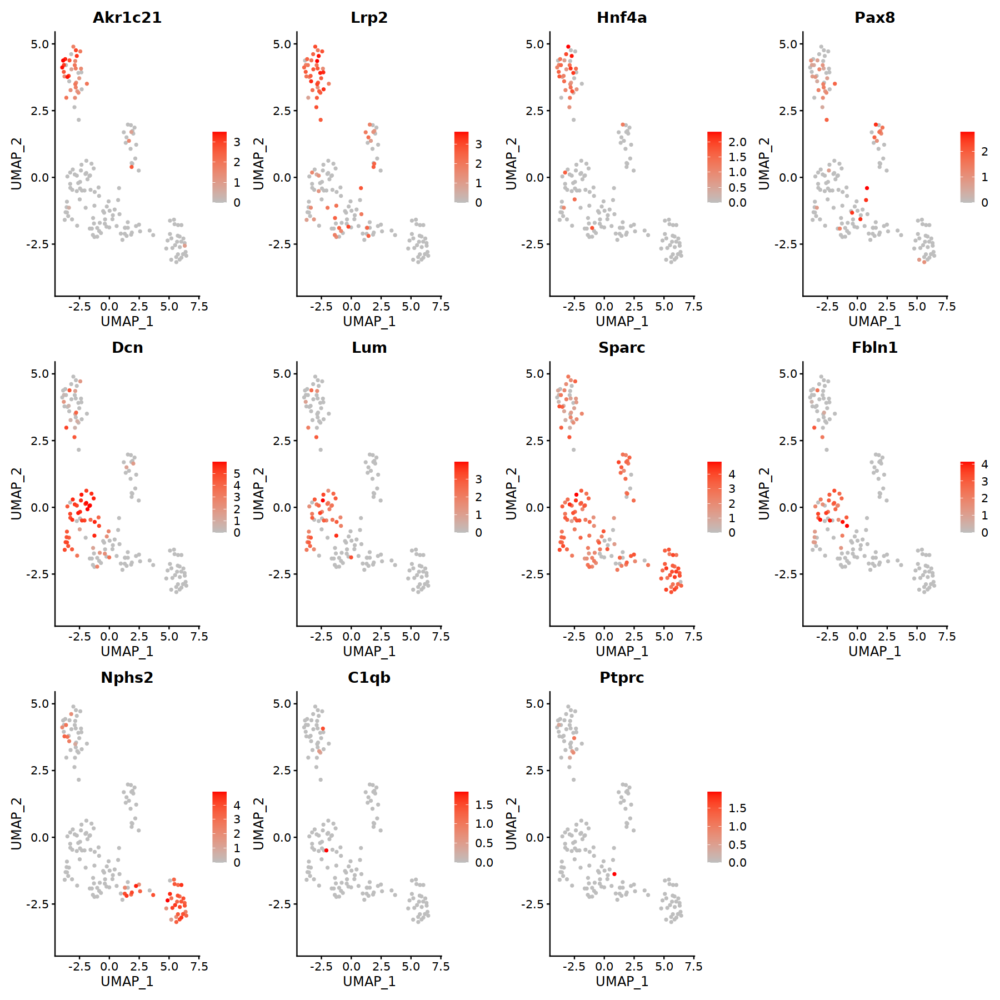

In [36]:
options(repr.plot.width=15, repr.plot.height=15)
FeaturePlot(seur_fib, c("Akr1c21","Lrp2","Hnf4a","Pax8","Dcn","Lum","Sparc","Fbln1","Nphs2","C1qb","Ptprc"),order = T, cols = c("grey","red"))


In [37]:
#0 Unidentified
#1 Fibroblast_Dcn
#2 Podocyte_Nphs2
#3 Unidentified_PT
#4 Parietal

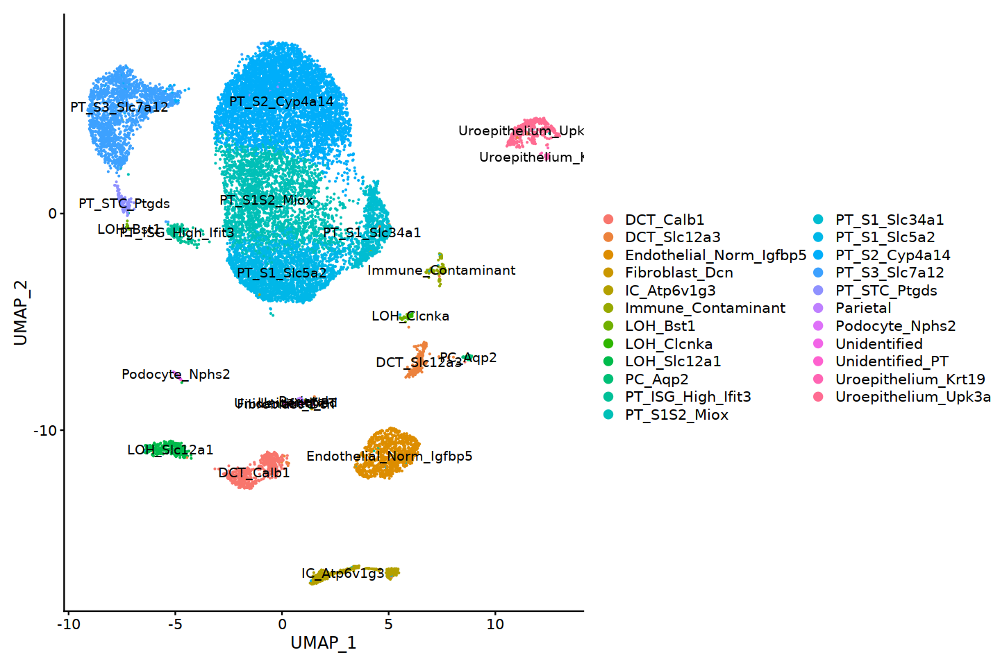

In [38]:
#0 Unidentified
#1 Fibroblast_Dcn
#2 Podocyte_Nphs2
#3 Unidentified_PT
#4 Parietal

seur_ni_n_ambfilt = SetIdent(seur_ni_n_ambfilt, cells = row.names(subset(seur_fib@meta.data, seurat_clusters == 0)),value = "Unidentified")
seur_ni_n_ambfilt = SetIdent(seur_ni_n_ambfilt, cells = row.names(subset(seur_fib@meta.data, seurat_clusters == 1)),value = "Fibroblast_Dcn")
seur_ni_n_ambfilt = SetIdent(seur_ni_n_ambfilt, cells = row.names(subset(seur_fib@meta.data, seurat_clusters == 2)),value = "Podocyte_Nphs2")
seur_ni_n_ambfilt = SetIdent(seur_ni_n_ambfilt, cells = row.names(subset(seur_fib@meta.data, seurat_clusters == 3)),value = "Unidentified_PT")
seur_ni_n_ambfilt = SetIdent(seur_ni_n_ambfilt, cells = row.names(subset(seur_fib@meta.data, seurat_clusters == 4)),value = "Parietal")

Idents(seur_ni_n_ambfilt) = factor(Idents(seur_ni_n_ambfilt), levels = sort(unique(as.character(Idents(seur_ni_n_ambfilt)))) )

options(repr.plot.width=12, repr.plot.height=8)
DimPlot(seur_ni_n_ambfilt, label = T)

In [39]:
table(Idents(seur_ni_n_ambfilt))


              DCT_Calb1             DCT_Slc12a3 Endothelial_Norm_Igfbp5 
                    519                     282                     905 
         Fibroblast_Dcn             IC_Atp6v1g3      Immune_Contaminant 
                     39                     448                     126 
               LOH_Bst1              LOH_Clcnka             LOH_Slc12a1 
                     51                      33                     339 
                PC_Aqp2       PT_ISG_High_Ifit3            PT_S1S2_Miox 
                     55                     163                    2520 
          PT_S1_Slc34a1            PT_S1_Slc5a2           PT_S2_Cyp4a14 
                    744                    2574                    5479 
          PT_S3_Slc7a12            PT_STC_Ptgds                Parietal 
                   1666                     145                      18 
         Podocyte_Nphs2            Unidentified         Unidentified_PT 
                     31                      44   

In [40]:
ordered = c("DCT_Calb1","DCT_Slc12a3","Endothelial_Norm_Igfbp5","Fibroblast_Dcn","IC_Atp6v1g3","LOH_Bst1","LOH_Clcnka","LOH_Slc12a1","PC_Aqp2","PT_ISG_High_Ifit3","PT_STC_Ptgds","PT_S1S2_Miox","PT_S1_Slc34a1","PT_S1_Slc5a2","PT_S2_Cyp4a14","PT_S3_Slc7a12","Podocyte_Nphs2","Parietal","Uroepithelium_Krt19","Uroepithelium_Upk3a","Immune_Contaminant","Unidentified_PT","Unidentified")
Idents(seur_ni_n_ambfilt) = factor(Idents(seur_ni_n_ambfilt), levels = ordered)
table(Idents(seur_ni_n_ambfilt))


              DCT_Calb1             DCT_Slc12a3 Endothelial_Norm_Igfbp5 
                    519                     282                     905 
         Fibroblast_Dcn             IC_Atp6v1g3                LOH_Bst1 
                     39                     448                      51 
             LOH_Clcnka             LOH_Slc12a1                 PC_Aqp2 
                     33                     339                      55 
      PT_ISG_High_Ifit3            PT_STC_Ptgds            PT_S1S2_Miox 
                    163                     145                    2520 
          PT_S1_Slc34a1            PT_S1_Slc5a2           PT_S2_Cyp4a14 
                    744                    2574                    5479 
          PT_S3_Slc7a12          Podocyte_Nphs2                Parietal 
                   1666                      31                      18 
    Uroepithelium_Krt19     Uroepithelium_Upk3a      Immune_Contaminant 
                     39                     414   

In [42]:
n_colors = readRDS("Manuscript_Objects/NormalKidney_NonImmune_Colors.RDS")
n_colors = replace(n_colors, n_colors == "lightgrey","gray95")
n_colors_new = replace(n_colors, n_colors == "#ED0679","#f3bfd9")
n_colors_new["Parietal"] = "#dfc27d"
n_colors_new = n_colors_new[c("DCT_Calb1","DCT_Slc12a3","Endothelial_Norm_Igfbp5","Fibroblast_Dcn","IC_Atp6v1g3","LOH_Bst1","LOH_Clcnka","LOH_Slc12a1","PC_Aqp2","PT_ISG_High_Ifit3","PT_STC_Ptgds","PT_S1S2_Miox","PT_S1_Slc34a1","PT_S1_Slc5a2","PT_S2_Cyp4a14","PT_S3_Slc7a12","Podocyte_Nphs2","Parietal","Uroepithelium_Krt19","Uroepithelium_Upk3a","Immune_Contaminant","Unidentified_PT","Unidentified")]
n_colors_new

DCT_Calb1             DCT_Slc12a3 Endothelial_Norm_Igfbp5 
              "#7FC97F"               "#97BEA0"               "#B0B4C1" 
         Fibroblast_Dcn             IC_Atp6v1g3                LOH_Bst1 
              "#C8B1C7"               "#E1B8A8"               "#F9BF8A" 
             LOH_Clcnka             LOH_Slc12a1                 PC_Aqp2 
              "#FDD58C"               "#FEED93"               "#E8EE9B" 
      PT_ISG_High_Ifit3            PT_STC_Ptgds            PT_S1S2_Miox 
              "#9BB5A4"               "#4E7CAD"               "#6B4EA2" 
          PT_S1_Slc34a1            PT_S1_Slc5a2           PT_S2_Cyp4a14 
              "#B2258F"               "#f3bfd9"               "#DA2950" 
          PT_S3_Slc7a12          Podocyte_Nphs2                Parietal 
              "#C74C28"               "#AB5D28"               "#dfc27d" 
    Uroepithelium_Krt19     Uroepithelium_Upk3a      Immune_Contaminant 
              "#886147"               "#666666"                "gray95" 
        Unidentified_PT            Unidentified 
               "gray95"                "gray95"

In [43]:
exclude = c("Immune_Contaminant","Unidentified_PT","Unidentified")
allnames = names(table(Idents(seur_ni_n_ambfilt)))
final_levels = c(setdiff(allnames, exclude),exclude)
final_levels

[1] "DCT_Calb1"               "DCT_Slc12a3"            
 [3] "Endothelial_Norm_Igfbp5" "Fibroblast_Dcn"         
 [5] "IC_Atp6v1g3"             "LOH_Bst1"               
 [7] "LOH_Clcnka"              "LOH_Slc12a1"            
 [9] "PC_Aqp2"                 "PT_ISG_High_Ifit3"      
[11] "PT_STC_Ptgds"            "PT_S1S2_Miox"           
[13] "PT_S1_Slc34a1"           "PT_S1_Slc5a2"           
[15] "PT_S2_Cyp4a14"           "PT_S3_Slc7a12"          
[17] "Podocyte_Nphs2"          "Parietal"               
[19] "Uroepithelium_Krt19"     "Uroepithelium_Upk3a"    
[21] "Immune_Contaminant"      "Unidentified_PT"        
[23] "Unidentified"

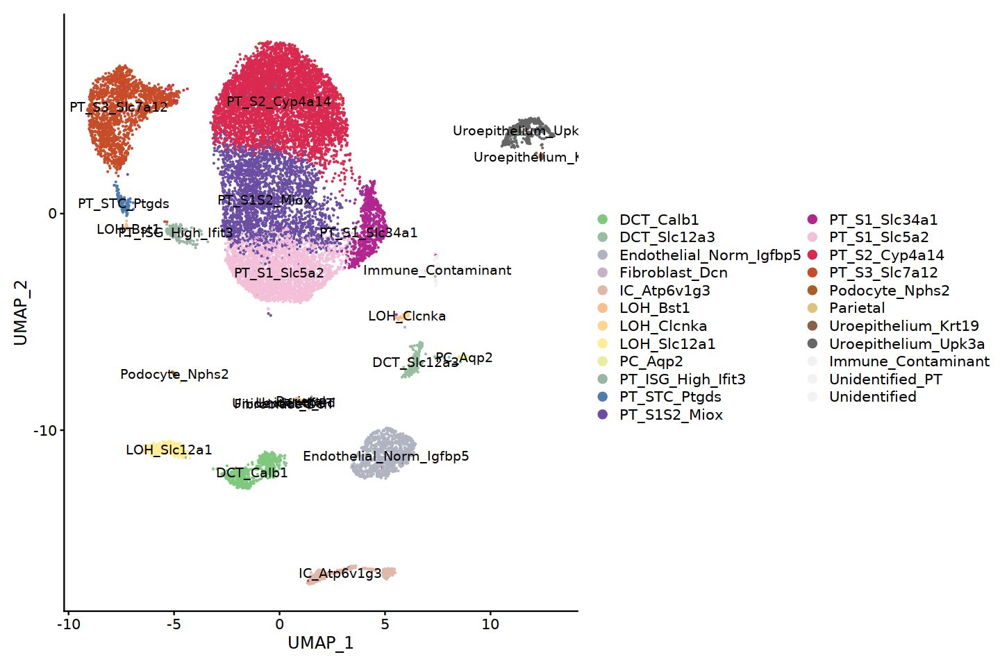

In [44]:
options(repr.plot.width=12, repr.plot.height=8)
Idents(seur_ni_n_ambfilt) = factor(Idents(seur_ni_n_ambfilt), levels = final_levels)
DimPlot(seur_ni_n_ambfilt, label = T, cols = n_colors_new[levels(Idents(seur_ni_n_ambfilt))])

In [45]:
seur_ni_n_ambfilt$Annot_Granular = Idents(seur_ni_n_ambfilt)

In [46]:
saveRDS(n_colors_new, file = "Manuscript_Objects/NormalKidney_NonImmune_Colors_Final.RDS")


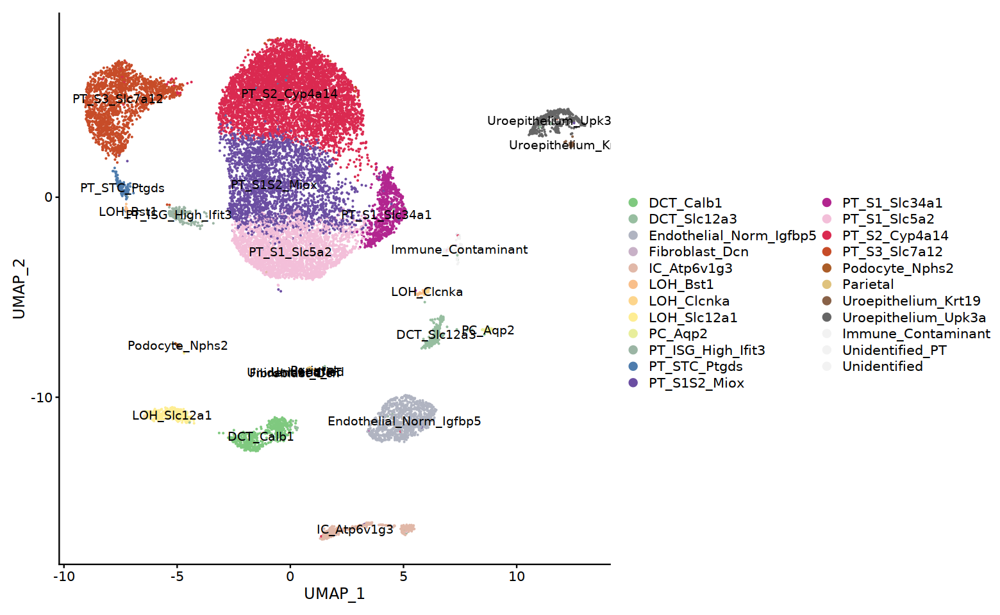

In [47]:
options(repr.plot.width=13, repr.plot.height=8)
DimPlot(seur_ni_n_ambfilt, label = T, cols = n_colors_new[as.character(levels(Idents(seur_ni_n_ambfilt)))])

ggsave("Manuscript_Figures/NormalKidney_NonImmune_AmbFilt_Final_UMAP_CellType.pdf", width = 10, height = 8)

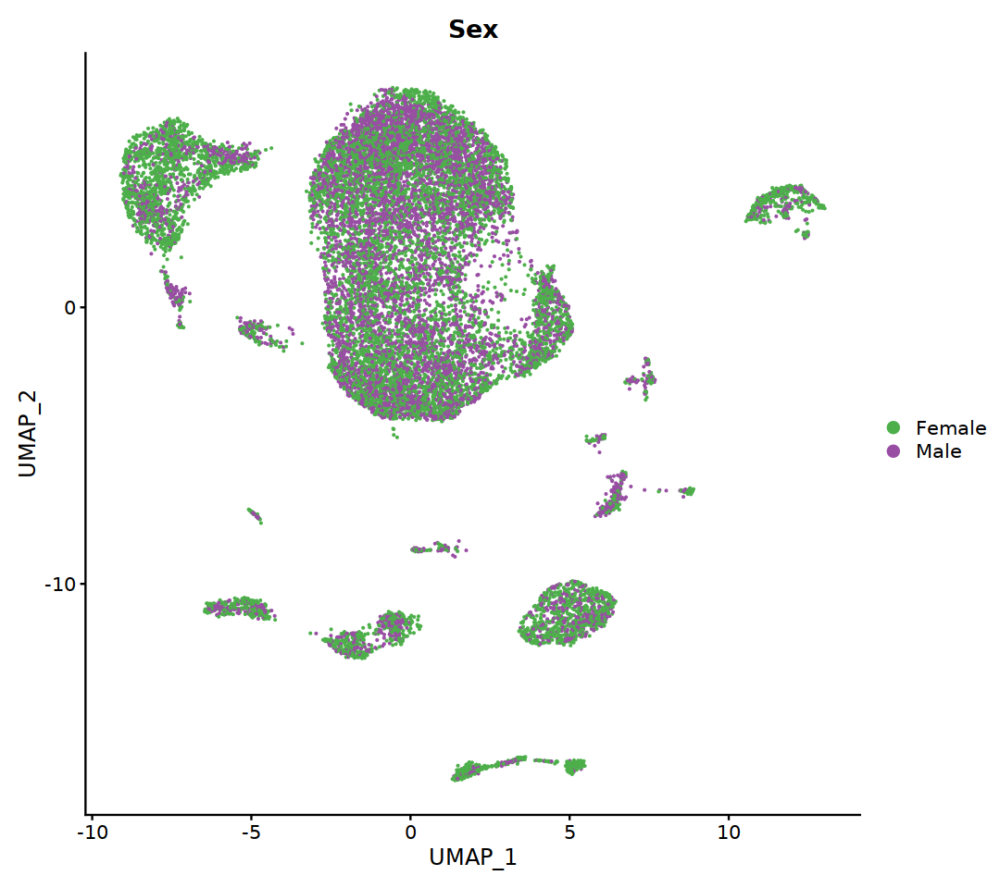

In [234]:
options(repr.plot.width=9, repr.plot.height=8)
DimPlot(seur_ni_n_ambfilt, group.by = "Sex", cols = c("#4daf4a","#984ea3"),shuffle = T)

ggsave("Manuscript_Figures/NormalKidney_NonImmune_AmbFilt_UMAP_Sex.pdf", width = 9, height = 8)

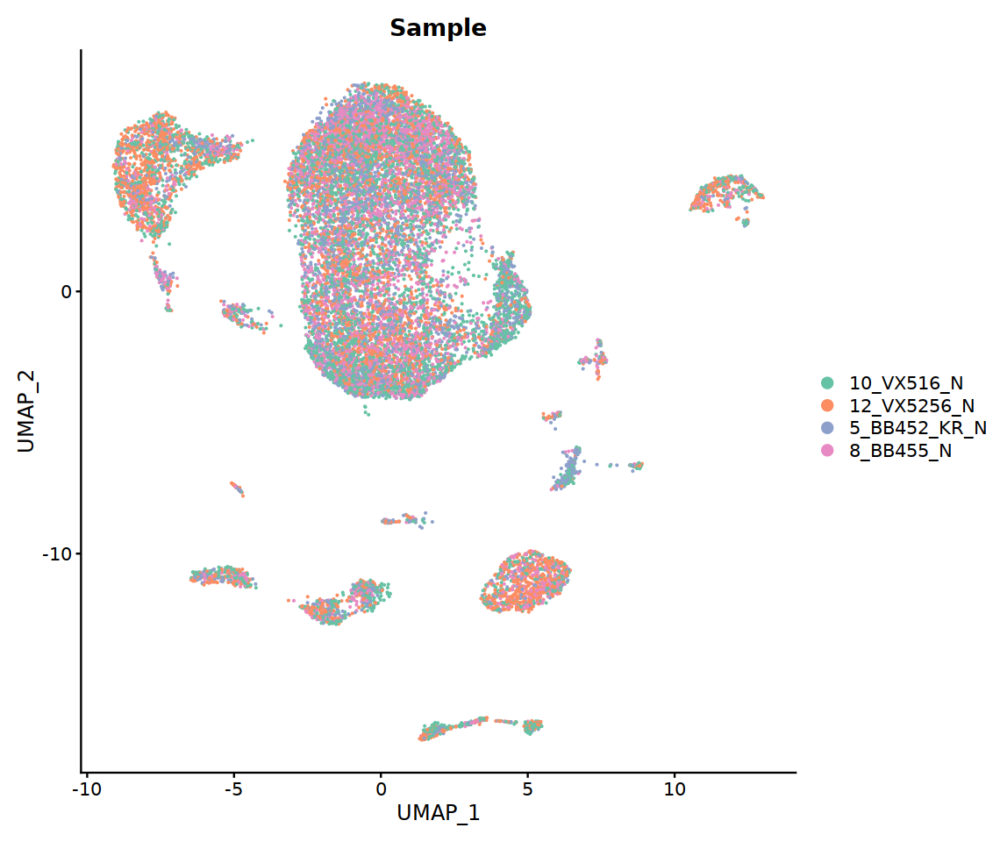

In [235]:
options(repr.plot.width=9.5, repr.plot.height=8)
DimPlot(seur_ni_n_ambfilt, group.by = "Sample", cols = brewer.pal(4, "Set2"),shuffle = T)

ggsave("Manuscript_Figures/NormalKidney_NonImmune_AmbFilt_UMAP_Sample.pdf", width = 9.5, height = 8)

In [48]:
seur_ni_n_ambfilt$Annot_Granular = Idents(seur_ni_n_ambfilt)

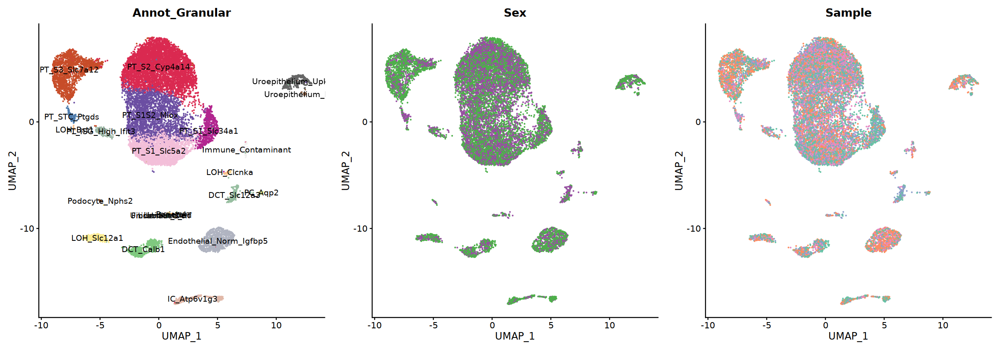

In [50]:
one = DimPlot(seur_ni_n_ambfilt, group.by = "Annot_Granular",label = T, cols = n_colors_new[as.character(levels(seur_ni_n_ambfilt$Annot_Granular))]) + NoLegend()
two = DimPlot(seur_ni_n_ambfilt, group.by = "Sex", cols = c("#4daf4a","#984ea3"),shuffle = T) + NoLegend()
three = DimPlot(seur_ni_n_ambfilt, group.by = "Sample", cols = brewer.pal(4, "Set2"),shuffle = T) + NoLegend()

library(ggpubr)
options(repr.plot.width=20, repr.plot.height=7)
ggarrange(one, two,three, nrow = 1)

ggsave("Manuscript_Figures/NormalKidney_NonImmune_AmbFilt_Final_Combined_CellType_Sex_Sample.pdf", width = 20, height = 7)

In [2]:
seur_ni_n_ambfilt = readRDS(file = "Manuscript_Objects/NonImmune_NormalKidney_AmbFilt_SeuratObject_Final.RDS")

,Var1,Var2,Freq
,<fct>,<fct>,<dbl>
1,10_VX516_N,DCT_Calb1,0.3314066
2,12_VX5256_N,DCT_Calb1,0.2832370
3,5_BB452_KR_N,DCT_Calb1,0.2119461
4,8_BB455_N,DCT_Calb1,0.1734104
5,10_VX516_N,DCT_Slc12a3,0.2943262


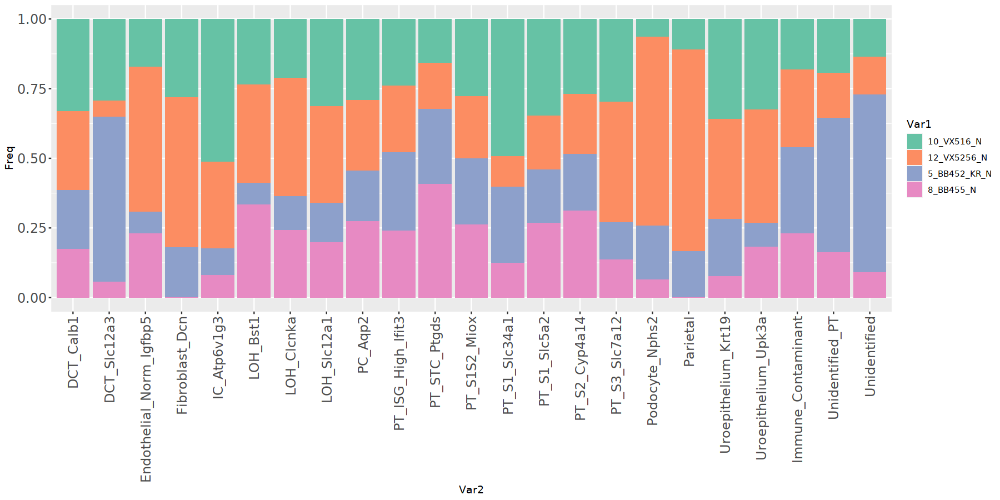

In [3]:
options(repr.plot.width=15, repr.plot.height=7.5)
props <- prop.table(table(seur_ni_n_ambfilt$Sample,Idents(seur_ni_n_ambfilt)), margin = 2)
props <- data.frame(props)
corner(props)
ggplot() + geom_bar(aes(y = Freq, x = Var2, fill = Var1), data = props, stat="identity") +theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1,size=14),
          axis.text.y = element_text(size=14)) + scale_fill_manual(values = brewer.pal(4, "Set2")) 


In [51]:
saveRDS(seur_ni_n_ambfilt, file = "Manuscript_Objects/NonImmune_NormalKidney_AmbFilt_SeuratObject_Final.RDS")

### 9. Subset, reproject, and recuster non-immune cells from tumor samples

In [2]:
seur = readRDS("Manuscript_Objects/NormalKidney_CrelessTumor_SeuratObject.RDS")

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



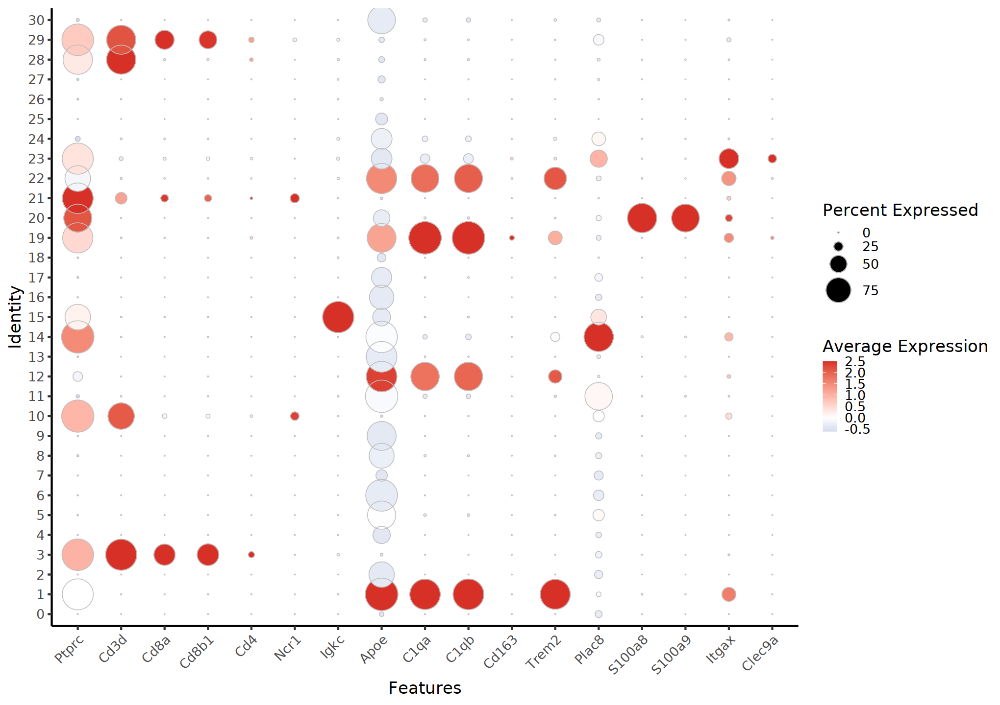

In [3]:
options(repr.plot.width=17, repr.plot.height=12)

DotPlot(seur, features = c("Ptprc","Cd3d","Cd8a","Cd8b1","Cd4","Ncr1","Igkc","Apoe","C1qa","C1qb","Cd163","Trem2","Plac8","S100a8","S100a9","Itgax","Clec9a"),assay = "RNA",dot.scale = 18, cols = c("white","red")) + theme_classic(base_size = 20) +
geom_point(aes(size = pct.exp),shape = 21, color = "grey",stroke = 0.5) + 
scale_colour_gradient2(low = "#4575b4", mid = "white", high = "#d73027") +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))

In [4]:
immune = c(1, 3, 10, 12, 14, 15,19,20,21,22,23,28,29)

Centering and scaling data matrix

PC_ 1 
Positive:  Fstl1, Dcn, Col3a1, Col1a2, Col14a1, Fbn1, Svep1, Islr, Loxl1, Mfap5 
	   Ifitm3, Col1a1, Bgn, Dpt, Serpinf1, Clec3b, Gpc3, Prrx1, Cd248, Ly6c1 
	   Gpx8, Igfbp6, Pi16, Ogn, Fxyd1, Slit3, Nid1, Prelp, Col5a2, Tnxb 
Negative:  Cryab, Gsta2, Aldob, Ugp2, Gstm1, Gpx3, Gc, Ptgds, Spink1, Fbp1 
	   Lrp2, Gsta1, Gatm, Dbi, Selenop, Ldhb, Gsta3, Mt1, Khk, Gsta4 
	   Tkfc, Apoc3, Afp, Pdzk1, Slc2a2, Slc13a1, Cpe, Sfn, Gclm, Slc6a18 
PC_ 2 
Positive:  Emcn, Plvap, Igfbp3, Pecam1, Cdh5, Egfl7, Kdr, Ptprb, Flt1, Adgrl4 
	   Gpihbp1, Cd93, Ednrb, Esm1, Podxl, Eng, Adgrf5, Cd300lg, Icam2, Tie1 
	   Rasip1, Cyyr1, Myct1, AU021092, S1pr1, Sema3f, Cd38, Fabp4, Sox18, Mmrn2 
Negative:  Dcn, Islr, Mfap5, Gpc3, Svep1, Ogn, Dpt, Serpinf1, Clec3b, Loxl1 
	   Fbn1, Igfbp6, Col14a1, Adgrd1, Col1a2, Prelp, Chrdl1, Fxyd1, Prrx1, Col3a1 
	   Cd248, Lox, Ccdc80, Lum, Efemp1, Col1a1, Mmp2, Tnxb, Ptgis, Pi16 
PC_ 3 
Positive:  Ndufa4, Dbi, Cstb, Atp5g1, Tmsb10, 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 13884
Number of edges: 483419

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9113
Number of communities: 12
Elapsed time: 2 seconds


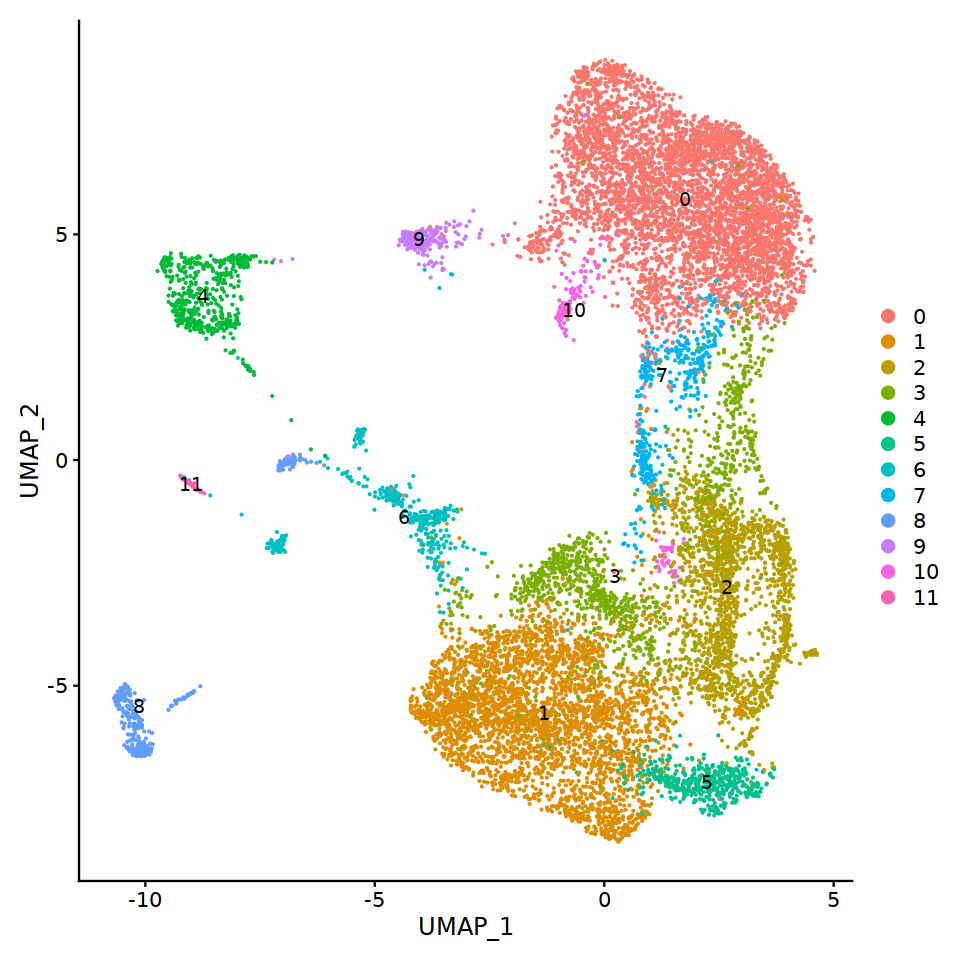

In [5]:
options(repr.plot.width=8, repr.plot.height=8)
seur$Annot1 = Idents(seur)
seur_ni_t = subset(seur, idents = immune, invert = T)
seur_ni_t = subset(seur_ni_t, subset = TumorNormal == "Tumor")
seur_ni_t <- NormalizeData(seur_ni_t)
seur_ni_t <- FindVariableFeatures(seur_ni_t, selection.method = "vst",nfeatures = 3000)
seur_ni_t <- ScaleData(seur_ni_t, features = row.names(seur_ni_t))
seur_ni_t <- RunPCA(seur_ni_t, npcs = 30,verbose = T)
seur_ni_t <- RunHarmony(seur_ni_t, group.by.vars = "Sex")
seur_ni_t <- RunUMAP(seur_ni_t, reduction = "harmony", dims = 1:30)
seur_ni_t <- FindNeighbors(seur_ni_t, reduction = "harmony", dims = 1:30)
seur_ni_t <- FindClusters(seur_ni_t, resolution = 0.3)
DimPlot(seur_ni_t, label = T)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 13884
Number of edges: 483419

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9564
Number of communities: 7
Elapsed time: 2 seconds


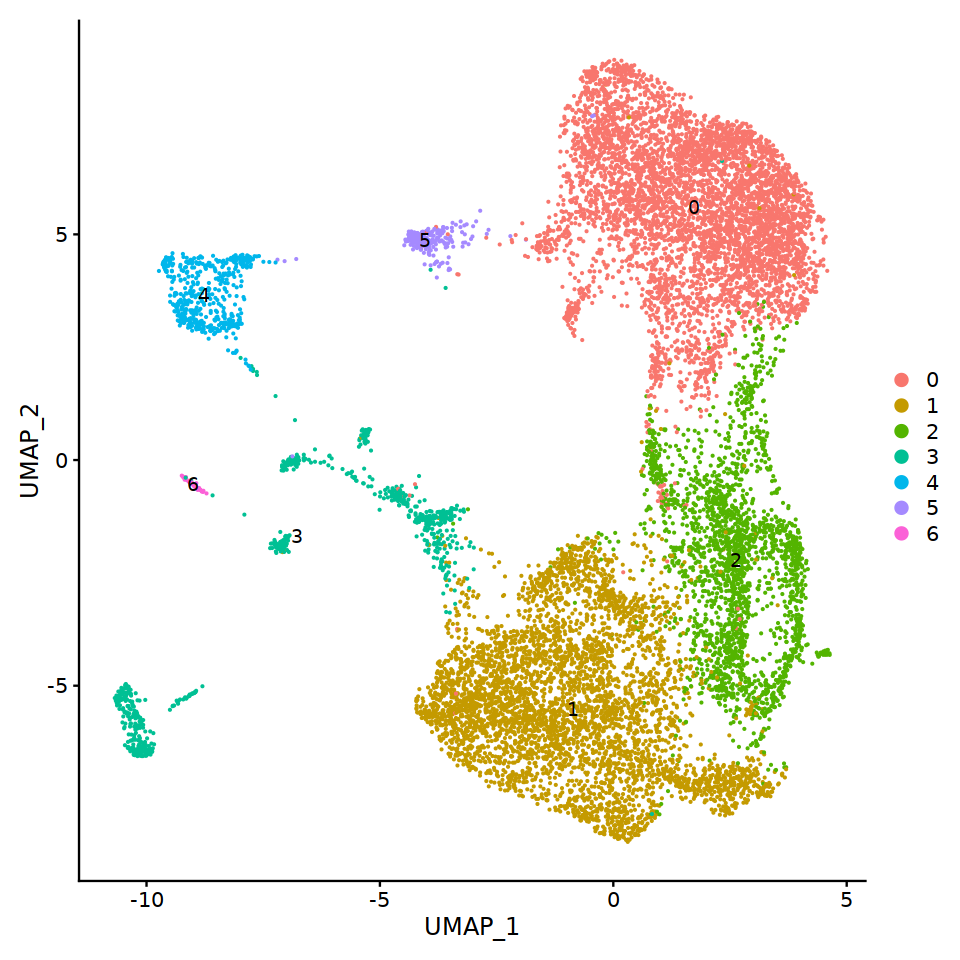

In [6]:
options(repr.plot.width=8, repr.plot.height=8)
seur_ni_t <- FindClusters(seur_ni_t, resolution = 0.1)
DimPlot(seur_ni_t, label = T)

In [10]:
seur_ni_t.downsample <- subset(seur_ni_t, downsample = 1000)

markers <- FindAllMarkers(seur_ni_t.downsample, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"


In [11]:
saveRDS(markers, file = "Manuscript_Objects/NonImmune_Tumor_FindAllMarkers_LR_Sex.RDS")

In [12]:
markers = readRDS("Manuscript_Objects/NonImmune_Tumor_FindAllMarkers_LR_Sex.RDS")

In [13]:
markers %>% group_by(cluster) %>% top_n(n = 5, wt = avg_log2FC)

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,2.631756,0.990,0.601,0.000000e+00,0,Neat1
0.000000e+00,2.494234,0.858,0.321,0.000000e+00,0,Snhg11
0.000000e+00,2.408484,1.000,0.891,0.000000e+00,0,Malat1
0.000000e+00,2.043233,0.862,0.340,0.000000e+00,0,Mlxipl
1.573191e-120,1.998090,0.396,0.209,3.755365e-116,0,Peg3
0.000000e+00,2.552202,0.985,0.838,0.000000e+00,1,Ftl1
0.000000e+00,2.176004,0.989,0.820,0.000000e+00,1,Fth1
4.864970e-126,2.012484,0.594,0.366,1.161317e-121,1,Gsta1
2.969061e-63,2.188594,0.454,0.484,7.087446e-59,1,Cenpb


Warning message:
"'add.ident' is a deprecated argument, please use the 'group.by' argument instead"
Centering and scaling data matrix



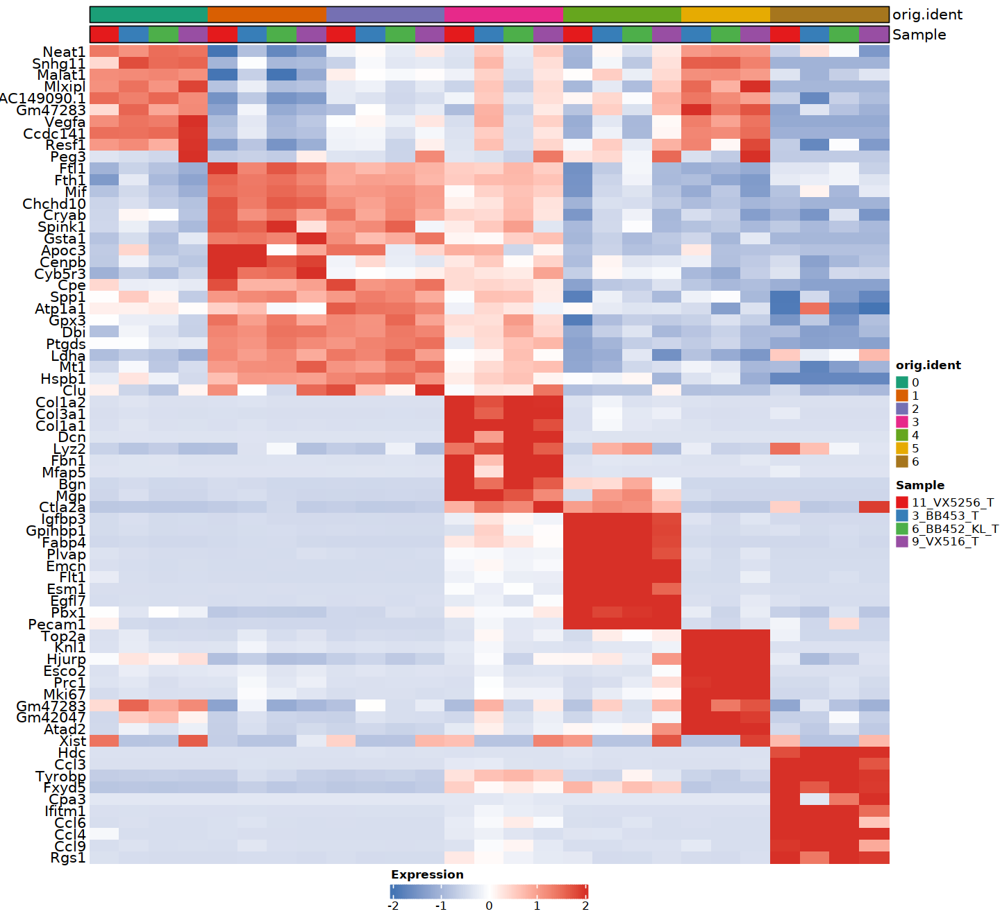

In [16]:
markers %>%
    group_by(cluster) %>%
    top_n(n = 10, wt = avg_log2FC) -> top10

DefaultAssay(seur_ni_t) = "RNA"
cluster.averages <- AverageExpression(seur_ni_t, return.seurat = TRUE, group.by = "seurat_clusters",add.ident = "Sample")
cluster_sample = strsplit(row.names(cluster.averages@meta.data),"_")
sample = lapply(cluster_sample, function(x) x[-1])
cluster.averages$Sample = unlist(lapply(sample, paste,collapse = "_"))
cluster.averages$orig.ident = factor(cluster.averages$orig.ident, levels = c(0:length(unique(cluster.averages$orig.ident))))
                
options(repr.plot.width=12, repr.plot.height=11)

colors <- list(brewer.pal(7, "Dark2"),brewer.pal(4,"Set1"))

DefaultAssay(cluster.averages) = "RNA"
plot_heatmap(dataset = cluster.averages, 
              markers = top10$gene,
              sort_var = c("orig.ident","Sample"),
              anno_var = c("orig.ident","Sample"),
              anno_colors = colors)


In [17]:
#0 Tumor_Neat1
#1 Tumor_Ftl1
#2 Tumor_Cpe
#3 Mix (subset)
#4 Endothelial_Tum_Igfbp3
#5 Tumor_Cycling_Mki67
#6 Myeloid_Contaminant

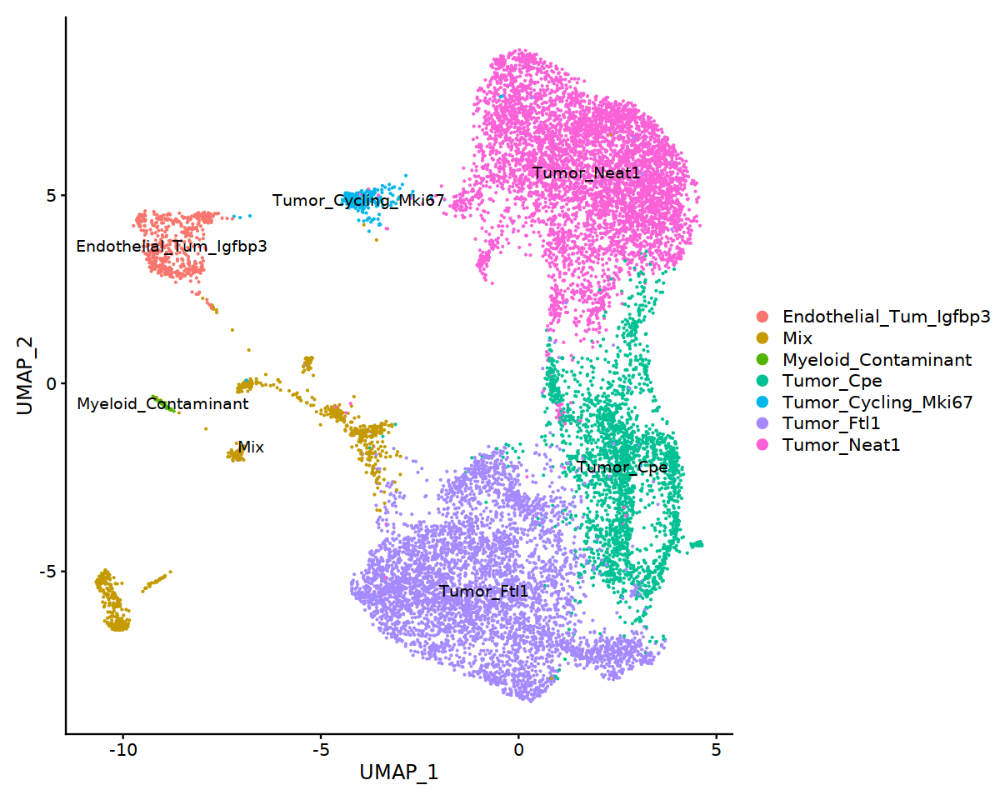

In [40]:
Idents(seur_ni_t) = "seurat_clusters"

new.cluster.ids = c("Tumor_Neat1","Tumor_Ftl1","Tumor_Cpe","Mix","Endothelial_Tum_Igfbp3","Tumor_Cycling_Mki67","Myeloid_Contaminant")
names(new.cluster.ids) = levels(seur_ni_t)
seur_ni_t = RenameIdents(seur_ni_t, new.cluster.ids)

Idents(seur_ni_t) = factor(Idents(seur_ni_t), levels = sort(unique(as.character(Idents(seur_ni_t)))) )

options(repr.plot.width=10, repr.plot.height=8)
DimPlot(seur_ni_t, label = T)

### 10. Subset, reproject, and recluster mixed cluster, then map true identities back to complete object

Centering and scaling data matrix

PC_ 1 
Positive:  Col1a2, Col3a1, Fstl1, Dcn, Fbn1, Col1a1, Svep1, Prss23, Islr, Ogn 
	   Mfap5, Serpinf1, Bgn, Nid1, Adamts5, Gpc3, Col5a2, Ccdc80, Igfbp6, Fbln2 
	   Prrx1, Slit3, Cd248, Dpt, Prelp, Sparc, Ly6c1, Clec3b, Adgrd1, Pi16 
Negative:  Spp1, Fxyd2, Ndrg1, Cryab, Gsta2, Mif, Maoa, Apoe, Abcg2, Aldob 
	   Chpt1, Gc, Chchd10, Gatm, Atp1b1, Pdzk1ip1, Rida, Ptgds, Neu1, Spink1 
	   Folr1, Ggt1, Ldhb, Cpn1, Tmem176b, Gss, Tmem176a, Cpe, Tpi1, Cystm1 
PC_ 2 
Positive:  Atp5g1, Txn1, Gstm5, Dbi, Gstm1, Gapdh, Uqcr10, Cox7a2, Atp5g3, Gpx4 
	   Akr1a1, Prdx1, Ldha, Ndufb8, Cisd1, Bsg, Blvrb, Aldoa, Gpx1, Psmd8 
	   Cox5a, Pgam1, Uqcrfs1, Cycs, Ddt, Comt, Qdpr, Atox1, Cbr3, Hagh 
Negative:  Malat1, AC149090.1, Neat1, Gm26917, Mylk, 4632427E13Rik, 6720427I07Rik, Chka, Dleu2, Mcam 
	   Lncpint, Gm47283, Ccnl2, Birc2, Gm26632, BC005561, Pdgfrb, Myo1b, Notch3, Sept4 
	   Pear1, Kcnq1ot1, Mlxipl, Vegfa, Gm26724, Amn1, Snhg11, Gm26532, Sbno2, Itga1 
PC_ 3 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 785
Number of edges: 23236

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9522
Number of communities: 4
Elapsed time: 0 seconds


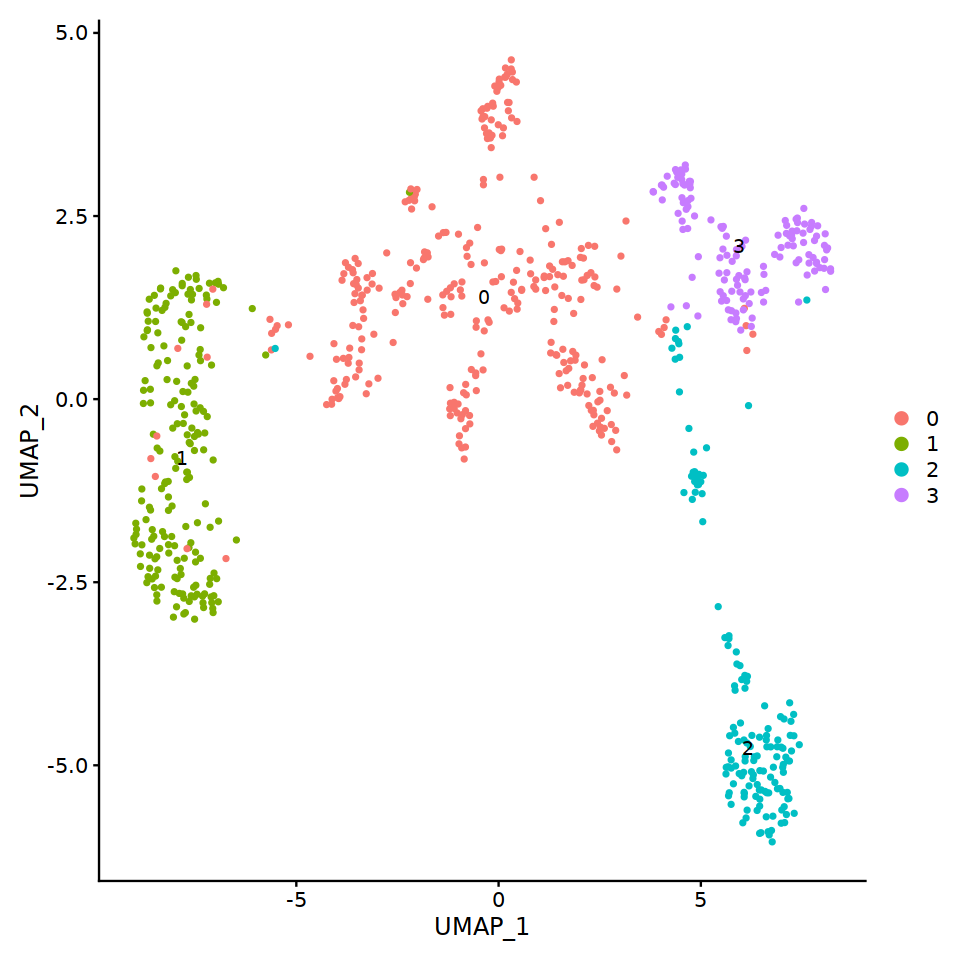

In [41]:
options(repr.plot.width=8, repr.plot.height=8)
seur_mix = subset(seur_ni_t, idents = "Mix")
seur_mix <- NormalizeData(seur_mix)
seur_mix <- FindVariableFeatures(seur_mix, selection.method = "vst",nfeatures = 3000)
seur_mix <- ScaleData(seur_mix, features = row.names(seur_mix))
seur_mix <- RunPCA(seur_mix, npcs = 20,verbose = T)
seur_mix <- RunHarmony(seur_mix, group.by.vars = "Sex")
seur_mix <- RunUMAP(seur_mix, reduction = "harmony", dims = 1:20)
seur_mix <- FindNeighbors(seur_mix, reduction = "harmony", dims = 1:20)
seur_mix <- FindClusters(seur_mix, resolution = 0.1)
DimPlot(seur_mix, label = T)

In [42]:
markers_mix <- FindAllMarkers(seur_mix, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")
markers_mix %>% group_by(cluster) %>% top_n(n = 10, wt = avg_log2FC)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3



p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
1.064645e-53,1.762184,0.939,0.851,2.541415e-49,0,AY036118
1.241954e-25,3.410736,0.389,0.295,2.964670e-21,0,Gng11
4.026394e-23,3.461107,0.382,0.272,9.611406e-19,0,Pf4
9.131545e-16,1.786010,0.268,0.159,2.179791e-11,0,Myl9
2.603743e-15,1.888306,0.392,0.221,6.215394e-11,0,Hbb-bs
1.771460e-10,2.919790,0.392,0.403,4.228651e-06,0,Ctla2a
8.932309e-09,2.194165,0.583,0.786,2.132231e-04,0,Cd9
5.404305e-08,2.025799,0.885,0.955,1.290062e-03,0,Tmsb4x
5.583681e-05,2.364471,0.484,0.783,1.000000e+00,0,1810058I24Rik


Warning message:
"'add.ident' is a deprecated argument, please use the 'group.by' argument instead"
Centering and scaling data matrix



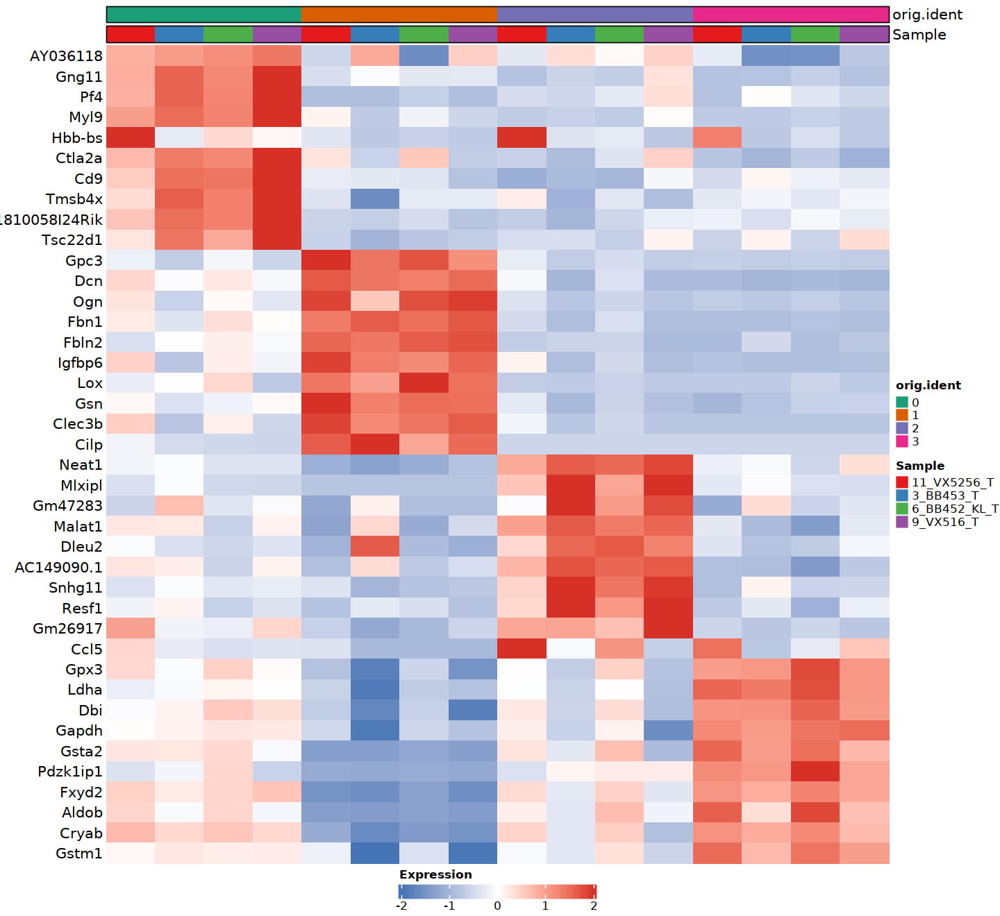

In [43]:
markers_mix %>%
    group_by(cluster) %>%
    top_n(n = 10, wt = avg_log2FC) -> top10

DefaultAssay(seur_mix) = "RNA"
cluster.averages <- AverageExpression(seur_mix, return.seurat = TRUE, group.by = "seurat_clusters",add.ident = "Sample")
cluster_sample = strsplit(row.names(cluster.averages@meta.data),"_")
sample = lapply(cluster_sample, function(x) x[-1])
cluster.averages$Sample = unlist(lapply(sample, paste,collapse = "_"))
cluster.averages$orig.ident = factor(cluster.averages$orig.ident, levels = c(0:length(unique(cluster.averages$orig.ident))))
                
options(repr.plot.width=12, repr.plot.height=11)

colors <- list(brewer.pal(4, "Dark2"),brewer.pal(4,"Set1"))

DefaultAssay(cluster.averages) = "RNA"
plot_heatmap(dataset = cluster.averages, 
              markers = top10$gene,
              sort_var = c("orig.ident","Sample"),
              anno_var = c("orig.ident","Sample"),
              anno_colors = colors)


Warning message:
"Scaling data with a low number of groups may produce misleading results"
Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



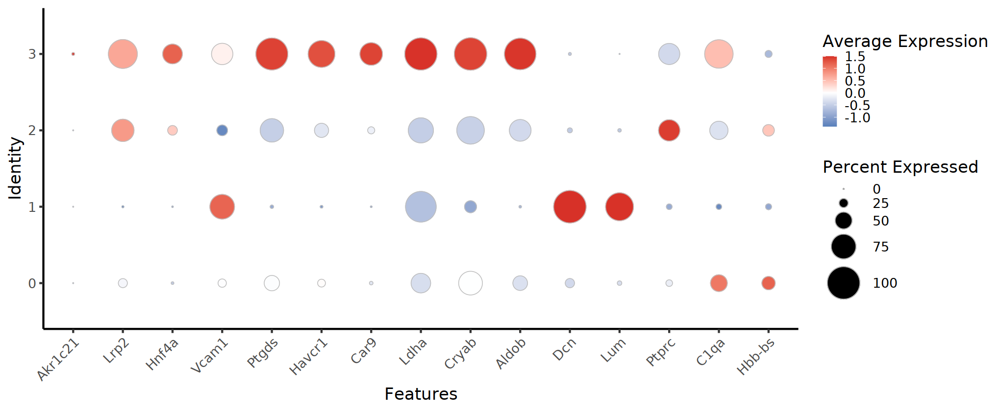

In [44]:
options(repr.plot.width=17, repr.plot.height=7)

DotPlot(seur_mix, features = c("Akr1c21","Lrp2","Hnf4a","Vcam1","Ptgds","Havcr1","Car9","Ldha","Cryab","Aldob","Dcn","Lum","Ptprc","C1qa","Hbb-bs"),assay = "RNA",dot.scale = 18, cols = c("white","red")) + theme_classic(base_size = 20) +
geom_point(aes(size = pct.exp),shape = 21, color = "grey",stroke = 0.5) + 
scale_colour_gradient2(low = "#4575b4", mid = "white", high = "#d73027") +
theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))

In [45]:
#0 Contaminant
#1 Fibroblast_Dcn
#2 ImmuneContam_Tumor
#3 ImmuneContam_Tumor

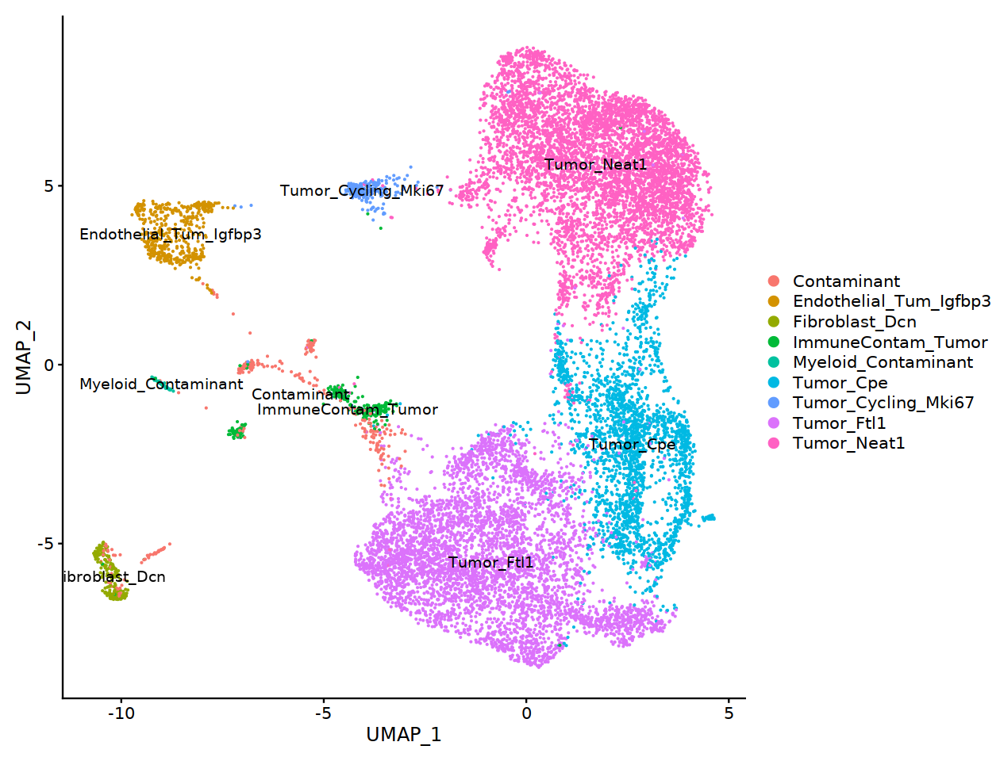

In [46]:
seur_ni_t = SetIdent(seur_ni_t, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 0)),value = "Contaminant")
seur_ni_t = SetIdent(seur_ni_t, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 1)),value = "Fibroblast_Dcn")
seur_ni_t = SetIdent(seur_ni_t, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 2)),value = "ImmuneContam_Tumor")
seur_ni_t = SetIdent(seur_ni_t, cells = row.names(subset(seur_mix@meta.data, seurat_clusters == 3)),value = "ImmuneContam_Tumor")

Idents(seur_ni_t) = factor(Idents(seur_ni_t), levels = sort(unique(as.character(Idents(seur_ni_t)))) )

options(repr.plot.width=10.5, repr.plot.height=8)
DimPlot(seur_ni_t, label = T)

Tumor_Neat1    Tumor_Cycling_Mki67              Tumor_Cpe 
             "#1B9E77"              "#C16610"              "#8D6B86" 
            Tumor_Ftl1 Endothelial_Tum_Igfbp3         Fibroblast_Dcn 
             "#BC4399"              "#A66753"              "#96A713" 
   Myeloid_Contaminant            Contaminant     ImmuneContam_Tumor 
             "#D59D08"              "#9D7426"              "#666666"

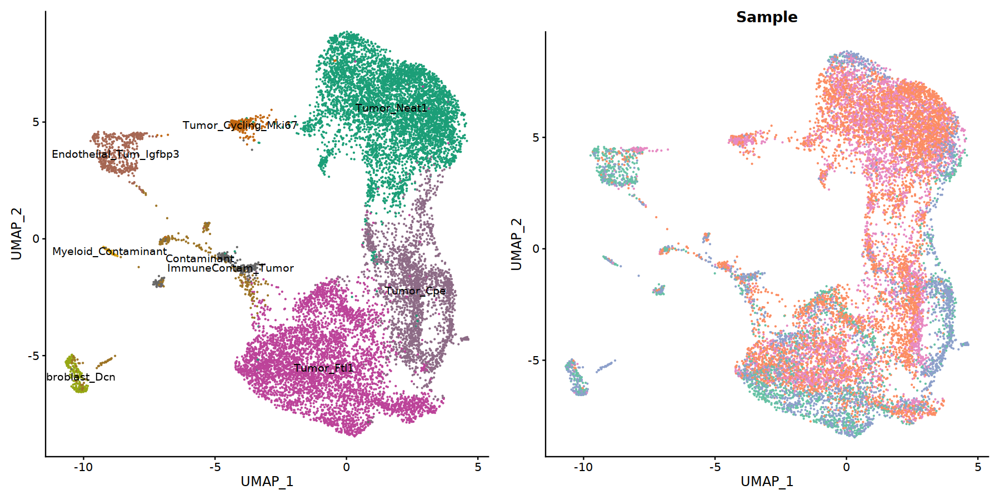

In [47]:
ordered = c("Tumor_Neat1","Tumor_Cycling_Mki67","Tumor_Cpe","Tumor_Ftl1","Endothelial_Tum_Igfbp3","Fibroblast_Dcn","Myeloid_Contaminant","Contaminant","ImmuneContam_Tumor")
Idents(seur_ni_t) = factor(Idents(seur_ni_t), levels = ordered)

mycols = colorRampPalette(brewer.pal(8, "Dark2"))(9)
names(mycols) = as.character(levels(Idents(seur_ni_t)))
mycols

one = DimPlot(seur_ni_t, label = T, cols = mycols[as.character(levels(Idents(seur_ni_t)))]) + NoLegend()
two = DimPlot(seur_ni_t, group.by = "Sample", cols = brewer.pal(4, "Set2"),shuffle = T) + NoLegend()


library(ggpubr)
options(repr.plot.width=15, repr.plot.height=7.5)
ggarrange(one, two, nrow = 1)

ggsave("Manuscript_Figures/Tumor_UMAPs_Combined_CellType_Sample.pdf", width = 15, height = 7.5)

,Var1,Var2,Freq
,<fct>,<fct>,<dbl>
1,11_VX5256_T,Tumor_Neat1,0.01461769
2,3_BB453_T,Tumor_Neat1,0.54179160
3,6_BB452_KL_T,Tumor_Neat1,0.07739880
4,9_VX516_T,Tumor_Neat1,0.36619190
5,11_VX5256_T,Tumor_Cycling_Mki67,0.00000000


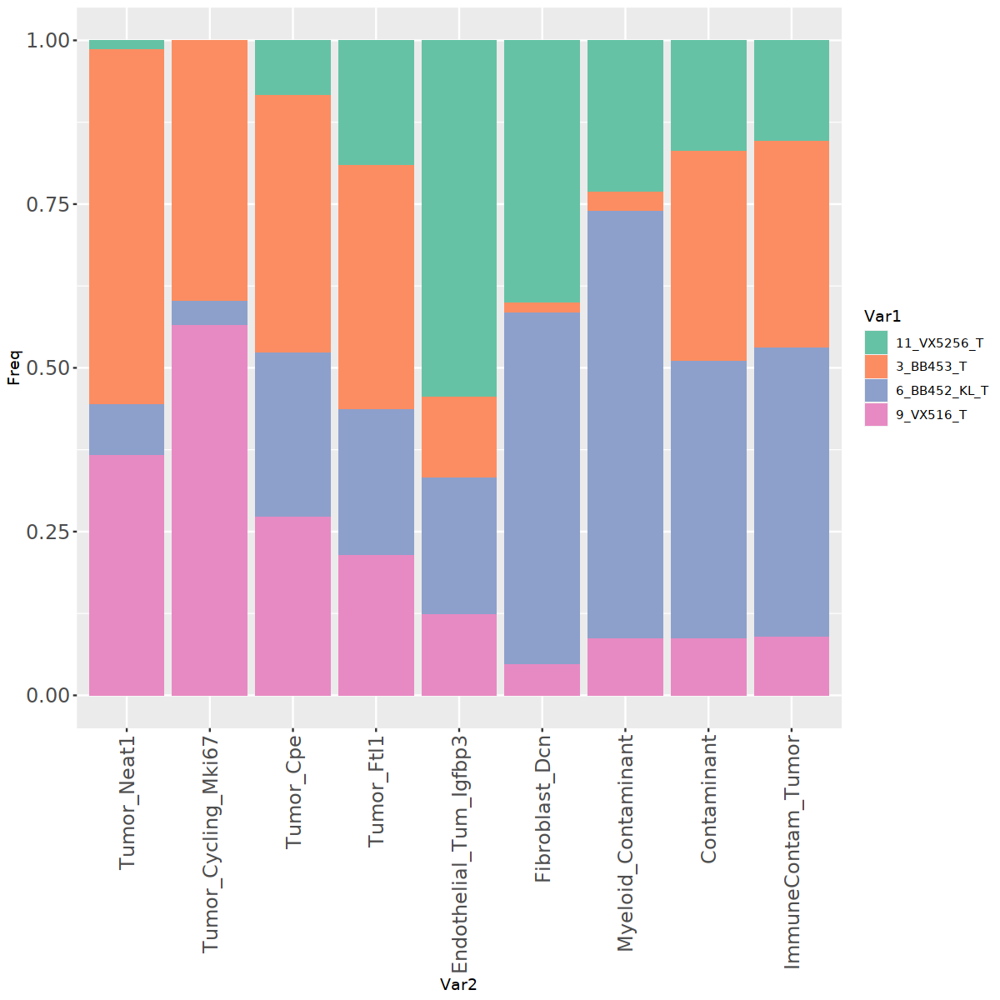

In [48]:
options(repr.plot.width=10, repr.plot.height=10)
props <- prop.table(table(seur_ni_t$Sample,Idents(seur_ni_t)), margin = 2)
props <- data.frame(props)
corner(props)
ggplot() + geom_bar(aes(y = Freq, x = Var2, fill = Var1), data = props, stat="identity") +theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1,size=14),
          axis.text.y = element_text(size=14)) + scale_fill_manual(values = brewer.pal(4, "Set2")) 


In [49]:
saveRDS(seur_ni_t, file = "Manuscript_Objects/NonImmune_Tumor_SeuratObject.RDS")

### 11. Characterize phenotypic/technical differences between clusters of tumor cells

In [3]:
seur_ni_t = readRDS(file = "Manuscript_Objects/NonImmune_Tumor_SeuratObject.RDS")

In [4]:
seur_ni_t_tum = subset(seur_ni_t,idents = c("Endothelial_Tum_Igfbp3","Fibroblast_Dcn","Myeloid_Contaminant","Contaminant","ImmuneContam_Tumor"),invert = T)

In [5]:
seur_ni_t_tum[["percent.rps"]] <- PercentageFeatureSet(seur_ni_t_tum, pattern = "^Rps")
seur_ni_t_tum[["percent.rpl"]] <- PercentageFeatureSet(seur_ni_t_tum, pattern = "^Rpl")

In [6]:
seur_ni_t_tum$Tumor_Cluster = Idents(seur_ni_t_tum)

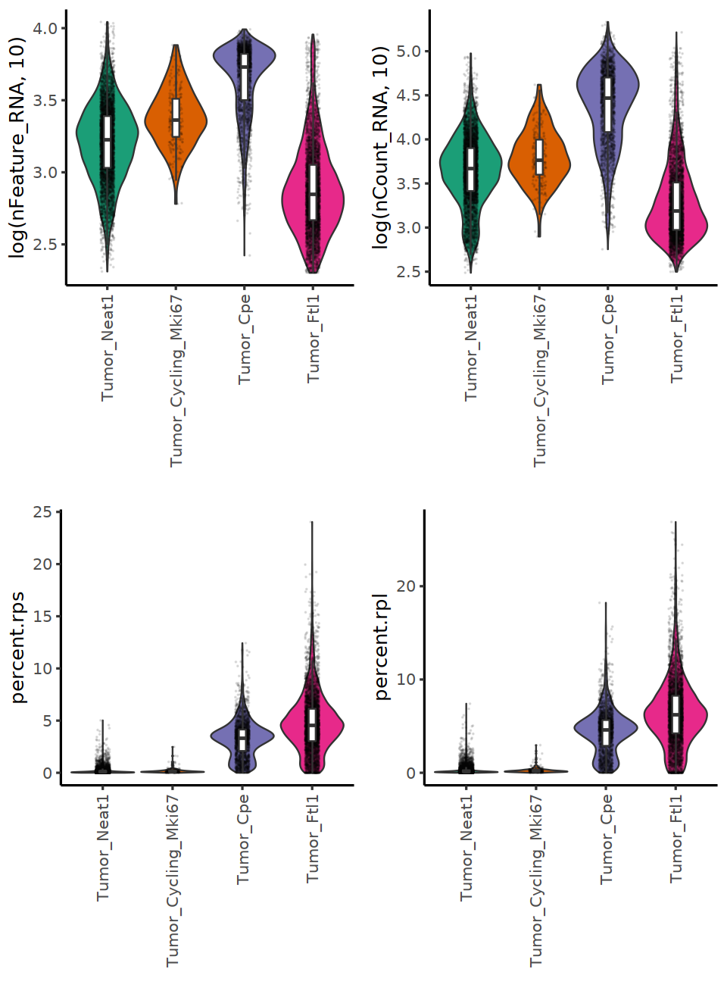

In [7]:
options(repr.plot.width=8, repr.plot.height=11)

plot_df = seur_ni_t_tum@meta.data

nfeat = ggplot(plot_df, aes(x=Tumor_Cluster, y=log(nFeature_RNA,10), fill = Tumor_Cluster)) + 
  geom_violin(scale = "width") + geom_jitter(color = "black",alpha = 0.1,width = 0.1,size = 0.01) + 
geom_boxplot(width = 0.1,fill = "white",outlier.shape = NA) + theme_classic(base_size = 15) + 
scale_fill_manual(values = brewer.pal(6, "Dark2")) + theme(legend.position = "none",axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) + xlab(label = "")

ncount = ggplot(plot_df, aes(x=Tumor_Cluster, y=log(nCount_RNA,10), fill = Tumor_Cluster)) + 
  geom_violin(scale = "width") + geom_jitter(color = "black",alpha = 0.1,width = 0.1,size = 0.01) + 
geom_boxplot(width = 0.1,fill = "white",outlier.shape = NA) + theme_classic(base_size = 15) + 
scale_fill_manual(values = brewer.pal(6, "Dark2")) + theme(legend.position = "none",axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))+ xlab(label = "")

pct.rps = ggplot(plot_df, aes(x=Tumor_Cluster, y=percent.rps, fill = Tumor_Cluster)) + 
  geom_violin(scale = "width") + geom_jitter(color = "black",alpha = 0.1,width = 0.1,size = 0.01) + 
geom_boxplot(width = 0.1,fill = "white",outlier.shape = NA) + theme_classic(base_size = 15) + 
scale_fill_manual(values = brewer.pal(6, "Dark2")) + theme(legend.position = "none",axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) + xlab(label = "")

pct.rpl = ggplot(plot_df, aes(x=Tumor_Cluster, y=percent.rpl, fill = Tumor_Cluster)) + 
  geom_violin(scale = "width") + geom_jitter(color = "black",alpha = 0.1,width = 0.1,size = 0.01) + 
geom_boxplot(width = 0.1,fill = "white",outlier.shape = NA) + theme_classic(base_size = 15) + 
scale_fill_manual(values = brewer.pal(6, "Dark2")) + theme(legend.position = "none",axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) + xlab(label = "")

ggarrange(nfeat, ncount, pct.rps, pct.rpl, nrow = 2,ncol = 2)

### DE in three main tumor clusters (Tumor_Neat1, Tumor_Cpe, and Tumor_Ftl1) shows differential expression of genes associated with ambient RNA contamination

In [8]:
seur_ni_t_tum.downsample <- subset(subset(seur_ni_t_tum,idents = c("Tumor_Cycling_Mki67"),invert = T), downsample = 1000)

In [9]:
markers_tum.downsample <- FindAllMarkers(seur_ni_t_tum.downsample, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")

Calculating cluster Tumor_Neat1

Calculating cluster Tumor_Cpe

Calculating cluster Tumor_Ftl1



`use_raster` is automatically set to TRUE for a matrix with more than
2000 columns You can control `use_raster` argument by explicitly
setting TRUE/FALSE to it.

Set `ht_opt$message = FALSE` to turn off this message.

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



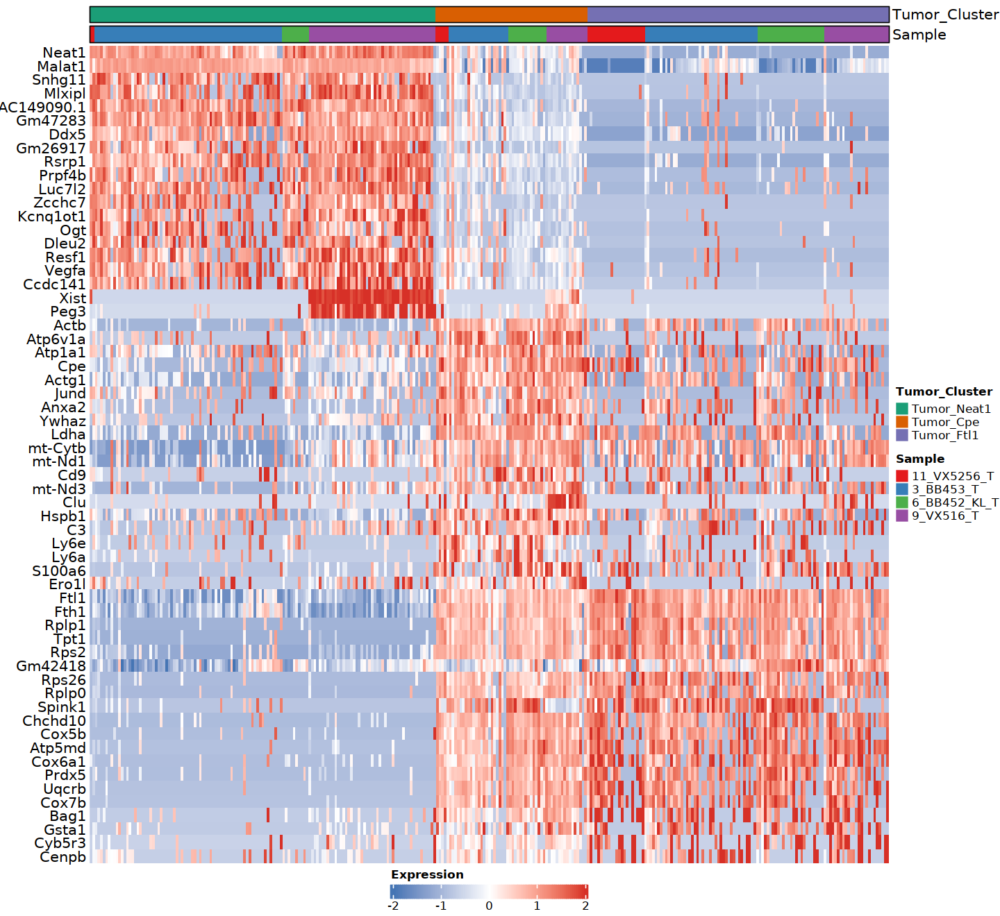

In [45]:
options(repr.plot.width=12, repr.plot.height=11)

markers_tum.downsample %>%
    group_by(cluster) %>%
    top_n(n = 20, wt = avg_log2FC) -> top20

colors <- list(brewer.pal(3, "Dark2"),brewer.pal(4,"Set1"))

plot_heatmap(dataset = subset(seur_ni_t_tum,idents = c("Tumor_Cycling_Mki67"),invert = T), 
              markers = top20$gene,
              sort_var = c("Tumor_Cluster","Sample"),
              anno_var = c("Tumor_Cluster","Sample"),
              anno_colors = colors)


### Enrichment of Ftl1, Fth1, Rps, and Rpl genes in Tumor_Cpe and Tumor_Ftl1 suggests unresolved ambient contaminant 

### 12. Use low RNA content droplets from each tumor sample to identify genes dominating ambient RNA profile


In [11]:
samples = c("11_VX5256_T","3_BB453_T","6_BB452_KL_T","9_VX516_T")

In [12]:
ambient_genes = list()

for (i in 1:length(samples)){
    raw = Read10X_h5(paste("Raw_BC_Matrix//",samples[i],"_raw_feature_bc_matrix.h5",sep = ""))
    raw_colsums = colSums(raw)
                     
empties = names(which(raw_colsums > 50 & raw_colsums < 200))
empties_matrix = raw[,empties]
empties_rowsums = rowSums(empties_matrix)
empties_rowsums = empties_rowsums[order(empties_rowsums, decreasing = T)]
empties_rowsums = data.frame(empties_rowsums)
empties_rowsums$gene = row.names(empties_rowsums) 
                     
ambient_genes[[i]] = empties_rowsums[1:200,]$gene
}

names(ambient_genes) = samples

In [13]:
str(ambient_genes)

List of 4
 $ 11_VX5256_T : chr [1:200] "Hbb-bs" "Gm42418" "Malat1" "Tmsb4x" ...
 $ 3_BB453_T   : chr [1:200] "Malat1" "Spp1" "Fth1" "Gm42418" ...
 $ 6_BB452_KL_T: chr [1:200] "Gm42418" "Malat1" "Spp1" "Fth1" ...
 $ 9_VX516_T   : chr [1:200] "Malat1" "Spp1" "Gm42418" "Fth1" ...


In [14]:
int_ambient = Reduce(intersect, list(ambient_genes[[1]],ambient_genes[[2]],ambient_genes[[3]],ambient_genes[[4]]))
length(int_ambient)
int_ambient

[1] 143

[1] "Gm42418"  "Malat1"   "Tmsb4x"   "Spp1"     "Fth1"     "Apoe"    
  [7] "Ftl1"     "Tpt1"     "Rps24"    "Rplp1"    "Fau"      "Rpl13"   
 [13] "Rpl23"    "Rps29"    "AY036118" "Cryab"    "Rps15a"   "Rpl37a"  
 [19] "mt-Co3"   "Rps8"     "Actb"     "Rpl32"    "Rpl39"    "Rpl27a"  
 [25] "Rps27a"   "Rps16"    "Rps21"    "mt-Co1"   "Rpl19"    "Eef1a1"  
 [31] "Rpl41"    "Rps12"    "Rps23"    "Rpl37"    "Rpl30"    "Rps20"   
 [37] "Rps10"    "Rpl35a"   "Rps27"    "Rps13"    "Tmsb10"   "Rps7"    
 [43] "Rps18"    "Rpsa"     "Rps3a1"   "Rpl34"    "mt-Atp6"  "Rps14"   
 [49] "Rpl18a"   "Rps11"    "B2m"      "Rpl17"    "Rplp2"    "Rpl38"   
 [55] "Rps19"    "mt-Co2"   "Rpl12"    "Rps4x"    "Rps28"    "Rps9"    
 [61] "Rpl11"    "Rpl21"    "Rpl9"     "Rpl26"    "Rps5"     "Rps26"   
 [67] "Rplp0"    "Rpl6"     "Rpl28"    "Rps3"     "Rpl18"    "Ppia"    
 [73] "Rps2"     "Prdx1"    "H2-D1"    "Rpl36"    "Rpl24"    "Rpl27"   
 [79] "S100a6"   "Ctsd"     "H2-K1"    "Fxyd2"    "Gpx3"     "Ctsb"    
 [85] "Cst3"     "Rpl15"    "Ctsl"     "Dbi"      "Rps15"    "Itm2b"   
 [91] "Rps25"    "Ubb"      "Rpl10a"   "Ptma"     "Gpx1"     "Cd63"    
 [97] "Serf2"    "Cox8a"    "Cox4i1"   "Crip1"    "Cyba"     "Myl6"    
[103] "Cox7c"    "Gapdh"    "Hspa8"    "mt-Cytb"  "Hsp90ab1" "Mif"     
[109] "Rps17"    "Cox6c"    "mt-Nd1"   "Selenop"  "Lgals3"   "mt-Nd2"  
[115] "Chchd2"   "Cstb"     "mt-Nd4"   "Gpx4"     "Lgals1"   "Nme2"    
[121] "Gsta2"    "Txn1"     "Psap"     "Cox6b1"   "Tmem176a" "Atp5l"   
[127] "Gng5"     "Gstm1"    "Atox1"    "Cox5a"    "Cox7a2"   "Tmem176b"
[133] "Atp6v0c"  "Ctsz"     "Mt1"      "Esd"      "Hint1"    "Ptgds"   
[139] "Lamp1"    "Atpif1"   "Atp5j2"   "Cox5b"    "Cox6a1"

In [15]:
union_ambient = unique(unlist(ambient_genes))
length(union_ambient)
union_ambient


[1] 276

[1] "Hbb-bs"    "Gm42418"   "Malat1"    "Tmsb4x"    "Spp1"      "Fth1"     
  [7] "Apoe"      "Hba-a1"    "Ftl1"      "Hba-a2"    "Tpt1"      "Rps24"    
 [13] "Rplp1"     "Fau"       "Rpl13"     "Rpl23"     "Rps29"     "AY036118" 
 [19] "Hbb-bt"    "Cryab"     "Lyz2"      "Rps15a"    "Rpl37a"    "mt-Co3"   
 [25] "Rps8"      "Actb"      "Rpl32"     "Rpl39"     "Rpl27a"    "Rps27a"   
 [31] "Rps16"     "Rps21"     "mt-Co1"    "Rpl19"     "Eef1a1"    "Rpl41"    
 [37] "Rps12"     "Rps23"     "Rpl37"     "Rpl30"     "Rps20"     "Ccl5"     
 [43] "Rps10"     "Rpl35a"    "Rps27"     "Rps13"     "Tmsb10"    "Rps7"     
 [49] "Rps18"     "Rpsa"      "Rps3a1"    "Rpl34"     "mt-Atp6"   "Cd74"     
 [55] "Rps14"     "Rpl18a"    "Rps11"     "B2m"       "Rpl17"     "Rplp2"    
 [61] "Rpl38"     "Rps19"     "mt-Co2"    "Rpl12"     "Rpl13a"    "Rps4x"    
 [67] "Rps28"     "Rps9"      "Rpl11"     "Rpl21"     "Rpl9"      "Rpl26"    
 [73] "Rps5"      "Rps26"     "Rplp0"     "Rpl6"      "Rpl28"     "Rps3"     
 [79] "Rpl18"     "Ppia"      "Rps2"      "Rpl8"      "Prdx1"     "H2-D1"    
 [85] "Rpl36"     "Rpl24"     "Cd52"      "Rpl27"     "S100a6"    "Ctsd"     
 [91] "H2-K1"     "Fxyd2"     "Gpx3"      "Ctsb"      "Cst3"      "Rpl15"    
 [97] "Rpl5"      "Ctsl"      "Dbi"       "Rps15"     "Itm2b"     "Rps25"    
[103] "Rpl7"      "Rpl3"      "Rpl10"     "Rpl22"     "Ubb"       "Rpl10a"   
[109] "Rack1"     "Ptma"      "Gpx1"      "Cd63"      "Serf2"     "Rpl23a"   
[115] "Rpl14"     "Cox8a"     "Cox4i1"    "Crip1"     "Cyba"      "Myl6"     
[121] "Rps6"      "Cox7c"     "Sh3bgrl3"  "Gapdh"     "Hspa8"     "Eif1"     
[127] "C1qb"      "C1qa"      "Tyrobp"    "mt-Cytb"   "H2-Aa"     "Hsp90ab1" 
[133] "Mif"       "Rps17"     "Cox6c"     "H3f3b"     "mt-Nd1"    "Rpl36a"   
[139] "Selenop"   "Lgals3"    "H2-Ab1"    "mt-Nd2"    "Chchd2"    "Rpl7a"    
[145] "Rpl29"     "Cstb"      "H3f3a"     "mt-Nd4"    "Gpx4"      "Pfn1"     
[151] "Eef1b2"    "Lgals1"    "Nme2"      "Gsta2"     "Calm1"     "H2-Eb1"   
[157] "Naca"      "Atp5e"     "Txn1"      "Actg1"     "Psap"      "AW112010" 
[163] "Ctss"      "Cox6b1"    "Fcer1g"    "Ddx5"      "Wfdc17"    "Tmem176a" 
[169] "Rpl36al"   "Oaz1"      "Atp5l"     "S100a10"   "Gng5"      "Rpl35"    
[175] "Gstm1"     "Atox1"     "Cox5a"     "Cox7a2"    "Tmem176b"  "Ly6e"     
[181] "Ifi27l2a"  "Atp6v0c"   "Atp5h"     "H2afz"     "Uqcrh"     "Cpe"      
[187] "Ctsz"      "Npm1"      "Mt1"       "Esd"       "Rpl31"     "Nkg7"     
[193] "Hint1"     "Ptgds"     "Lamp1"     "Atpif1"    "Atp5j2"    "Cox5b"    
[199] "C1qc"      "Cox6a1"    "Spink1"    "Creg1"     "Bsg"       "Ndrg1"    
[205] "Neat1"     "Abcg2"     "Apoc3"     "Gc"        "Ugp2"      "Aldoa"    
[211] "Hspb1"     "Chchd10"   "Cd81"      "Vmp1"      "Rps27l"    "Mgst1"    
[217] "Hspa5"     "Uqcr11"    "Taldo1"    "Tspo"      "Lamp2"     "Ndufa13"  
[223] "Cox7b"     "Ndufb9"    "Prdx5"     "Tpi1"      "Gm47283"   "Fam162a"  
[229] "Calr"      "Uqcrq"     "Lgmn"      "Npc2"      "Ndufb8"    "Bst2"     
[235] "Atp5b"     "Uqcr10"    "Rtn4"      "Atp1a1"    "Atp6v0b"   "Ndufa4"   
[241] "Elob"      "Rsrp1"     "Sat1"      "Ldha"      "Kap"       "mt-Nd3"   
[247] "Aldob"     "Atp5md"    "Atp5mpl"   "Atp5g1"    "Atp5k"     "Ndufb1-ps"
[253] "Uqcrb"     "Chpt1"     "Atp5j"     "Akr1a1"    "S100a11"   "Rida"     
[259] "Igfbp7"    "Clu"       "Apob"      "Sprr1a"    "Gsta1"     "Folr1"    
[265] "C3"        "mt-Nd5"    "Atp1b1"    "App"       "Xist"      "Hsp90b1"  
[271] "Spp2"      "Igfbp5"    "Cbr1"      "Maoa"      "Gsta4"     "S100g"

In [16]:
ambient_genes$int_ambient = int_ambient
ambient_genes$union_ambient = union_ambient

str(ambient_genes)


List of 6
 $ 11_VX5256_T  : chr [1:200] "Hbb-bs" "Gm42418" "Malat1" "Tmsb4x" ...
 $ 3_BB453_T    : chr [1:200] "Malat1" "Spp1" "Fth1" "Gm42418" ...
 $ 6_BB452_KL_T : chr [1:200] "Gm42418" "Malat1" "Spp1" "Fth1" ...
 $ 9_VX516_T    : chr [1:200] "Malat1" "Spp1" "Gm42418" "Fth1" ...
 $ int_ambient  : chr [1:143] "Gm42418" "Malat1" "Tmsb4x" "Spp1" ...
 $ union_ambient: chr [1:276] "Hbb-bs" "Gm42418" "Malat1" "Tmsb4x" ...


`use_raster` is automatically set to TRUE for a matrix with more than
2000 columns You can control `use_raster` argument by explicitly
setting TRUE/FALSE to it.

Set `ht_opt$message = FALSE` to turn off this message.

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



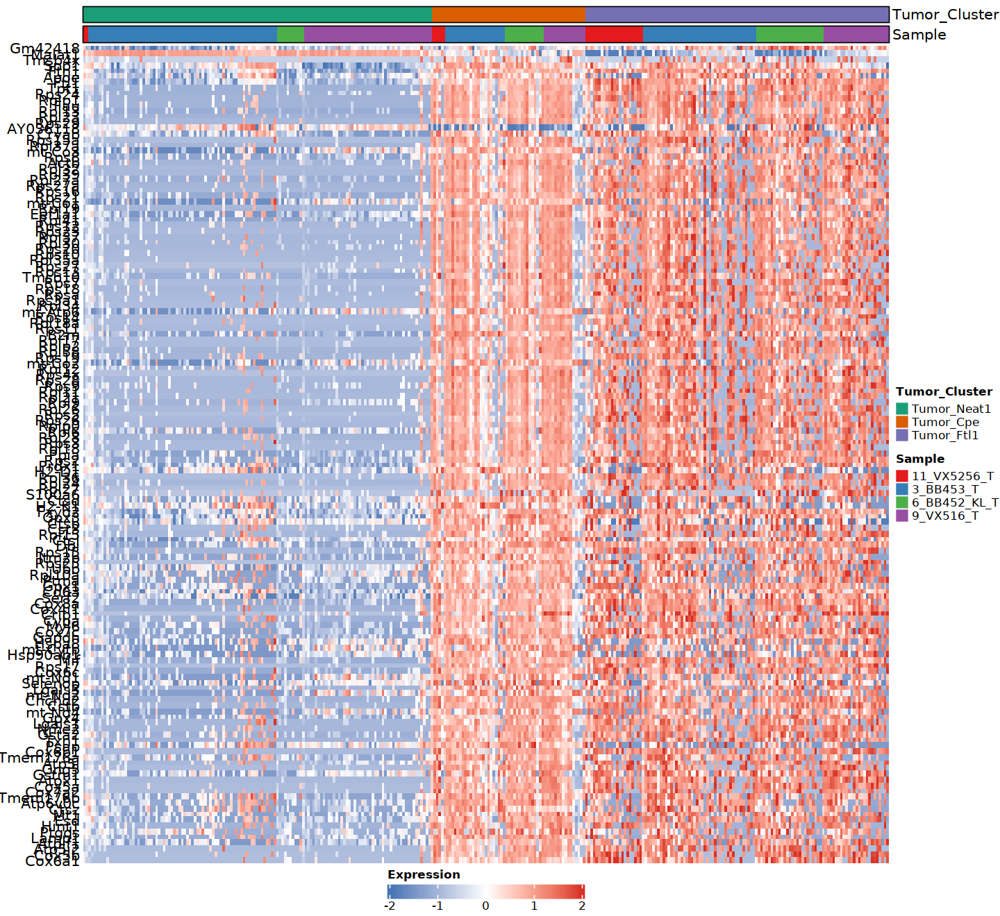

In [17]:
options(repr.plot.width=12, repr.plot.height=11)

markers_tum.downsample %>%
    group_by(cluster) %>%
    top_n(n = 20, wt = avg_log2FC) -> top20

colors <- list(brewer.pal(3, "Dark2"),brewer.pal(4,"Set1"))

plot_heatmap(dataset = subset(seur_ni_t_tum,idents = c("Tumor_Cycling_Mki67"),invert = T), 
              markers = int_ambient,
              sort_var = c("Tumor_Cluster","Sample"),
              anno_var = c("Tumor_Cluster","Sample"),
              anno_colors = colors)


### Tumor_Cpe and Tumor_Ftl1 show unresolved ambient contamination, but Tumor_Cpe may still represent a distinct phenotypic state (differential expression of Ldha, Anxa2, Clu, Vim, Car9, etc)

### 13. Run DE for Tumor_Cpe vs Tumor_Neat1 and Tumor_Ftl1 vs Tumor_Neat1

In [18]:
Idents(seur_ni_t_tum) = "Tumor_Cluster"

In [88]:
cpe_vs_neat1 = FindMarkers(seur_ni_t_tum, `ident.1` = "Tumor_Cpe",`ident.2` = "Tumor_Neat1",test.use = "LR",latent.vars = "Sex",min.diff.pct = 0, min.pct = 0,logfc.threshold = 0)
saveRDS(cpe_vs_neat1, file = "Manuscript_Objects/Tumor_Cpe_vs_Tumor_Neat1_DE_LR_Sex.RDS")

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

In [89]:
ftl1_vs_neat1 = FindMarkers(seur_ni_t_tum, `ident.1` = "Tumor_Ftl1",`ident.2` = "Tumor_Neat1",test.use = "LR",latent.vars = "Sex",min.diff.pct = 0, min.pct = 0,logfc.threshold = 0)
saveRDS(ftl1_vs_neat1, file = "Manuscript_Objects/Tumor_Ftl1_vs_Tumor_Neat1_DE_LR_Sex.RDS")

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"


In [48]:
cpe_vs_neat1 = readRDS("Manuscript_Objects/Tumor_Cpe_vs_Tumor_Neat1_DE_LR_Sex.RDS")
ftl1_vs_neat1 = readRDS("Manuscript_Objects/Tumor_Ftl1_vs_Tumor_Neat1_DE_LR_Sex.RDS")

In [20]:
cpe_vs_neat1_rnk = cpe_vs_neat1$avg_log2FC
names(cpe_vs_neat1_rnk) <- row.names(cpe_vs_neat1)
corner(cpe_vs_neat1_rnk)

fgseaRes <- fgsea(ambient_genes, cpe_vs_neat1_rnk, minSize=0, maxSize= 300, nperm=1000)
fgseaRes

Snhg6      Rpl7      Eloc     Smap1     Cox5b 
0.6383917 2.5708055 0.8454289 0.7486691 2.7493174

Warning message in fgsea(ambient_genes, cpe_vs_neat1_rnk, minSize = 0, maxSize = 300, :
"You are trying to run fgseaSimple. It is recommended to use fgseaMultilevel. To run fgseaMultilevel, you need to remove the nperm argument in the fgsea function call."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (1.12% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."


pathway,pval,padj,ES,NES,nMoreExtreme,size,leadingEdge
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>
11_VX5256_T,0.001221001,0.001338688,0.9651792,2.247363,0,200,"Tpt1 , Tmsb10 , Rpl23 , Rps29 , Rplp1 , Rpl39 , Gapdh , Rpl32 , Fth1 , Cstb , Rpl38 , Rps28 , Chchd2 , Rps16 , Fau , Ftl1 , Atox1 , Dbi , Cox8a , Nme2 , Rpl19 , Rpl28 , Mif , Rps2 , Rpl35a , Rps23 , Rpl41 , Rps10 , Rps20 , Cox6b1 , Rps11 , Rplp0 , Rpl37 , Cox4i1 , Rps27a , Rpl26 , Gpx3 , Cox5a , Actb , Rps15a , Rps24 , Rpl24 , Txn1 , Atp5e , Rps14 , Cox7a2 , Rpl30 , S100a6 , Rpl37a , Rps5 , Rps21 , Cox6c , Crip1 , Gng5 , Cryab , Rpl34 , Rpl13 , Rps3a1 , Rps3 , Rps19 , Rpl27a , B2m , Rpl36 , Rps8 , Rpsa , Rps12 , Rpl17 , Rps4x , Rps18 , Cox5b , Rplp2 , Rps7 , Rps17 , Rpl18a , Rpl21 , Rpl11 , Fxyd2 , Rpl18 , Cst3 , Lgals1 , Rpl15 , Gpx4 , Eef1a1 , Gpx1 , Rpl27 , Lgals3 , Atp5j2 , Ppia , Rps26 , Rpl7 , Gsta2 , Rpl23a , Uqcrh , Rps15 , Rpl22 , Cyba , Rps25 , Ptgds , Cox6a1 , Tmsb4x , Rpl13a , Rpl8 , Rpl3 , Prdx1 , Rps27 , Cox7c , Atp5h , Rps13 , Hint1 , Rpl36a , Cpe , Mt1 , Sh3bgrl3, Rps9 , Rpl9 , Rpl12 , Rpl14 , Rps6 , Rpl35 , Itm2b , Eef1b2 , Ctsl , Rpl5 , Rpl29 , Lamp1 , Tmem176b, Rpl7a , Atp5l , mt-Co2 , Spp1 , Naca , mt-Co1 , Atp6v0c , Rack1 , mt-Cytb , Myl6 , Esd , Gstm1 , Rpl10 , mt-Nd1 , Calm1 , Tmem176a, Cd74 , mt-Atp6 , mt-Nd4 , Selenop , Pfn1 , mt-Co3 , S100a10 , Ctsd , Eif1 , Ctsb , Actg1 , Serf2 , Ptma , Hsp90ab1, mt-Nd2 , Rpl6 , Rpl36al , Cd63 , Rpl31 , H3f3a , Atpif1 , Ubb , Apoe , Ly6e , Ctsz , H2afz , Hspa8 , H2-K1 , H2-D1 , H2-Ab1 , Oaz1 , Npm1 , Psap , Rpl10a"
3_BB453_T,0.001221001,0.001338688,0.9492746,2.210330,0,200,"Tpt1 , Tmsb10 , Rpl23 , Rps29 , Rplp1 , Rpl39 , Gapdh , Rpl32 , Fth1 , Cstb , Rpl38 , Rps28 , Chchd2 , Rps16 , Fau , Ftl1 , Atox1 , Dbi , Cox8a , Nme2 , Rpl19 , Rpl28 , Mif , Rps2 , Rpl35a , Rps23 , Rpl41 , Rps10 , Rps20 , Cox6b1 , Rps11 , Rplp0 , Rpl37 , Cox4i1 , Rps27a , Rpl26 , Gpx3 , Cox5a , Actb , Rps15a , Rps24 , Rpl24 , Txn1 , Atp5e , Rps14 , Cox7a2 , Rpl30 , S100a6 , Rpl37a , Rps5 , Rps21 , Cox6c , Spink1 , Uqcr11 , Crip1 , Gng5 , Cryab , Rpl34 , Rpl13 , Rps3a1 , Rps3 , Rps19 , Rpl27a , B2m , Ndufa4 , Rpl36 , Rps8 , Rpsa , Rps12 , Rpl17 , Rps4x , Rps18 , Rps27l , Cox5b , Rplp2 , Rps7 , Rps17 , Rpl18a , Rpl21 , Rpl11 , Fxyd2 , Rpl18 , Cst3 , Uqcrq , Lgals1 , Chchd10 , Rpl15 , Gpx4 , Eef1a1 , Uqcr10 , Gpx1 , Rpl27 , Lgals3 , Atp5j2 , Ppia , Cox7b , Rps26 , Rpl7 , Prdx5 , Ndufb9 , Gsta2 , Rps15 , Cyba , Rps25 , Ptgds , Bsg , Cox6a1 , Tmsb4x , Tspo , Rpl13a , Rpl8 , Fam162a , Rpl3 , Prdx1 , Rps27 , Cox7c , Elob , Rps13 , Hint1 , Aldoa , Cpe , Mt1 , Rps9 , Ndufb8 , Rpl9 , Rpl12 , Ldha , Itm2b , Ctsl , Rpl5 , Lamp1 , Tmem176b, Ndufa13 , Rpl7a , Atp5l , mt-Co2 , Spp1 , mt-Co1 , Atp6v0c , mt-Cytb , Myl6 , Esd , Taldo1 , Gstm1 , mt-Nd1 , Tmem176a, Cd74 , mt-Atp6 , mt-Nd4 , Selenop , Gc , mt-Co3 , Ctsd , Ctsb , Actg1 , Serf2 , Npc2 , Hspb1 , Ptma , Creg1 , Hsp90ab1, mt-Nd2 , Rpl6 , Cd63 , Atp5b , Atpif1 , Ubb , Apoe , Mgst1 , Ctsz , Bst2 , Hspa8 , Cd81 , H2-K1 , H2-D1 , Tpi1 , Lgmn , Psap , Calr , Rpl10a , Atp1a1 , Apoc3 , Gm42418"
6_BB452_KL_T,0.001221001,0.001338688,0.9701602,2.258961,0,200,"Tpt1 , Tmsb10 , Rpl23 , Rps29 , Rplp1 , Rpl39 , Gapdh , Rpl32 , Fth1 , Cstb , Rpl38 , Rps28 , Chchd2 , Rps16 , Fau , Ftl1 , Atox1 , Dbi , Cox8a , Nme2 , Rpl19 , Rpl28 , Mif , Rps2 , Rpl35a , Rps23 , Rpl41 , Rps10 , Rps20 , Cox6b1 , Rps11 , Rplp0 , Rpl37 , Cox4i1 , Rps27a , Rpl26 , Gpx3 , Cox5a , Actb , Rps15a , Rps24 , Rpl24 , Txn1 , Atp5e , Rps14 , Cox7a2 , Rpl30 , S100a6 , Rpl37a , Rps5 , Rps21 , Cox6c , Spink1 , Uqcr11 , Crip1 , Gng5 , Cryab , Rpl34 , Rpl13 , Rps3a1 , Rps3 , Rps19 , Rpl27a , B2m , Ndufa4 , Rpl36 , Rps8 , Rpsa , Rps12 , Rpl17 , Rps4x , Rps18 , Rps27l , Cox5b , Rplp2 , Rps7 , Rps17 , Rpl18a , Rpl21 , Rpl11 , Fxyd2 , Rpl18 , Cst3 , Uqcrq , Lgals1 , Chchd10 , Rpl15 , Gpx4 , Eef1a1 , Uqcr10 , Gpx1 , Rpl27 , Lgals3 , Atp5j2 , Ppia , Cox7b , Rps26 , Rpl7 , Atp5g1 , Prdx5 , Ndufb9 , Gsta2 , Uqcrh , Rps15 , Atp5md , Rpl22 , Cyba , Rps25

In [21]:
ftl1_vs_neat1_rnk = ftl1_vs_neat1$avg_log2FC
names(ftl1_vs_neat1_rnk) <- row.names(ftl1_vs_neat1)
corner(ftl1_vs_neat1_rnk)

fgseaRes <- fgsea(ambient_genes, ftl1_vs_neat1_rnk, minSize=0, maxSize= 300, nperm=1000)
fgseaRes

Rb1cc1 4732440D04Rik         Cspp1          Rpl7         Pkhd1 
   -1.0516806    -0.8778779    -1.7448762     2.8800172    -1.3489910

Warning message in fgsea(ambient_genes, ftl1_vs_neat1_rnk, minSize = 0, maxSize = 300, :
"You are trying to run fgseaSimple. It is recommended to use fgseaMultilevel. To run fgseaMultilevel, you need to remove the nperm argument in the fgsea function call."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (1.59% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."


pathway,pval,padj,ES,NES,nMoreExtreme,size,leadingEdge
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>
11_VX5256_T,0.001890359,0.001956947,0.9561301,2.411656,0,200,"Ftl1 , Tpt1 , Fth1 , Rplp1 , Rps29 , Rpl39 , Rpl23 , Rps2 , Rpl32 , Tmsb10 , Rplp0 , Rpl38 , Atox1 , Cox8a , Cox6b1 , Nme2 , Cox4i1 , Rpl28 , Mif , Rpl41 , Gapdh , Cstb , Fau , Rps28 , Rpl26 , Txn1 , Rps26 , Cox5b , Atp5e , Rps10 , Rps16 , Rps23 , Rpl19 , Rps20 , Cox5a , Rps24 , Rps11 , Cox6c , Chchd2 , Rps19 , Cryab , Rpl37 , Cox6a1 , Rpl35a , Rps12 , Rpl37a , Rps14 , Rpsa , Rpl24 , Rps27a , Cox7a2 , Rps5 , Rpl13 , Lgals1 , Rps18 , Dbi , Rpl21 , Fxyd2 , Rps15a , Gpx4 , Rpl36 , Rps21 , Rps17 , Gpx1 , Rpl17 , Crip1 , Rpl34 , Atp5j2 , Rpl27a , Rps8 , Rpl18a , Rps3a1 , Rps3 , Rpl11 , Rpl30 , Rplp2 , Cox7c , Gsta2 , Rps7 , Rpl13a , Rpl27 , Rps4x , Rps15 , Rps25 , Rpl22 , Ppia , Atp5h , Rpl15 , S100a6 , Rpl12 , Uqcrh , Gng5 , Rpl18 , Rpl23a , Cyba , B2m , Gpx3 , Rpl7 , Rpl35 , Prdx1 , Atp5l , Rpl36a , Gstm1 , Eef1b2 , Rps13 , Rpl8 , Cst3 , Lgals3 , Rps6 , Rpl5 , Rps9 , Rpl14 , Rpl29 , Rps27 , Eef1a1 , Hint1 , Rpl3 , Actb , Rpl9 , Rpl7a , Tmsb4x , Esd , Myl6 , Rpl10 , mt-Co1 , Mt1 , Rack1 , Atpif1 , Gm42418 , Ptgds , Sh3bgrl3, Naca , Itm2b , Serf2 , Ptma , Ctsl , Lamp1 , Tmem176a, Tmem176b, Cd74 , Rpl31 , mt-Atp6 , Cd63 , Rpl6 , Cpe , Rpl36al , mt-Nd4 , H2afz , Selenop , Spp1 , S100a10 , mt-Co2 , Atp6v0c , Calm1 , Apoe , Npm1 , mt-Co3 , Hsp90ab1, Pfn1 , Ctsd , Ctsz , Ubb , mt-Nd2 , mt-Cytb , Eif1 , Ctsb , Rpl10a , mt-Nd1 , Oaz1 , H3f3a , H2-Ab1 , H2-D1 , Hspa8 , Actg1 , Ly6e , H2-K1"
3_BB453_T,0.001890359,0.001956947,0.9358779,2.360573,0,200,"Ftl1 , Tpt1 , Fth1 , Rplp1 , Rps29 , Rpl39 , Rpl23 , Rps2 , Rpl32 , Tmsb10 , Rplp0 , Rpl38 , Atox1 , Cox8a , Cox6b1 , Nme2 , Cox4i1 , Rpl28 , Spink1 , Mif , Rpl41 , Gapdh , Cstb , Fau , Rps28 , Rpl26 , Txn1 , Rps26 , Cox5b , Atp5e , Rps10 , Rps16 , Rps23 , Rpl19 , Rps20 , Cox5a , Rps24 , Rps11 , Cox6c , Chchd2 , Rps19 , Uqcr11 , Cryab , Rpl37 , Cox6a1 , Rpl35a , Rps12 , Rpl37a , Rps14 , Chchd10 , Rpsa , Rpl24 , Rps27a , Cox7a2 , Rps5 , Cox7b , Prdx5 , Rpl13 , Lgals1 , Rps18 , Dbi , Uqcr10 , Rpl21 , Fxyd2 , Rps15a , Gpx4 , Rpl36 , Uqcrq , Rps21 , Rps17 , Gpx1 , Rpl17 , Crip1 , Ndufa4 , Rpl34 , Atp5j2 , Rpl27a , Rps8 , Rpl18a , Rps3a1 , Rps3 , Rpl11 , Rpl30 , Rplp2 , Cox7c , Gsta2 , Rps7 , Rps27l , Rpl13a , Rpl27 , Rps4x , Rps15 , Rps25 , Ppia , Rpl15 , S100a6 , Rpl12 , Gng5 , Rpl18 , Cyba , B2m , Gpx3 , Ndufb9 , Rpl7 , Ndufb8 , Prdx1 , Atp5l , Gstm1 , Elob , Rps13 , Rpl8 , Cst3 , Fam162a , Lgals3 , Rpl5 , Rps9 , Ndufa13 , Rps27 , Eef1a1 , Hint1 , Rpl3 , Tspo , Actb , Rpl9 , Rpl7a , Bsg , Tmsb4x , Esd , Myl6 , Taldo1 , Aldoa , mt-Co1 , Mt1 , Atpif1 , Gm42418 , Ptgds , Itm2b , Serf2 , Apoc3 , Ptma , Ctsl , Lamp1 , Calr , Tmem176a, Tmem176b, Atp5b , Cd74 , Npc2 , mt-Atp6 , Cd63 , Rpl6 , Cpe , Ldha , mt-Nd4 , Selenop , Spp1 , Mgst1 , mt-Co2 , Atp6v0c , Apoe , Gc , mt-Co3 , Bst2 , Creg1 , Hsp90ab1, Ctsd , Ctsz , Ubb , mt-Nd2 , mt-Cytb , Ctsb , Rpl10a , mt-Nd1 , Lgmn , Tpi1 , H2-D1 , Hspb1 , Cd81 , Hspa8 , Actg1 , H2-K1"
6_BB452_KL_T,0.001890359,0.001956947,0.9631025,2.429242,0,200,"Ftl1 , Tpt1 , Fth1 , Rplp1 , Rps29 , Rpl39 , Rpl23 , Rps2 , Rpl32 , Tmsb10 , Rplp0 , Rpl38 , Atox1 , Cox8a , Cox6b1 , Nme2 , Cox4i1 , Rpl28 , Spink1 , Mif , Rpl41 , Gapdh , Cstb , Fau , Rps28 , Rpl26 , Txn1 , Rps26 , Cox5b , Atp5e , Rps10 , Rps16 , Rps23 , Rpl19 , Rps20 , Cox5a , Rps24 , Rps11 , Cox6c , Chchd2 , Rps19 , Uqcr11 , Cryab , Rpl37 , Cox6a1 , Rpl35a , Rps12 , Rpl37a , Rps14 , Chchd10 , Rpsa , Rpl24 , Rps27a , Cox7a2 , Rps5 , Cox7b , Prdx5 , Rpl13 , Lgals1 , Rps18 , Dbi , Atp5md , Uqcr10 , Rpl21 , Fxyd2 , Rps15a , Gpx4 , Rpl36 , Uqcrq , Rps21 , Rps17 , Gpx1 , Rpl17 , Atp5mpl , Crip1 , Ndufa4 , Rpl34 , Atp5j2 , Rpl27a , Rps8 , Rpl18a , Rps3a1 , Rps3 , Uqcrb , Rpl11 , Rpl30 , Rplp2 , Cox7c , Atp5g1 , Gsta2 , Rps7 , Rps27l , Rpl13a , Rpl27 , Rps4x , Rps15 , Rps25 , Rpl22 , Ppia , Atp5h , Rpl15 , S100a6 , Ndufb1-ps, Rpl12 , Uqcrh , Atp5k , Atp5j , Gng5 ,

### Signatures of ambient RNA contamination are enriched in Tumor_Cpe and Tumor_Ftl1 cells

### Tumor_Cpe cells, despite ambient RNA contamination, still appear to be a true cell state distinct from Tumor_Neat1 cells

In [135]:
hif_targets = c("Egln3","Ldha","Car9","Ndrg1","Vegfa","Hk2")
nrf2_targets = c("Nqo1","Gstm1","Gstp1")
EMT = c("Vim","Fn1","Cdh2","Col1a1","Col1a2")
kidney_injury = c("Vcam1","C3","Ptgds","Havcr1","Nupr1","Akap12","Sparc","Sox9")
metallothionein = c("Mt1","Mt2")

In [136]:
goi_cpe = intersect(c(hif_targets,nrf2_targets,EMT,kidney_injury,metallothionein), cpe_vs_neat1$gene)
goi_cpe_sig = cpe_vs_neat1[goi_cpe,] %>%
subset(avg_log2FC > 0 & p_val_adj < 0.001)

goi_cpe_sig$gene

[1] "Egln3"  "Ldha"   "Car9"   "Ndrg1"  "Nqo1"   "Gstm1"  "Gstp1"  "Vim"   
 [9] "Fn1"    "Vcam1"  "C3"     "Ptgds"  "Havcr1" "Nupr1"  "Akap12" "Sparc" 
[17] "Sox9"   "Mt1"    "Mt2"

In [139]:
goi_neat1 = c("Vegfa","Hk2","Hif1a","Neat1","Kcnq1ot1","Ogt","Zeb2")

`use_raster` is automatically set to TRUE for a matrix with more than
2000 columns You can control `use_raster` argument by explicitly
setting TRUE/FALSE to it.

Set `ht_opt$message = FALSE` to turn off this message.

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



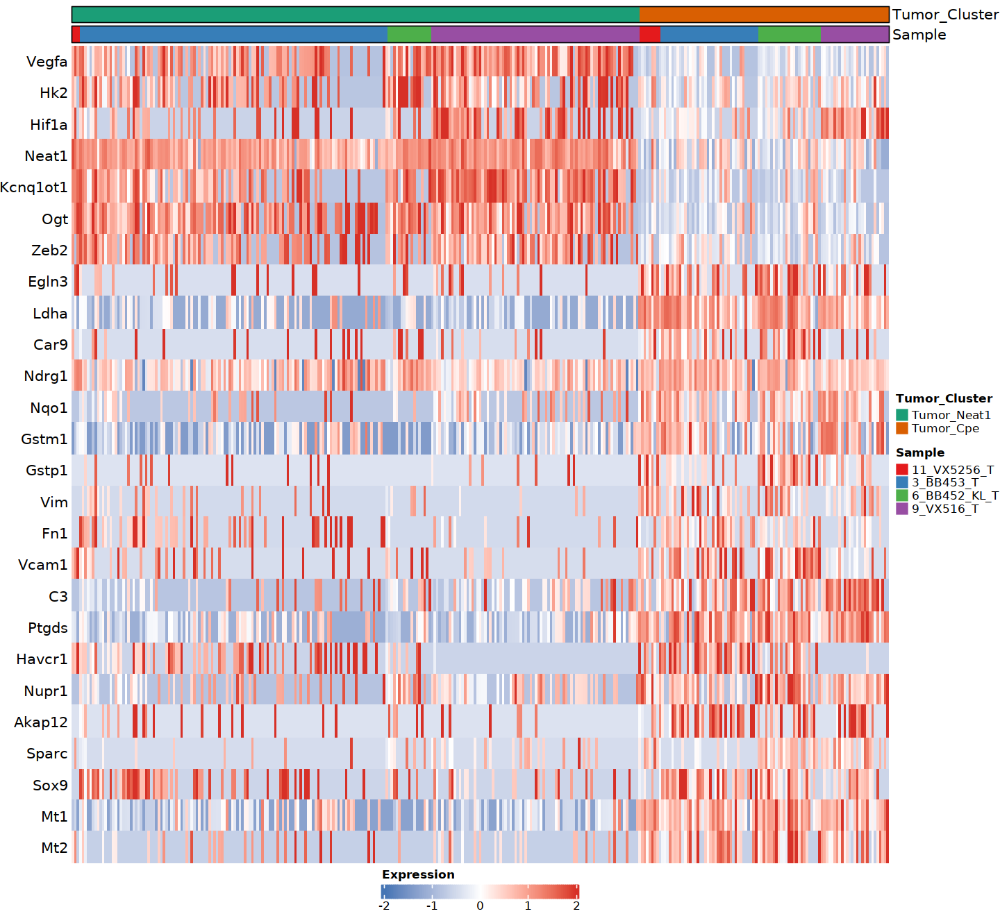

In [140]:
options(repr.plot.width=12, repr.plot.height=11)

markers_tum.downsample %>%
    group_by(cluster) %>%
    top_n(n = 20, wt = avg_log2FC) -> top20

colors <- list(brewer.pal(3, "Dark2"),brewer.pal(4,"Set1"))

plot_heatmap(dataset = subset(seur_ni_t_tum,idents = c("Tumor_Cycling_Mki67","Tumor_Ftl1"),invert = T), 
              markers = c(goi_neat1,goi_cpe_sig$gene),
              sort_var = c("Tumor_Cluster","Sample"),
              anno_var = c("Tumor_Cluster","Sample"),
              anno_colors = colors)


### 14. Reproject and recluster non-immune cells from tumor samples after excluding ambient-high tumor cluster

In [141]:
seur_ni_t = readRDS(file = "Manuscript_Objects/NonImmune_Tumor_SeuratObject.RDS")

In [146]:
seur_ni_t$original_anno = Idents(seur_ni_t)
table(seur_ni_t$original_anno)


           Tumor_Neat1    Tumor_Cycling_Mki67              Tumor_Cpe 
                  5336                    241                   2339 
            Tumor_Ftl1 Endothelial_Tum_Igfbp3         Fibroblast_Dcn 
                  4638                    476                    192 
   Myeloid_Contaminant            Contaminant     ImmuneContam_Tumor 
                    69                    314                    279 

Centering and scaling data matrix

PC_ 1 
Positive:  Tchh, Gm7480, Gm26532, Tsix, Gm26724, Nyx, Slc7a11, Gsdme, Gm42047, Peg3 
	   Slc6a19, Obscn, Gm48855, Slc24a5, 4430402I18Rik, B430010I23Rik, Gm45792, Cd27, Mast3, Col27a1 
	   Snx29, Ms4a8a, Mid1, Snhg12, Plk3, Col7a1, Usp29, Rptn, Trim63, Ankrd23 
Negative:  S100a11, Ndufa4, Selenow, Tmsb10, Lgals1, Nenf, S100a13, Crip1, Uqcc2, Ndufa11 
	   Cox6b1, Ndufb1-ps, Prdx5, Atox1, Uqcr11, Cox5b, Atp5k, Ndufc1, Txn1, Atp5g1 
	   S100a6, Cops9, Cox7a2, Ndufa1, Cox7b, Tomm6, Uqcrq, S100a10, Anxa5, Ndufb4 
PC_ 2 
Positive:  Ly6c1, Fstl1, Ifitm3, Ebf1, Cd34, Nid1, Slc43a3, Bgn, Tshz2, Col3a1 
	   Adamts5, Col1a2, Gpx8, Col14a1, Dcn, Slfn5, Fbn1, Svep1, Emp1, Islr 
	   Col1a1, Lama4, Loxl1, Rhoj, Slit3, Prrx1, Mfap5, Thbd, Dpt, Serpinf1 
Negative:  Fxyd2, Gsta2, Chchd10, Dbi, Gpx3, Cstb, Ldhb, Fam162a, Cryab, Aldob 
	   Cox5a, Ddt, Mgst3, Cisd1, Ftl1, Spink1, S100a1, Gpx1, Rida, Ndufb6 
	   Cycs, Uqcr10, Gc, Mt1, Afp, Gapdh, Lgals3, Ptgds, Gstm1

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 9246
Number of edges: 323356

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9072
Number of communities: 13
Elapsed time: 1 seconds


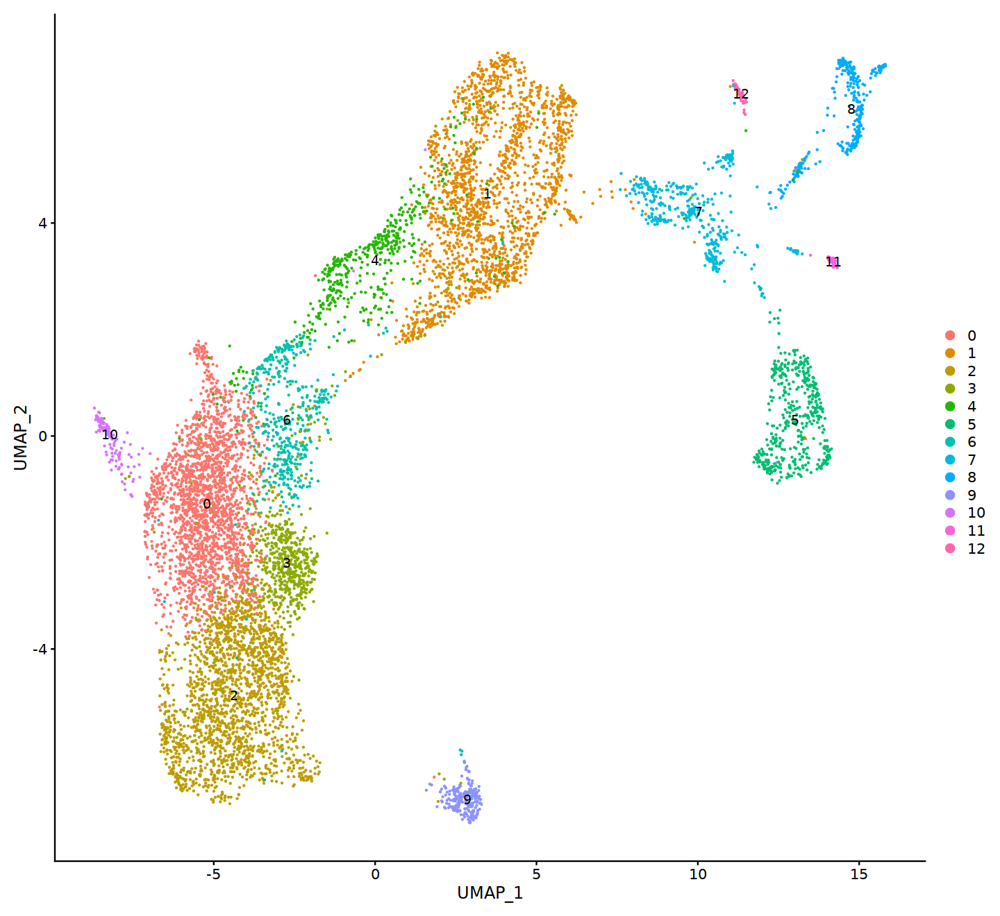

In [147]:
seur_ni_t_ambfilt = subset(seur_ni_t, idents = c("Tumor_Ftl1"), invert = T)
seur_ni_t_ambfilt <- NormalizeData(seur_ni_t_ambfilt)
seur_ni_t_ambfilt <- FindVariableFeatures(seur_ni_t_ambfilt, selection.method = "vst",nfeatures = 3000)
seur_ni_t_ambfilt <- ScaleData(seur_ni_t_ambfilt, features = row.names(seur_ni_t_ambfilt))
seur_ni_t_ambfilt <- RunPCA(seur_ni_t_ambfilt, npcs = 30,verbose = T)
seur_ni_t_ambfilt <- RunHarmony(seur_ni_t_ambfilt, group.by.vars = "Sex")
seur_ni_t_ambfilt <- RunUMAP(seur_ni_t_ambfilt, reduction = "harmony", dims = 1:30)
seur_ni_t_ambfilt <- FindNeighbors(seur_ni_t_ambfilt, reduction = "harmony", dims = 1:30)
seur_ni_t_ambfilt <- FindClusters(seur_ni_t_ambfilt, resolution = 0.3)
DimPlot(seur_ni_t_ambfilt, label = T)

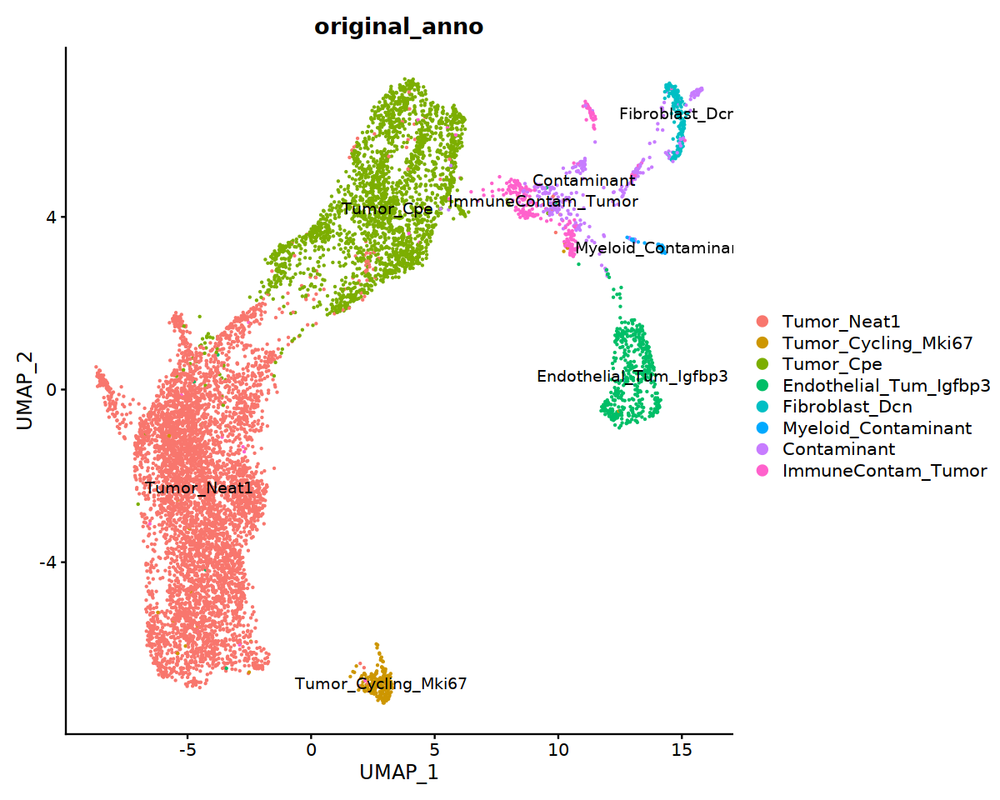

In [148]:
options(repr.plot.width=10, repr.plot.height=8)

DimPlot(seur_ni_t_ambfilt, label = T, group.by = "original_anno")

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 9246
Number of edges: 323356

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9561
Number of communities: 7
Elapsed time: 1 seconds


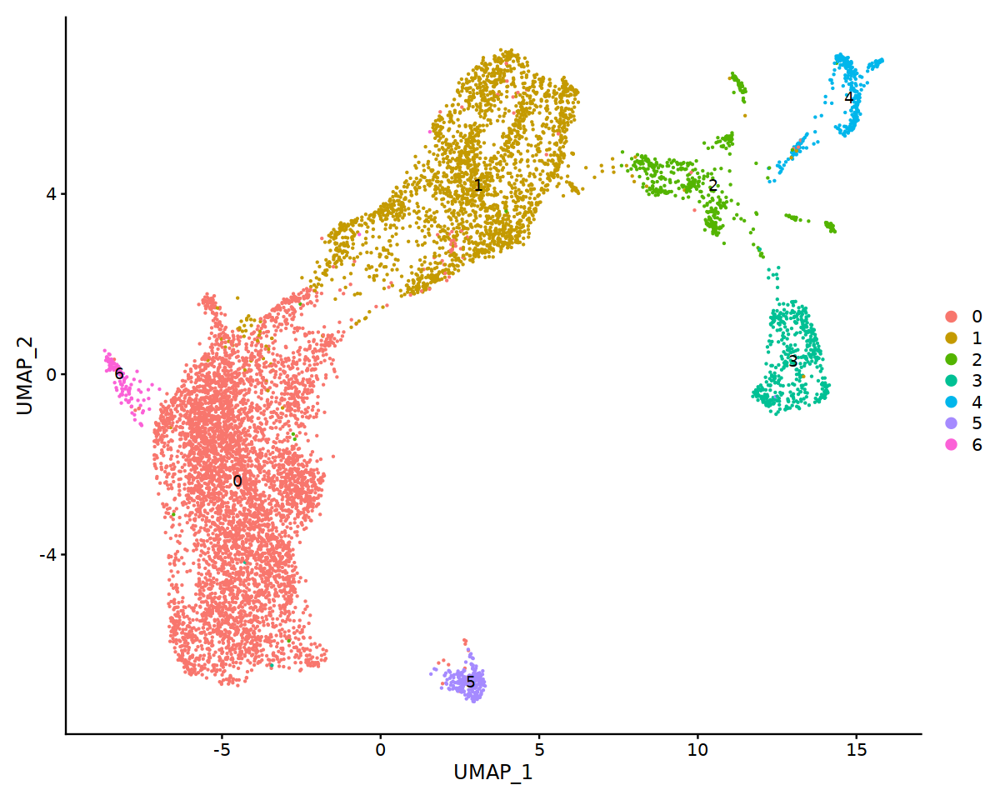

In [149]:
options(repr.plot.width=10, repr.plot.height=8)
seur_ni_t_ambfilt <- FindClusters(seur_ni_t_ambfilt, resolution = 0.1)
DimPlot(seur_ni_t_ambfilt, label = T)

In [150]:
seur_ni_t_ambfilt.downsample <- subset(seur_ni_t_ambfilt, downsample = 1000)

markers.ambfilt <- FindAllMarkers(seur_ni_t_ambfilt.downsample, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted probabilities numerically 0 or 1 occurred"
Warning message:
"glm.fit: fitted prob

In [152]:
saveRDS(markers.ambfilt, file = "Manuscript_Objects/NonImmune_Tumor_AmbFilt_FindAllMarkers_LR_Sex.RDS")

Warning message:
"'add.ident' is a deprecated argument, please use the 'group.by' argument instead"
Centering and scaling data matrix



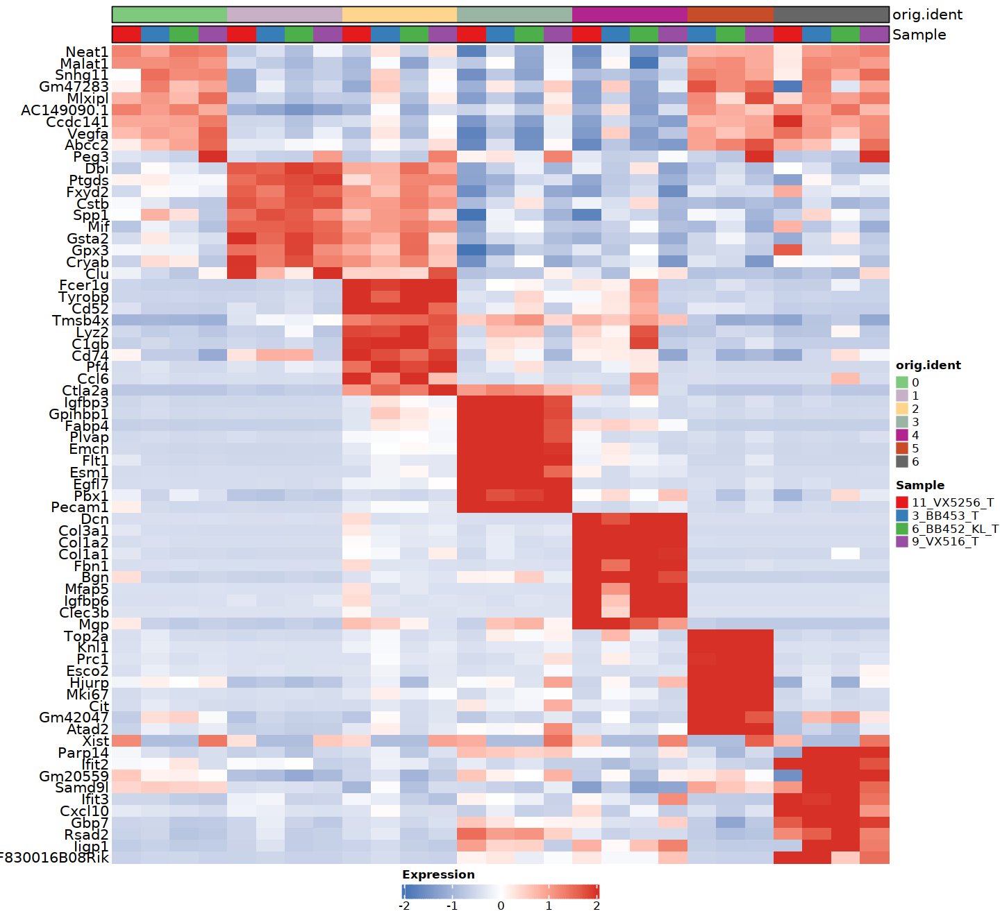

In [154]:
markers.ambfilt %>%
    group_by(cluster) %>%
    top_n(n = 10, wt = avg_log2FC) -> top10

DefaultAssay(seur_ni_t_ambfilt) = "RNA"
cluster.averages <- AverageExpression(seur_ni_t_ambfilt, return.seurat = TRUE, group.by = "seurat_clusters",add.ident = "Sample")
cluster_sample = strsplit(row.names(cluster.averages@meta.data),"_")
sample = lapply(cluster_sample, function(x) x[-1])
cluster.averages$Sample = unlist(lapply(sample, paste,collapse = "_"))
cluster.averages$orig.ident = factor(cluster.averages$orig.ident, levels = c(0:length(unique(cluster.averages$orig.ident))))
                
options(repr.plot.width=12, repr.plot.height=11)

colors <- list(colorRampPalette(brewer.pal(8, "Accent"))(length(unique(cluster.averages$orig.ident))),brewer.pal(4,"Set1"))

DefaultAssay(cluster.averages) = "RNA"
plot_heatmap(dataset = cluster.averages, 
              markers = top10$gene,
              sort_var = c("orig.ident","Sample"),
              anno_var = c("orig.ident","Sample"),
              anno_colors = colors)


In [166]:
#0 Tumor_Neat1
#1 Tumor_Cpe
#2 Immune_Contaminant
#3 Endothelial_Tum_Igfbp3
#4 Fibroblast_Dcn (subset)
#5 Tumor_Cycling_Mki67
#6 Tumor_ISG_High_Ifit3

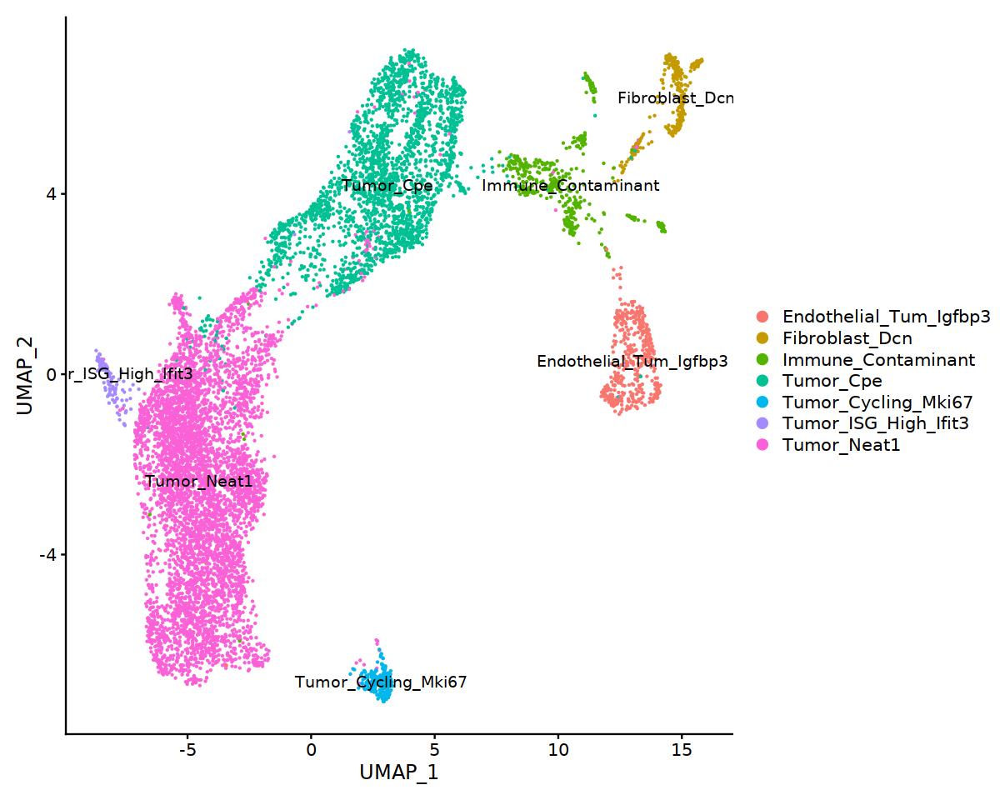

In [182]:
#0 Tumor_Neat1
#1 Tumor_Cpe
#2 Immune_Contaminant
#3 Endothelial_Tum_Igfbp3
#4 Fibroblast_Dcn (subset)
#5 Tumor_Cycling_Mki67
#6 Tumor_ISG_High_Ifit3

Idents(seur_ni_t_ambfilt) = "seurat_clusters"

new.cluster.ids = c("Tumor_Neat1","Tumor_Cpe","Immune_Contaminant","Endothelial_Tum_Igfbp3","Fibroblast_Dcn","Tumor_Cycling_Mki67","Tumor_ISG_High_Ifit3")
names(new.cluster.ids) = levels(seur_ni_t_ambfilt)
seur_ni_t_ambfilt = RenameIdents(seur_ni_t_ambfilt, new.cluster.ids)

Idents(seur_ni_t_ambfilt) = factor(Idents(seur_ni_t_ambfilt), levels = sort(unique(as.character(Idents(seur_ni_t_ambfilt)))) )

options(repr.plot.width=10, repr.plot.height=8)
DimPlot(seur_ni_t_ambfilt, label = T)

### 15. Subset, reproject, and recluster clusters with additional spatial heterogeneity. Then map true identities back to complete object.

Centering and scaling data matrix

PC_ 1 
Positive:  Dpt, Gsn, Gpc3, Scara5, Clec3b, Mfap5, Igfbp6, Plpp3, Ly6c1, Cd34 
	   Pcolce2, Fbln2, Fbn1, Emilin2, Scara3, Klf4, Vim, C3, Chrdl1, Tnxb 
	   Sema3c, Mgll, Ptgis, Add3, Adm, Ildr2, S100a10, Vegfd, Ebf2, Itih5 
Negative:  Itga1, Spp1, Mylk, AY036118, Pdgfrb, Mcam, Notch3, Col18a1, Apoe, Pear1 
	   Myo1b, Sept4, Nr2f2, Cpm, Mertk, Rcsd1, Cx3cl1, Gucy1a2, Cspg4, Col15a1 
	   Sorbs1, B130024G19Rik, Gm26917, Raph1, Emcn, Specc1, Sorbs2, Adap2, Clca3a1, Tbc1d1 
PC_ 2 
Positive:  Lyz2, C1qa, Tyrobp, C1qb, C1qc, Wfdc17, Ccl6, Laptm5, Fcer1g, Cd52 
	   Trem2, Csf1r, Ftl1, Rgs10, Ctss, Mif, Apoe, Cd74, Fcgr2b, Ccl9 
	   Coro1a, Alox5ap, Fcgr3, Cd209f, Folr2, Ms4a6d, Ucp2, Mmp12, Ly86, Lgals3 
Negative:  Cald1, Mgp, Fat1, Thbs1, Cdh11, Pik3r1, Fbln5, Timp3, Pdgfrb, Col4a1 
	   Col8a1, Col4a2, Fhl2, Gask1b, Igfbp7, F2r, Sptbn1, Hsd11b1, Bgn, Lbh 
	   Cfh, Cacna2d1, Ccn2, Fbln7, Clec11a, Nr2f2, Cyp1b1, Smoc2, Epas1, Lpl 
PC_ 3 
Positive:  Kif23,

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 311
Number of edges: 9408

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8425
Number of communities: 3
Elapsed time: 0 seconds


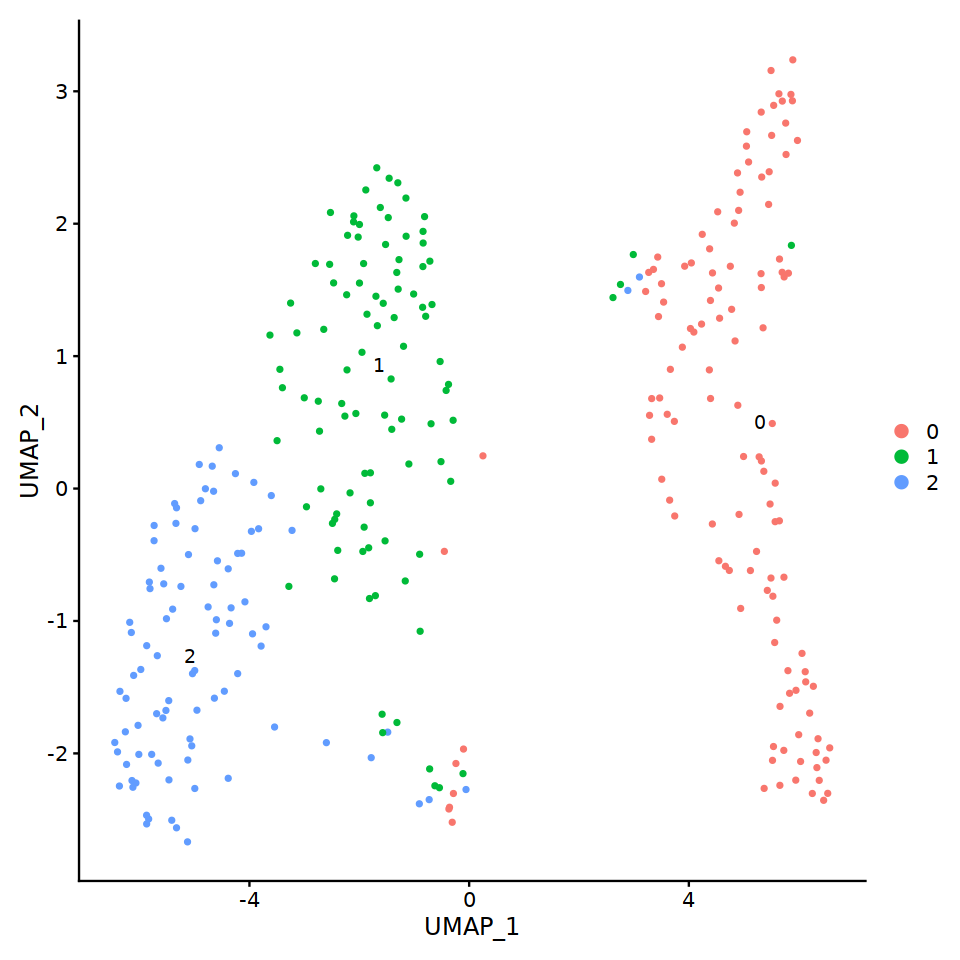

In [183]:
options(repr.plot.width=8, repr.plot.height=8)
seur_fib = subset(seur_ni_t_ambfilt, idents = "Fibroblast_Dcn")
seur_fib <- NormalizeData(seur_fib)
seur_fib <- FindVariableFeatures(seur_fib, selection.method = "vst",nfeatures = 3000)
seur_fib <- ScaleData(seur_fib, features = row.names(seur_fib))
seur_fib <- RunPCA(seur_fib, npcs = 20,verbose = T)
seur_fib <- RunHarmony(seur_fib, group.by.vars = "Sex")
seur_fib <- RunUMAP(seur_fib, reduction = "harmony", dims = 1:20)
seur_fib <- FindNeighbors(seur_fib, reduction = "harmony", dims = 1:20)
seur_fib <- FindClusters(seur_fib, resolution = 0.3)
DimPlot(seur_fib, label = T)

In [184]:
markers_fib <- FindAllMarkers(seur_fib, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25, assay = "RNA",latent.vars = "Sex",test.use = "LR")
markers_fib %>% group_by(cluster) %>% top_n(n = 10, wt = avg_log2FC)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2



p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
7.425351e-39,3.716449,0.877,0.603,1.772506e-34,0,Spp1
9.384233e-30,2.968450,0.877,0.794,2.240110e-25,0,Apoe
1.439096e-20,2.771871,0.484,0.233,3.435266e-16,0,Itga1
5.713574e-16,4.650596,0.352,0.143,1.363887e-11,0,Hbb-bs
3.268215e-15,2.558352,0.541,0.344,7.801557e-11,0,Cryab
2.920550e-12,2.603012,0.377,0.138,6.971644e-08,0,C1qb
1.065340e-11,2.911767,0.361,0.138,2.543073e-07,0,C1qa
1.447336e-11,2.718457,0.426,0.577,3.454935e-07,0,Col18a1
2.460903e-08,2.653788,0.607,0.804,5.874421e-04,0,Neat1


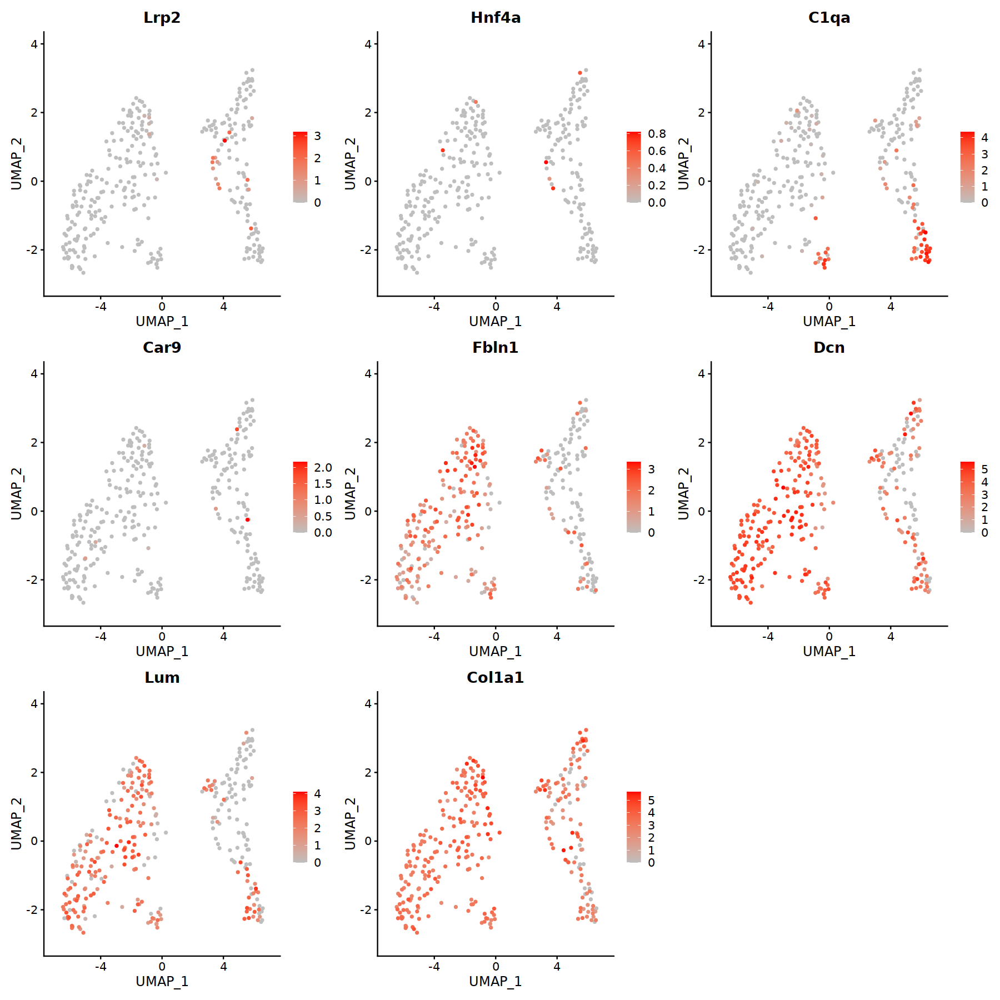

In [185]:
options(repr.plot.width=15, repr.plot.height=15)
FeaturePlot(seur_fib, c("Lrp2","Hnf4a","C1qa","Car9","Fbln1","Dcn","Lum","Col1a1"),order = T,cols = c("grey","red"))


In [186]:
#0 Contaminant
#1 Fibroblast_Dcn
#2 Fibroblast_Dcn

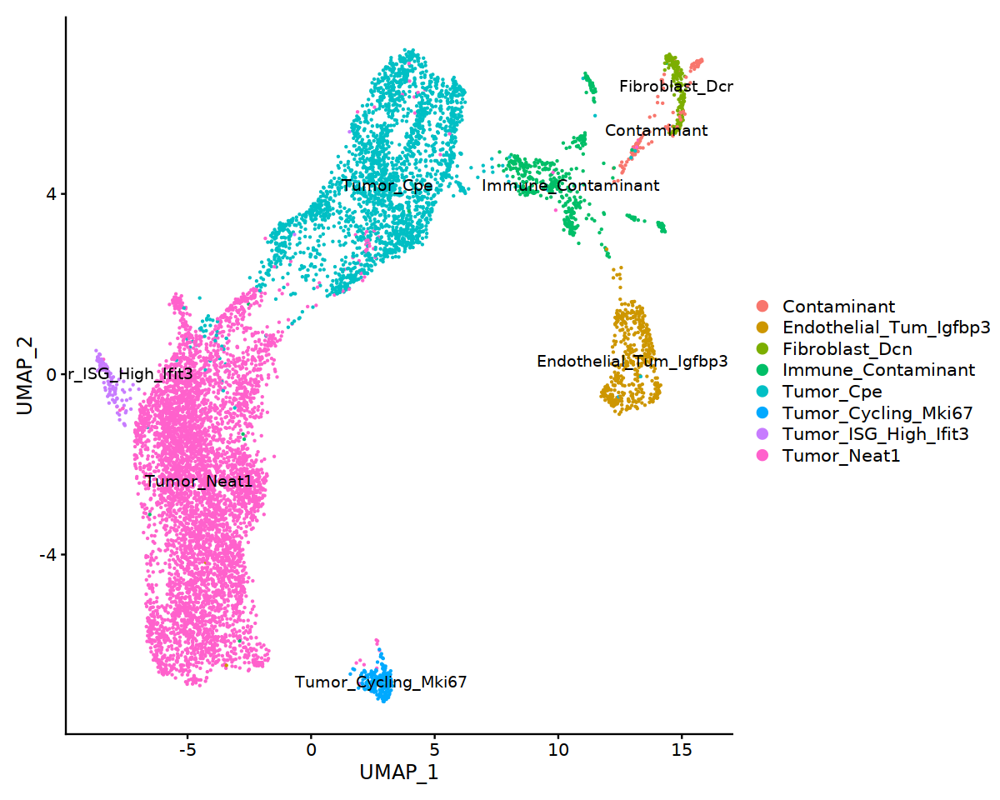

In [187]:
#0 Contaminant
#1 Fibroblast_Dcn
#2 Fibroblast_Dcn

seur_ni_t_ambfilt = SetIdent(seur_ni_t_ambfilt, cells = row.names(subset(seur_fib@meta.data, seurat_clusters == 0)),value = "Contaminant")
seur_ni_t_ambfilt = SetIdent(seur_ni_t_ambfilt, cells = row.names(subset(seur_fib@meta.data, seurat_clusters == 1)),value = "Fibroblast_Dcn")
seur_ni_t_ambfilt = SetIdent(seur_ni_t_ambfilt, cells = row.names(subset(seur_fib@meta.data, seurat_clusters == 2)),value = "Fibroblast_Dcn")

Idents(seur_ni_t_ambfilt) = factor(Idents(seur_ni_t_ambfilt), levels = sort(unique(as.character(Idents(seur_ni_t_ambfilt)))) )

options(repr.plot.width=10, repr.plot.height=8)
DimPlot(seur_ni_t_ambfilt, label = T)

In [188]:
ordered = c("Tumor_Neat1","Tumor_Cycling_Mki67","Tumor_ISG_High_Ifit3","Tumor_Cpe","Endothelial_Tum_Igfbp3","Fibroblast_Dcn","Immune_Contaminant","Contaminant")
Idents(seur_ni_t_ambfilt) = factor(Idents(seur_ni_t_ambfilt), levels = ordered)

In [189]:
seur_ni_t_ambfilt$Annot_Granular = Idents(seur_ni_t_ambfilt)

In [194]:
mycols = c('#E7298A','#D95F02','#7570B3','#1B9E77','#66A61E','#E6AB02','lightgrey','lightgrey')
names(mycols) = names(table(Idents(seur_ni_t_ambfilt)))
mycols

Tumor_Neat1    Tumor_Cycling_Mki67   Tumor_ISG_High_Ifit3 
             "#E7298A"              "#D95F02"              "#7570B3" 
             Tumor_Cpe Endothelial_Tum_Igfbp3         Fibroblast_Dcn 
             "#1B9E77"              "#66A61E"              "#E6AB02" 
    Immune_Contaminant            Contaminant 
           "lightgrey"            "lightgrey"

In [204]:
saveRDS(mycols , file = "Manuscript_Objects/Tumor_NonImmune_Colors.RDS")

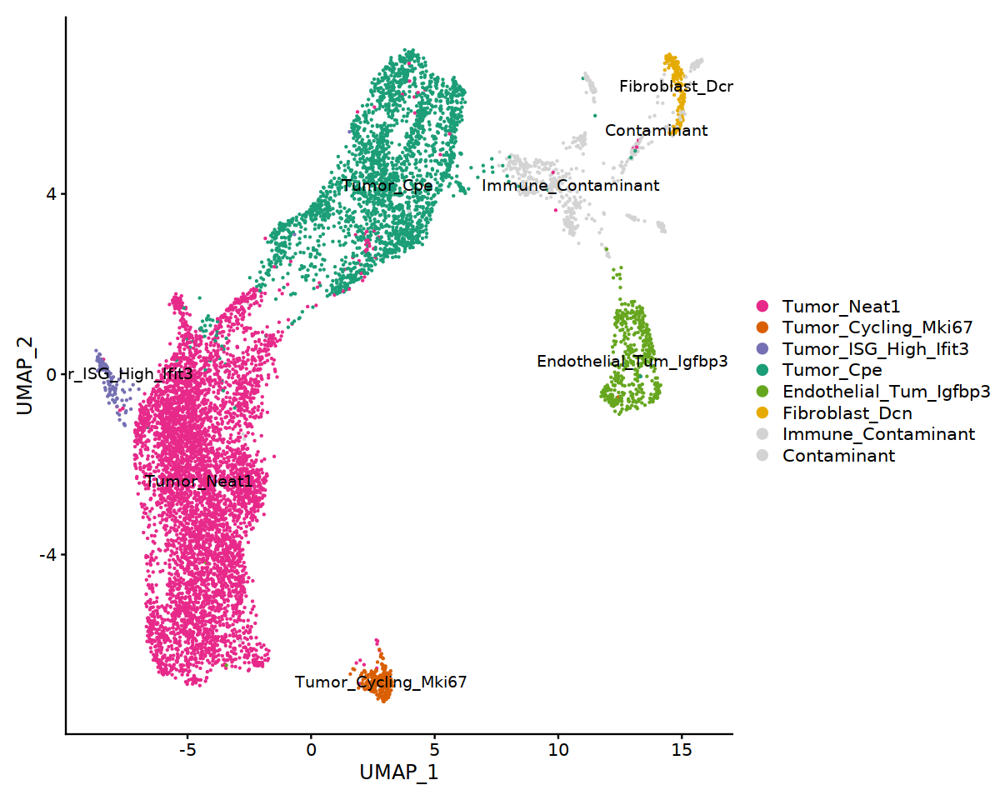

In [196]:
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(seur_ni_t_ambfilt, label = T,cols = mycols)

ggsave("Manuscript_Figures/Tumor_NonImmune_AmbFilt_UMAP_CellType.pdf", width = 10, height = 8)


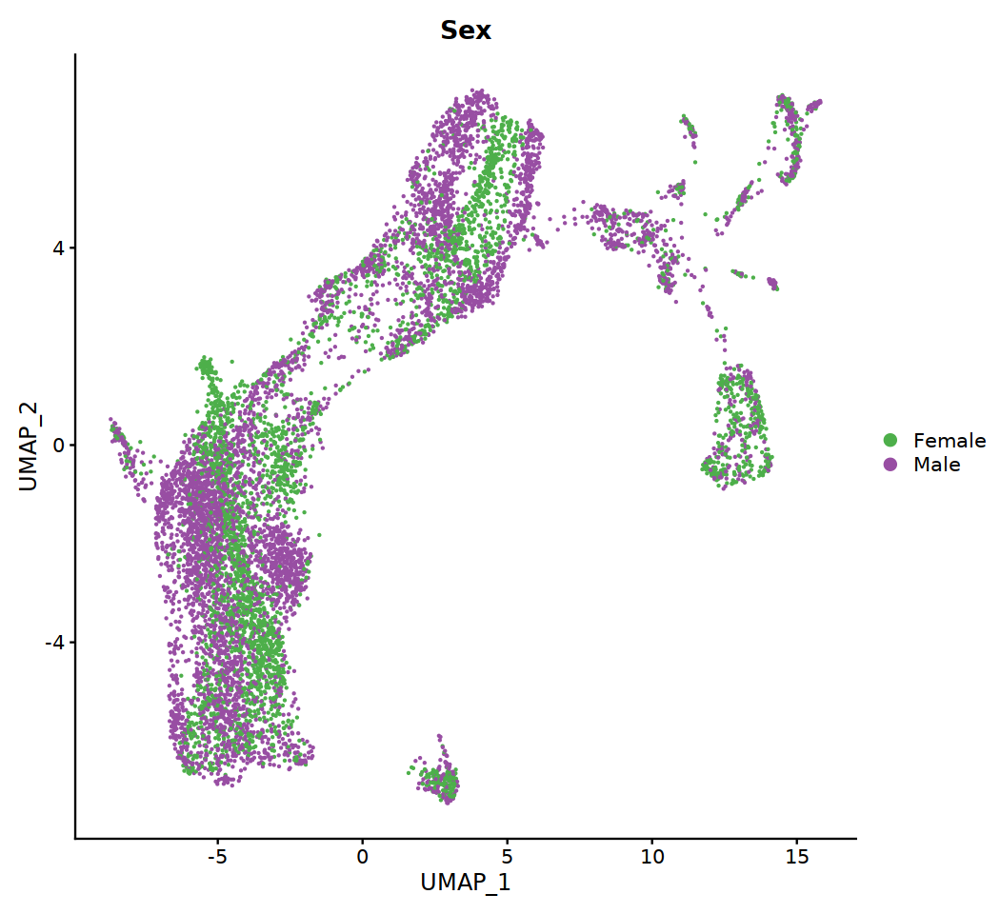

In [198]:
options(repr.plot.width=8.75, repr.plot.height=8)
DimPlot(seur_ni_t_ambfilt, group.by = "Sex", cols = c("#4daf4a","#984ea3"),shuffle = T)

ggsave("Manuscript_Figures/Tumor_NonImmune_AmbFilt_UMAP_Sex.pdf", width = 8.75, height = 8)

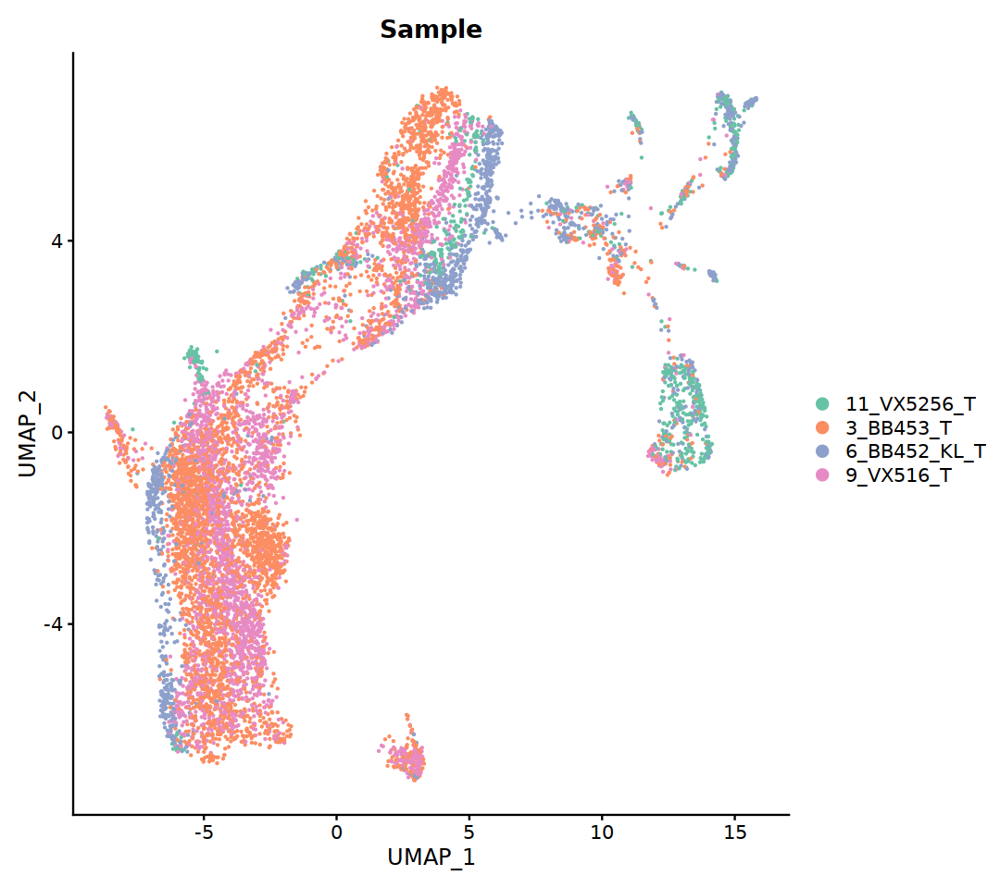

In [199]:
options(repr.plot.width=9, repr.plot.height=8)
DimPlot(seur_ni_t_ambfilt, group.by = "Sample", cols = brewer.pal(4, "Set2"),shuffle = T)

ggsave("Manuscript_Figures/Tumor_NonImmune_AmbFilt_UMAP_Sample.pdf", width = 9, height = 8)

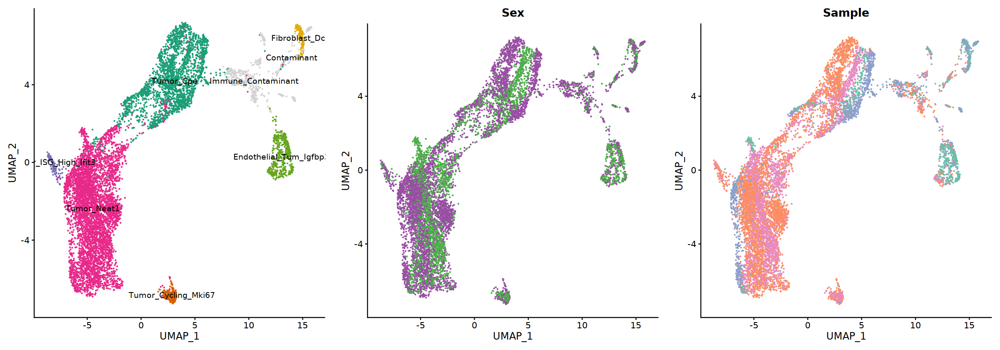

In [200]:
one = DimPlot(seur_ni_t_ambfilt, label = T, cols = mycols) + NoLegend()
two = DimPlot(seur_ni_t_ambfilt, group.by = "Sex", cols = c("#4daf4a","#984ea3"),shuffle = T) + NoLegend()
three = DimPlot(seur_ni_t_ambfilt, group.by = "Sample", cols = brewer.pal(4, "Set2"),shuffle = T) + NoLegend()

library(ggpubr)
options(repr.plot.width=20, repr.plot.height=7)
ggarrange(one, two,three, nrow = 1)

ggsave("Manuscript_Figures/Tumor_NonImmune_AmbFilt_Combined_CellType_Sex_Sample.pdf", width = 20, height = 7)

,Var1,Var2,Freq
,<fct>,<fct>,<dbl>
1,11_VX5256_T,Tumor_Neat1,0.01440092
2,3_BB453_T,Tumor_Neat1,0.53821045
3,6_BB452_KL_T,Tumor_Neat1,0.07968510
4,9_VX516_T,Tumor_Neat1,0.36770353
5,11_VX5256_T,Tumor_Cycling_Mki67,0.00000000


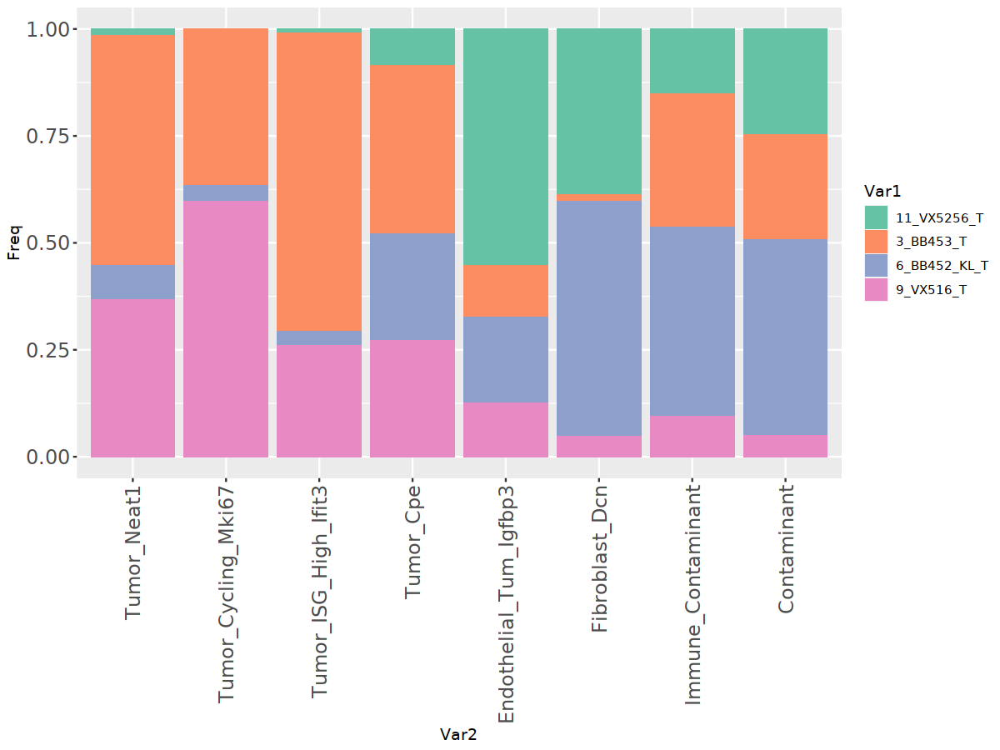

In [202]:
options(repr.plot.width=10, repr.plot.height=7.5)
props <- prop.table(table(seur_ni_t_ambfilt$Sample,Idents(seur_ni_t_ambfilt)), margin = 2)
props <- data.frame(props)
corner(props)
ggplot() + geom_bar(aes(y = Freq, x = Var2, fill = Var1), data = props, stat="identity") +theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1,size=14),
          axis.text.y = element_text(size=14)) + scale_fill_manual(values = brewer.pal(4, "Set2")) 

In [203]:
saveRDS(seur_ni_t_ambfilt, file = "Manuscript_Objects/NonImmune_Tumor_AmbFilt_SeuratObject.RDS")


### With non-immune cells from normal kidney and tumor samples annotated and filtered for low quality/ambient-high clusters, we can move on to the cell of origin analysis